## M2 [DishWasher]: REFIT House 6 to REFIT House 6

###  Experiment #0013

Low F1 Score and noise output.

In [1]:
import os
import numpy as np
import math

import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader, Dataset
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch

import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler as standarize_data
from sklearn.preprocessing import MinMaxScaler as scale_data
from sklearn.utils import shuffle

plt.style.use('bmh')


### parameters and configuration

In [2]:
sig_len=400
lr=0.0002 #0.00002
b1=0.5
b2=0.999
n_epochs=500
batch_size=128
s=2
sample_interval=500

cuda = True if torch.cuda.is_available() else False

FloatTensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor
LongTensor = torch.cuda.LongTensor if cuda else torch.LongTensor




## loading, downsampling and scaling data

In [3]:
X_train=np.load("data/REFIT_house6_X_train_segments_DW0.npy")
Y_train=np.load("data/REFIT_house6_Y_train_segments_DW0.npy")
 
X_train[X_train<=50] = 0
Y_train[Y_train<=50] = 0

# # X_train,Y_train=down_sample(X_train,Y_train,s)
scale_agg=scale_data()
scale_app=scale_data()

scale_agg.fit(X_train)
scale_app.fit(Y_train)
X_train_n=scale_agg.transform(X_train)
Y_train_n=scale_app.transform(Y_train)


/usr/local/lib/python3.5/dist-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/usr/local/lib/python3.5/dist-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)


In [4]:
# for i in range(50):
#     plt.plot(X_train_n[i,:])
#     plt.plot(Y_train_n[i,:])
#     plt.show()
# X_train.shape

## GANNILM Classes

In [4]:
class Swish(torch.nn.Module):
    def forward(self,x):
        return x * torch.sigmoid(x)


class Flatten(torch.nn.Module):
    def forward(self, x):
        batch_size = x.shape[0]
        return x.view(batch_size, -1)

    
class Projection(torch.nn.Module):
    def forward(self, x):
        batch_size = x.shape[0]
        return x.view(batch_size,projection,-1) #bsize, projection,length

class Generator(nn.Module):
    def __init__(self):
        super().__init__()

 
        def block(in_feat, out_feat, normalize=False):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.9))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers
        
        def conv(in_feat, out_feat, filter_size=5, stride=1,padding=True):
            if padding==True: 
                p=int((filter_size-1)/2)
            else:
                p=0
            conv_layers = [nn.Conv1d(in_feat, out_feat,filter_size,stride,padding=p)]
            conv_layers.append(nn.LeakyReLU(0.2, inplace=True))
            return conv_layers

        def flat():
            flatten=Flatten()
            layers = [flatten]
            return layers
        
        def swish():
            s=Swish()
            layers = [s]
            return layers
        
        def project():
            project_layer=Projection()
            layers = [project_layer]
            return layers
        
        
        h=8 # hidden layer neurons multiple of signal length
        f=2 #output featrue maps
        
        self.g1 = nn.Sequential(
            *conv(in_feat=1,out_feat=f*2,filter_size=5,stride=1,padding=True),
            

        )
        
        self.g2 = nn.Sequential(
            *conv(in_feat=f*2,out_feat=f*3,filter_size=5,stride=1,padding=True),
            *flat(),
        )
        
        self.g3 = nn.Sequential(
            *block(sig_len*f*3, int(sig_len*f*4), normalize=False),

        )
        
        
        self.g4 = nn.Sequential(
            *block(int(sig_len*f*4), int(sig_len*f*6)),

        )
        
        
        
        
        self.g5 = nn.Sequential(
            
            *block(int(sig_len*f*6), int(sig_len*f*4)),

        )
        
         
        self.g6 = nn.Sequential(
            
            *block(int(sig_len*f*4), int(sig_len*f*3)),

        )
        
        self.g7 = nn.Sequential(
            
            nn.Linear(int(sig_len*f*3), int(np.prod(sig_len))),
            nn.LeakyReLU(0.01, inplace=True) #tanh
        )

    def forward(self,aggregate):
        X = self.g1(aggregate)
        X = self.g2(X)
        X = self.g3(X)
        X = self.g4(X)
        X = self.g5(X)
        X = self.g6(X)
        appliance = self.g7(X)
        return appliance

In [5]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()


        d=4
        
        def conv(in_feat, out_feat, filter_size=5, stride=1,padding=True):
            if padding==True: 
                p=int((filter_size-1)/2)
            else:
                p=0
            conv_layers = [nn.Conv1d(in_feat, out_feat,filter_size,stride,padding=p)]
            conv_layers.append(nn.LeakyReLU(0.2, inplace=True))
            return conv_layers
        
        def flat():
            flatten=Flatten()
            layers = [flatten]
            return layers
        
        f=2
        self.d1 = nn.Sequential(
            nn.Linear(int(sig_len*2), sig_len*d),
            nn.LeakyReLU(0.2, inplace=True),
            
            
        )
        
        self.d2 = nn.Sequential(
            nn.Linear(sig_len*d, sig_len*d),
            nn.LeakyReLU(0.2, inplace=True),
 
            
        )
        
        self.d3 = nn.Sequential(
            
            nn.Linear(sig_len*d, sig_len*d),
            nn.LeakyReLU(0.2, inplace=True),
            
            
        )
        
        self.d4 = nn.Sequential(

            nn.Linear(sig_len*d, sig_len*2),
            nn.LeakyReLU(0.2, inplace=True),
            
        )
        
        
        self.d5 = nn.Sequential(
            
            nn.Linear(sig_len*2, 1),
            nn.Sigmoid(),

        )
        
        

    def forward(self, d_input):
        X=self.d1(d_input)
        X=self.d2(X)
        X=self.d3(X)
        features=self.d4(X)
        validity = self.d5(features)
        
#         validity = self.model(d_in)
        return validity,features


In [6]:
class data_f(Dataset):
    def __init__(self):
    
        self.len=X_train_n.shape[0]
        self.xdata=torch.from_numpy(X_train_n)
        self.ydata=torch.from_numpy(Y_train_n)
        
    def __getitem__(self,index):
        return (self.xdata[index],self.ydata[index])
    
    def __len__(self):
        return(self.len)


## Loss Definition and instantiation

In [7]:
feature_loss=torch.nn.MSELoss()
# adversarial_loss = torch.nn.MSELoss()
adversarial_loss = torch.nn.BCELoss()

# Initialize generator and discriminator
generator = Generator()
discriminator = Discriminator()

if cuda:
    generator.cuda()
    discriminator.cuda()
    adversarial_loss.cuda()



## Loading Model

In [9]:
# PATH="gannilm_refit.pth"
# # PATH="gannilm_UKDALE.pth"
# checkpoint = torch.load(PATH)
# # generator.load_state_dict(checkpoint['g_state_dict'],strict=True)
# # discriminator.load_state_dict(checkpoint['d_state_dict'],strict=True)

## Utility Functions

In [8]:

def smooth(y, box_pts=10):
    box = np.ones(box_pts)/box_pts
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth


def down_sample(X,Y,s):
    Y=Y.reshape(Y.shape[0],Y.shape[1])
    Y_s=Y[:, ::s]
    X_s=X[:,::s]
    dim=X_s.shape[1]
    return(X_s,Y_s.reshape(-1,dim))


def sample_data(n_row, batches_done):
    """Saves a grid of generated digits ranging from 0 to n_classes"""
    # Sample noise
    
    a_to_s=X_train_n[0:10,:] # z
    agg_to_sample=a_to_s.reshape(a_to_s.shape[0],1,a_to_s.shape[1])
    
    true_app=Y_train_n[0:10,:]

    agg_to_sample = Variable(FloatTensor(agg_to_sample))
    gen_ds = generator(agg_to_sample)
    
    
    gen_ds_inv=scale_app.inverse_transform(gen_ds.cpu().detach())
    true_app_inv=scale_app.inverse_transform(true_app)

    plt.plot(smooth(gen_ds_inv[1,:]),label="GAN")
    plt.plot(true_app_inv[1,:],label="Real")
    plt.legend()
    plt.show()

    plt.plot(smooth(gen_ds_inv[7,:]),label="GAN")
    plt.plot(true_app_inv[7,:],label="real")
    plt.legend()
    plt.show()


    
    

def disaggregate(x):
    """Saves a grid of generated digits ranging from 0 to n_classes"""
    x = Variable(FloatTensor(x))
    gen_appliance = generator(x)
    return (gen_appliance)

def confidence(appliance,aggregate):
    agg=Variable(FloatTensor(aggregate))
    d_in=torch.cat((appliance,agg),1)
    conf,_=discriminator(d_in)
    return(conf)


   
def classification_metrics(pred1, real_measurements1,thresh):
#    real_measurements
#    pred=predictions
    
    pred=np.copy(pred1)
    real_measurements=np.copy(real_measurements1)
    on_threshold=thresh
    pred[pred <=on_threshold] = 0
    pred[pred >on_threshold] = 1
     
    real_measurements[real_measurements <=on_threshold] = 0
    real_measurements[real_measurements >on_threshold] = 1


    #print("calculating metrics...TP")
    TP=np.sum(np.logical_and(pred == 1, real_measurements == 1))
#     print("TP=",TP)
    #print("calculating metrics...FP")
    FP=np.sum(np.logical_and(pred == 1, real_measurements == 0))
#     print("FP=",FP)

    #print("calculating metrics...FN")
    FN=np.sum(np.logical_and(pred == 0, real_measurements == 1))
    #print("calculating metrics...TN")
    TN=np.sum(np.logical_and(pred == 0, real_measurements == 0))
    P=sum(real_measurements)
    N=len(real_measurements)-sum(real_measurements)
    
    recall=TP/(TP+FN)
    precision=TP/(TP+FP)
    F1=2*(precision*recall)/(precision+recall)
    accuracy=(TP+TN)/(P+N)
    
    return(recall,precision,F1,accuracy)
    
    
    

def energy_metrics(pred1, real_measurements1,thresh):
    
    
    pred=np.copy(pred1)
    real_measurements=np.copy(real_measurements1)
    on_threshold=thresh
    pred[pred <=on_threshold] = 0
    real_measurements[real_measurements <=on_threshold] = 0

    #pred[pred >on_threshold] = 1
    
    E=np.sum(real_measurements)
    E_hat=np.sum(pred)
    RE=(E_hat-E)/(max(E,E_hat))
#     RE=(E_hat-E)/(E)
    T=len(pred)
    MAE=(1/T)*sum(np.abs(pred-real_measurements))
    return(RE,MAE)






## TL configuring

Batch_no: 0  Epoch: 0


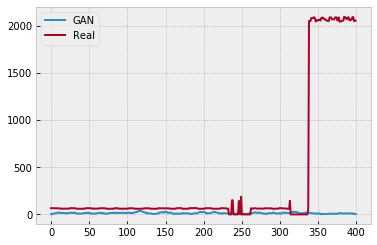

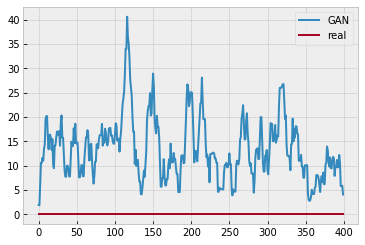

Batch_no: 500  Epoch: 22


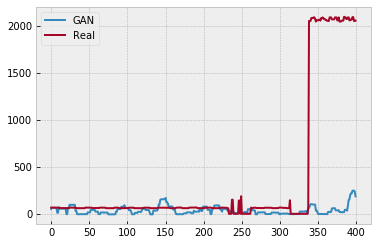

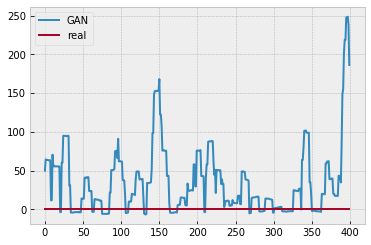

Batch_no: 1000  Epoch: 45


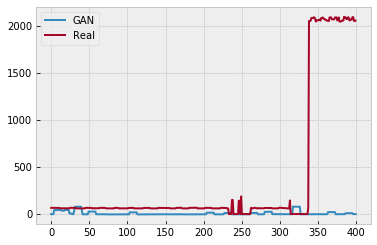

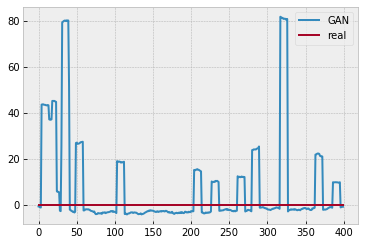

Batch_no: 1500  Epoch: 68


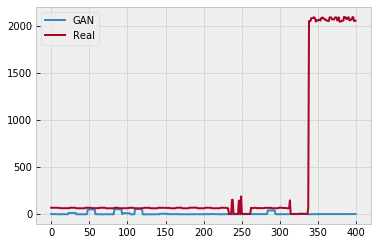

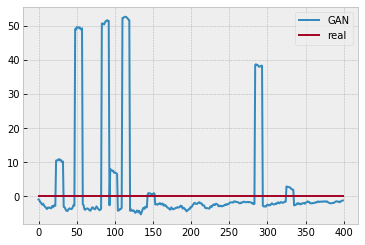

Batch_no: 2000  Epoch: 90


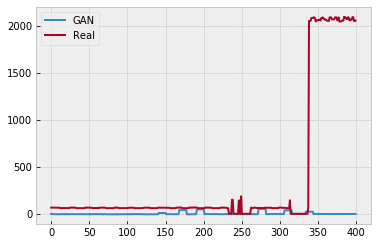

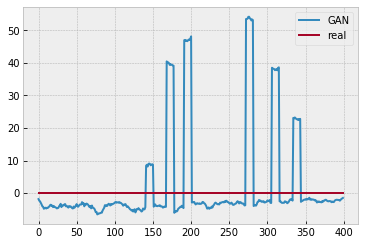

Batch_no: 2500  Epoch: 113


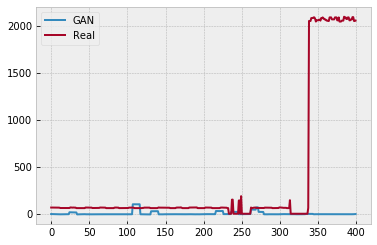

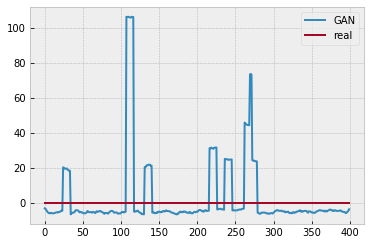

Batch_no: 3000  Epoch: 136


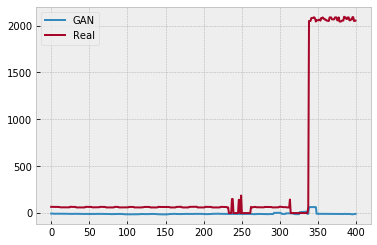

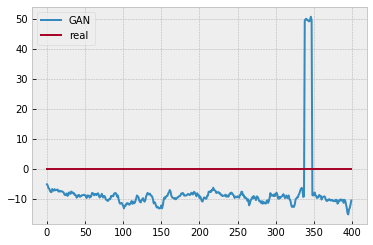

Batch_no: 3500  Epoch: 159


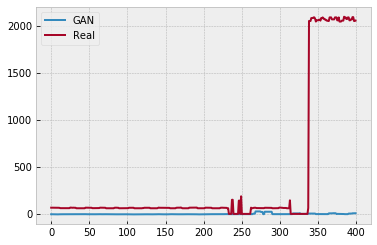

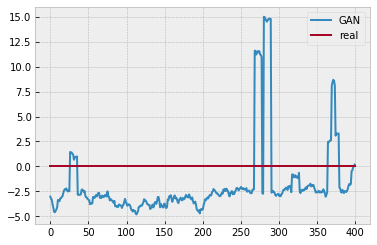

Batch_no: 4000  Epoch: 181


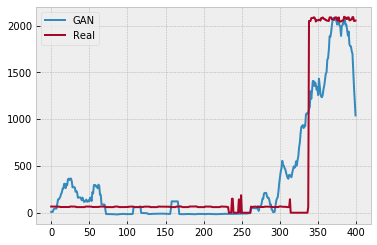

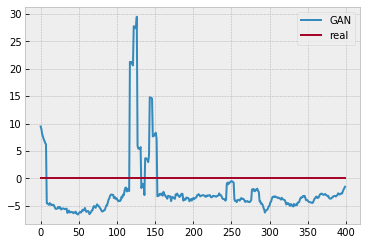

Batch_no: 4500  Epoch: 204


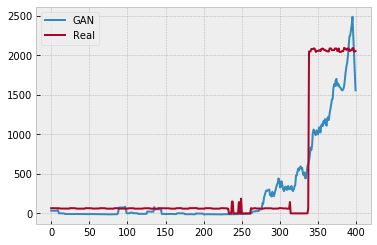

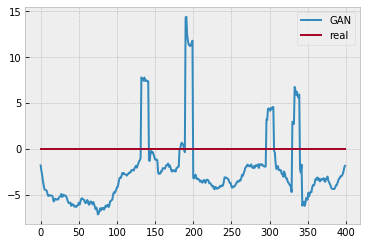

Batch_no: 5000  Epoch: 227


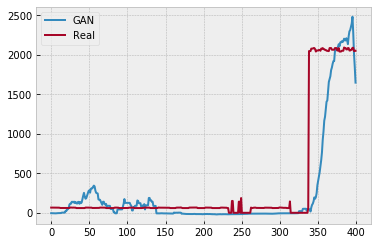

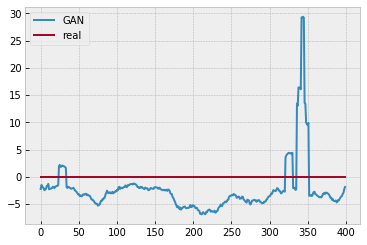

Batch_no: 5500  Epoch: 250


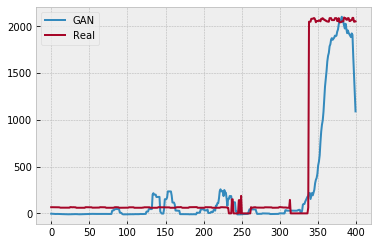

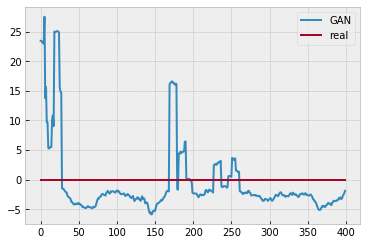

Batch_no: 6000  Epoch: 272


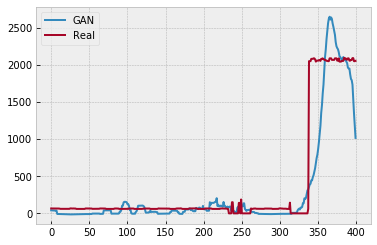

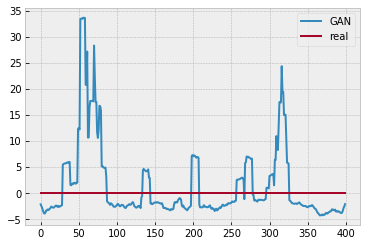

Batch_no: 6500  Epoch: 295


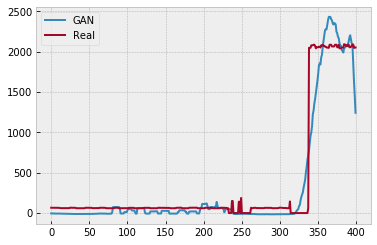

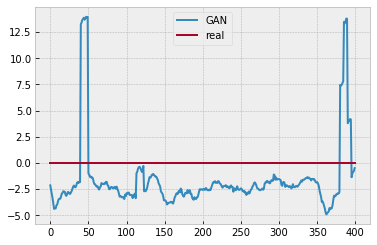

Batch_no: 7000  Epoch: 318


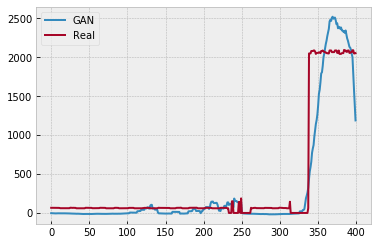

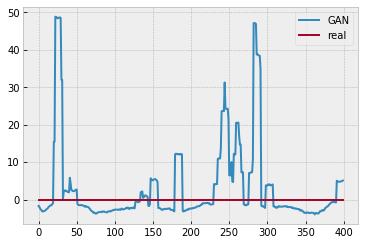

Batch_no: 7500  Epoch: 340


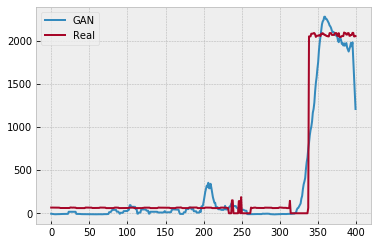

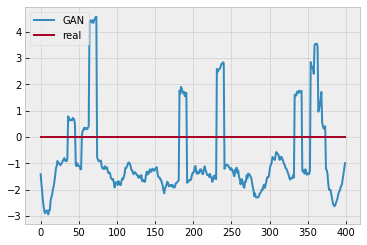

Batch_no: 8000  Epoch: 363


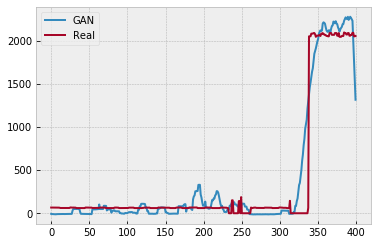

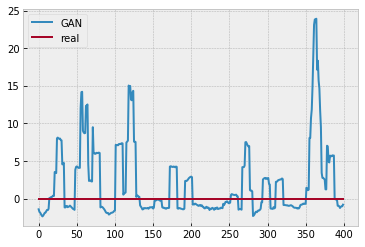

Batch_no: 8500  Epoch: 386


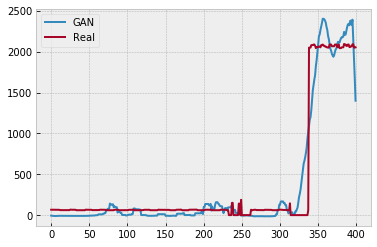

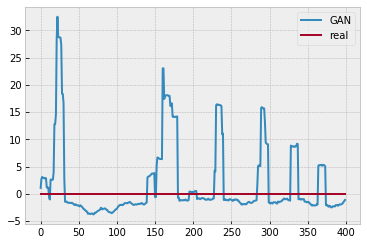

Batch_no: 9000  Epoch: 409


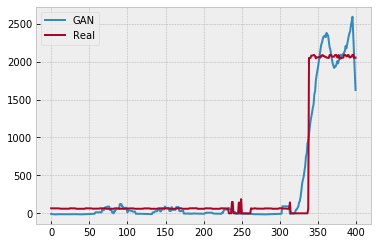

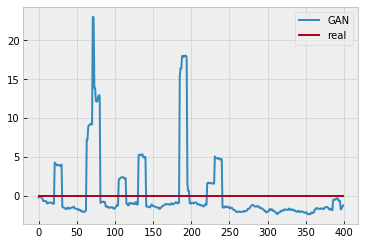

Batch_no: 9500  Epoch: 431


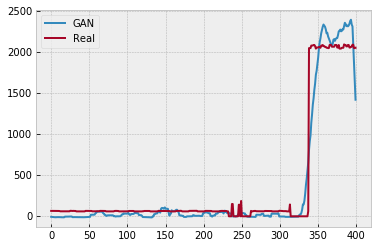

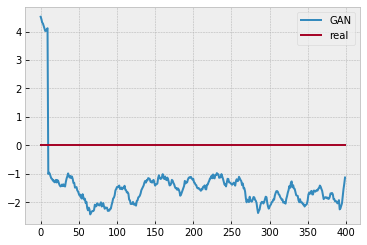

Batch_no: 10000  Epoch: 454


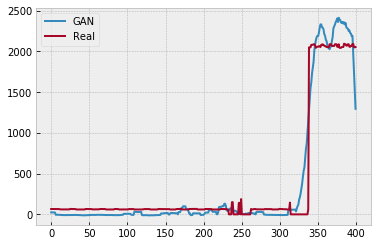

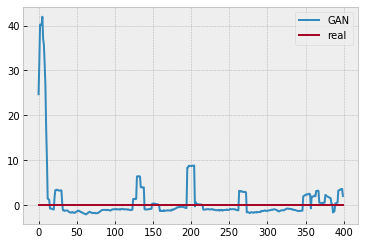

Batch_no: 10500  Epoch: 477


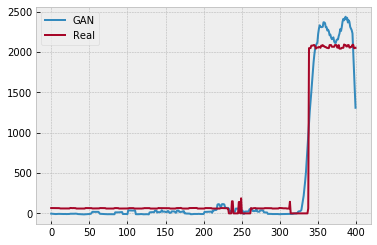

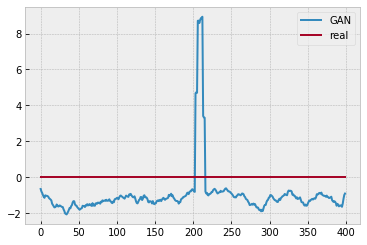

Batch_no: 11000  Epoch: 500


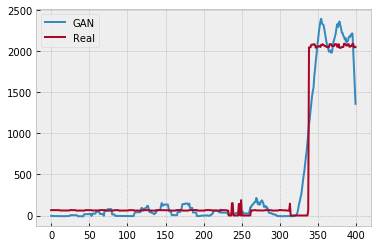

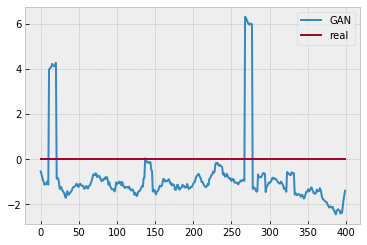

Batch_no: 11500  Epoch: 522


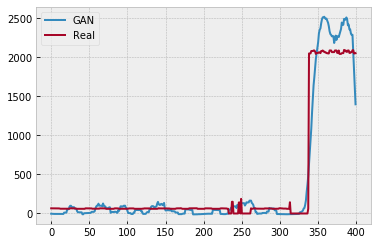

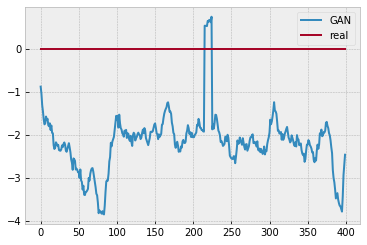

Batch_no: 12000  Epoch: 545


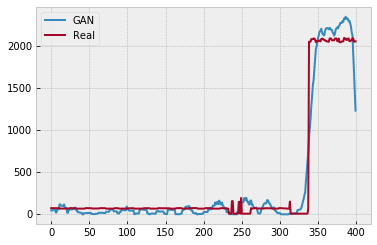

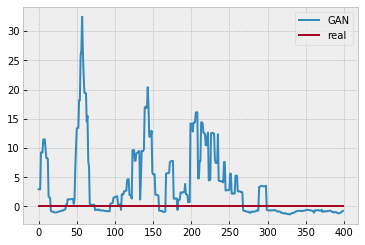

Batch_no: 12500  Epoch: 568


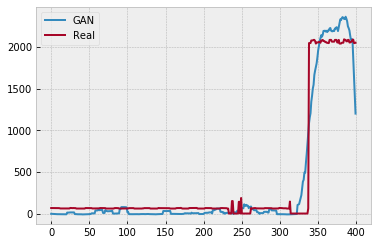

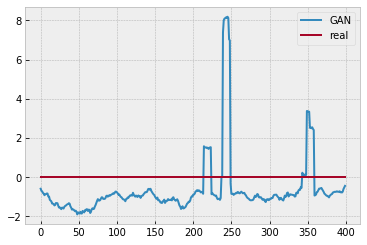

Batch_no: 13000  Epoch: 590


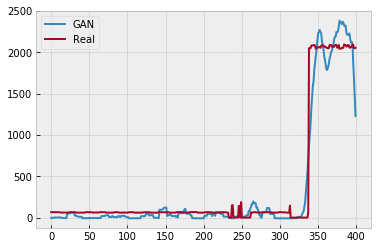

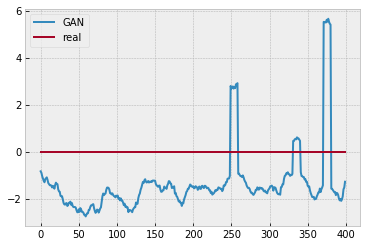

Batch_no: 13500  Epoch: 613


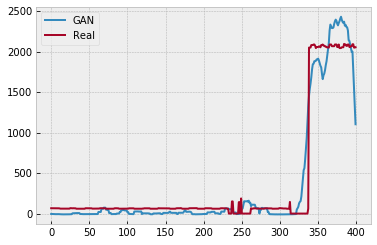

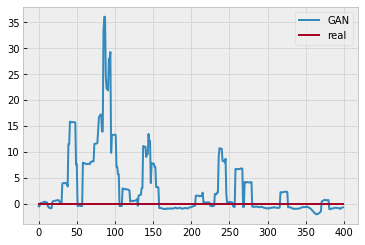

Batch_no: 14000  Epoch: 636


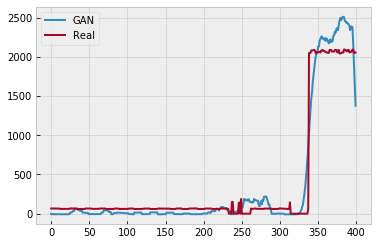

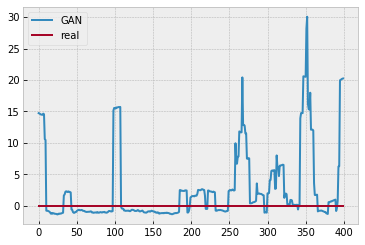

Batch_no: 14500  Epoch: 659


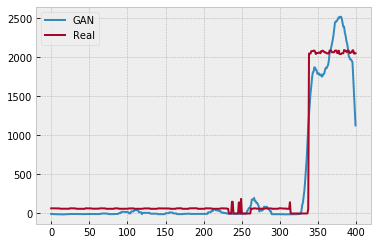

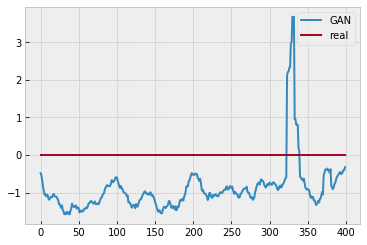

Batch_no: 15000  Epoch: 681


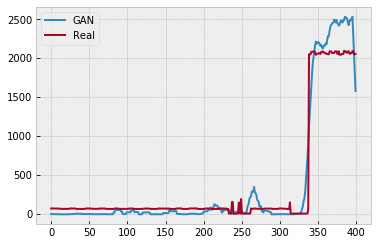

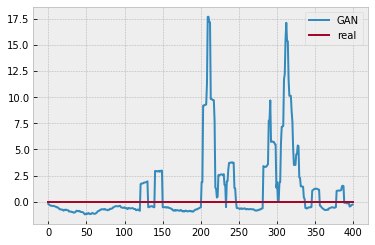

Batch_no: 15500  Epoch: 704


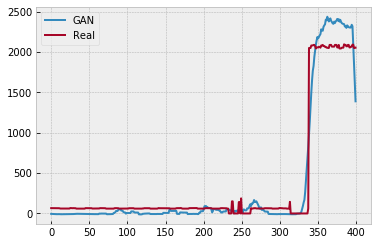

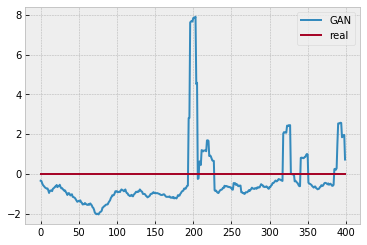

Batch_no: 16000  Epoch: 727


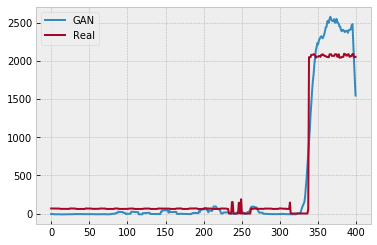

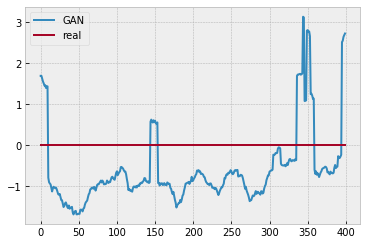

Batch_no: 16500  Epoch: 750


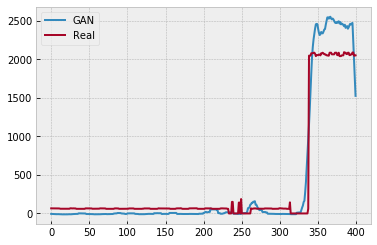

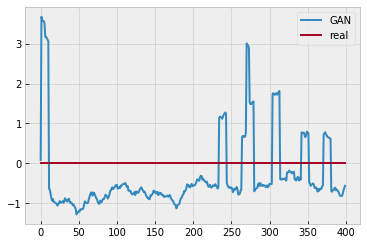

Batch_no: 17000  Epoch: 772


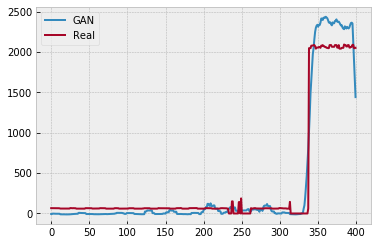

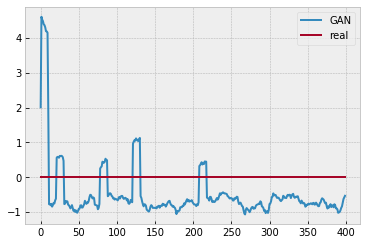

Batch_no: 17500  Epoch: 795


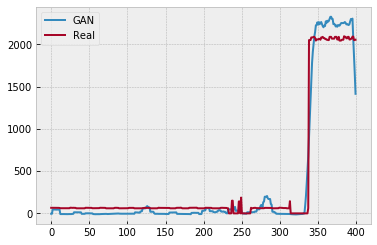

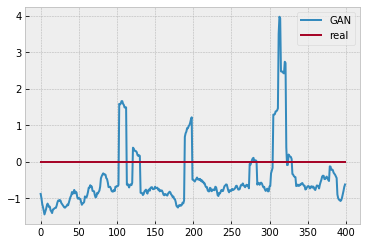

Batch_no: 18000  Epoch: 818


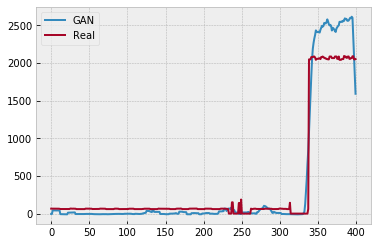

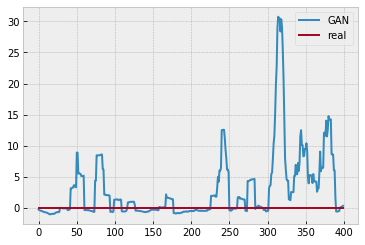

Batch_no: 18500  Epoch: 840


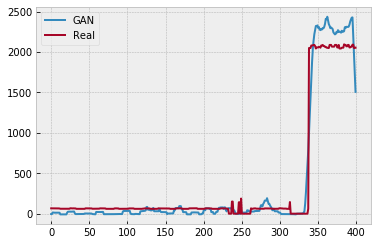

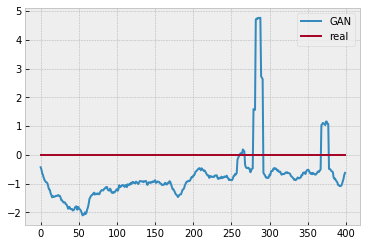

Batch_no: 19000  Epoch: 863


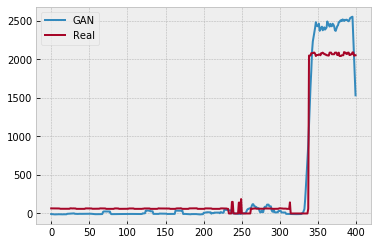

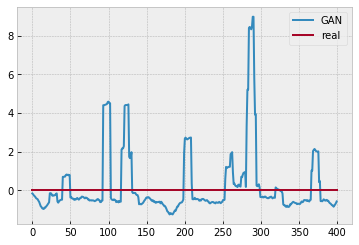

Batch_no: 19500  Epoch: 886


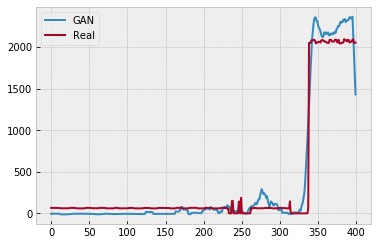

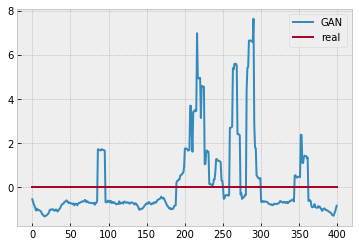

Batch_no: 20000  Epoch: 909


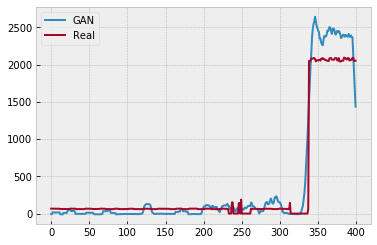

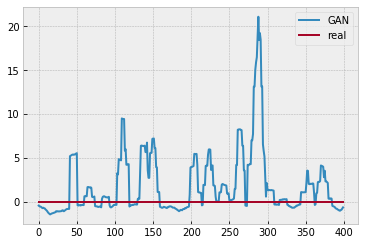

Batch_no: 20500  Epoch: 931


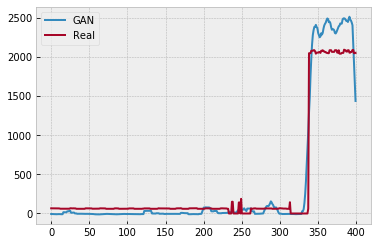

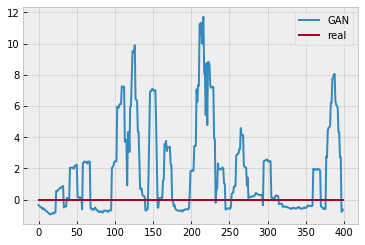

Batch_no: 21000  Epoch: 954


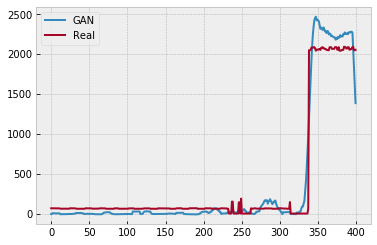

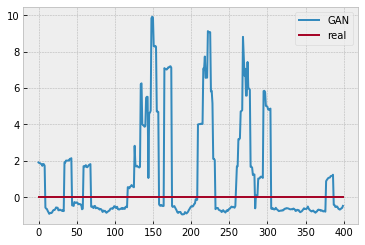

Batch_no: 21500  Epoch: 977


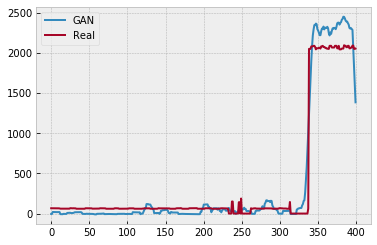

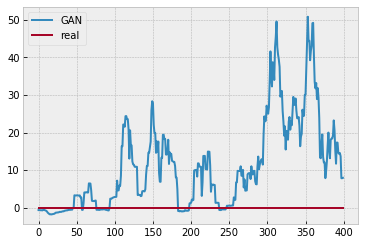

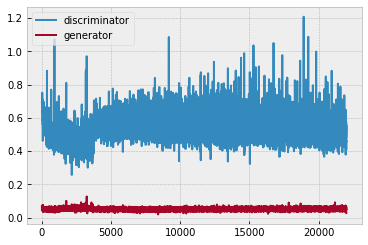

In [9]:


train_data_f=data_f()
dataloader=DataLoader(dataset=train_data_f,batch_size=batch_size,shuffle=True)



g_losses=[]
d_losses=[]



for epoch in range(n_epochs):
    g_running_loss=0.0
    d_running_loss=0.0
    for i, (aggregate, appliance) in enumerate(dataloader):

        #reshaping to fit the convolution layer
        aggregate_reshaped=aggregate.reshape(aggregate.shape[0],1,aggregate.shape[1])

        batch_size = appliance.shape[0]
        app=appliance[:,:]

        # Adversarial ground truths
        valid = Variable(FloatTensor(batch_size, 1).fill_(1.0), requires_grad=False)
        fake = Variable(FloatTensor(batch_size, 1).fill_(0.0), requires_grad=False)

        # Configure input
        real_aggregate_reshaped = Variable(aggregate_reshaped.type(FloatTensor))
        real_appliance = Variable(app.type(FloatTensor))
        real_aggregate= Variable(aggregate.type(FloatTensor))

        real_app_real_agg=torch.cat((real_appliance,real_aggregate),1)


        # -----------------
        #  Train Generator
        # -----------------
        optimizer_G.zero_grad()


        gen_appliance = generator(real_aggregate_reshaped)



        gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)

        validity,feat= discriminator(gen_app_real_agg)

        g_loss=feature_loss(feat, real_app_real_agg)
#         g_loss = adversarial_loss(validity, valid)

        g_loss.backward()
        optimizer_G.step()
        g_loss_1=g_loss.item()


#                 g_losses.append(g_loss.item())

########################################################################################################################
# # Generator second training round


        optimizer_G.zero_grad()

        gen_appliance = generator(real_aggregate_reshaped)



#         gen_appliance=gen_appliance-first_gen #subtract




        gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)
        validity,feat = discriminator(gen_app_real_agg)
        g_loss = feature_loss(feat, real_app_real_agg)

#         g_loss = adversarial_loss(validity, valid)


        g_loss.backward()
        g_loss_2=g_loss.item()

        optimizer_G.step()


        # g_running_loss+=g_loss.item()
        #g_epoch_loss=g_running_loss/len(dataloader)        
        #g_losses.append(g_epoch_loss)

# Generator third training round

        optimizer_G.zero_grad()

        gen_appliance = generator(real_aggregate_reshaped)


#         gen_appliance=gen_appliance-first_gen #subtract

        gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)

        validity,feat = discriminator(gen_app_real_agg)


        g_loss = feature_loss(feat, real_app_real_agg)
#         g_loss = adversarial_loss(validity, valid)

        g_loss.backward()
        optimizer_G.step()

        g_loss_3=g_loss.item()

        g_losses.append((g_loss_1+g_loss_2+g_loss_3)/3)


# ----------
#  Training
# ----------


        # ---------------------
        #  Train Discriminator
        # ---------------------


        optimizer_D.zero_grad()


        real_app_real_agg=torch.cat((appliance,aggregate),1)

        real_app_real_agg=Variable(real_app_real_agg.type(FloatTensor))

        validity_real,_ = discriminator(real_app_real_agg)
        d_real_loss = adversarial_loss(validity_real, valid)

        validity_fake,_ = discriminator(gen_app_real_agg.detach()) #detach
        d_fake_loss = adversarial_loss(validity_fake, fake)

        d_loss = (d_real_loss + d_fake_loss) / 2


        d_loss.backward()
        optimizer_D.step()


        d_losses.append(d_loss.item())

        ## end trining discrimnator

        batches_done = epoch * len(dataloader) + i
        #print("Epoch:",epoch,"Batch:",i,"of:",len(dataloader),"batches done:",batches_done)
        if batches_done % sample_interval == 0:
            print("Batch_no:",batches_done," Epoch:",epoch)
            sample_data(n_row=1, batches_done=batches_done)
plt.plot(d_losses,label="discriminator")
plt.plot(g_losses,label="generator")
plt.legend()
plt.show()


#disaggregate
# house 1



# end house 1

# #house 5
# X_to_disaggregate=np.load("X_raw_house_5.npy") 
# Y_true=np.load("Y_raw_house_5.npy")
# X_to_disaggregate=X_to_disaggregate[::s][0:140000]
# Y_true=Y_true[::s][0:140000]
# # print(X_s.shape[0])
# plt.plot(Y_true)
# #end house 5



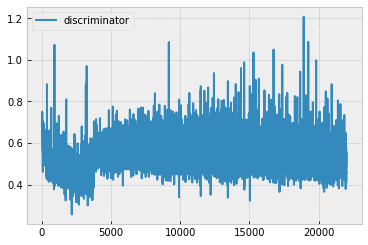

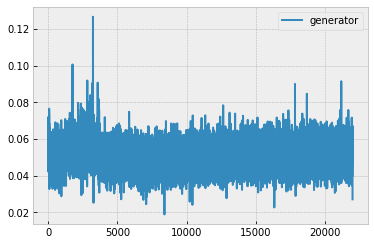

In [10]:
plt.plot(d_losses,label="discriminator")
plt.legend()
plt.show()

plt.plot(g_losses,label="generator")
plt.legend()
plt.show()


## Disaggregate

In [20]:


X_to_disaggregate=np.load("data/REFIT_house6_X_raw_test_DW.npy")#[0:2000]
Y_true=np.load("data/REFIT_house6_Y_raw_test_DW.npy")#[0:2000]

agg_len=X_to_disaggregate.shape[0]
w=sig_len
step=int(100) #64 #32

agg_segments=np.zeros((1,w))
app_segments=np.zeros((1,w))



i=0
while i<=agg_len-w:
    agg_segment=X_to_disaggregate[i:i+w].reshape(1,-1)
    app_segment=Y_true[i:i+w].reshape(1,-1)
    agg_segments=np.concatenate((agg_segments,agg_segment),axis=0)
    app_segments=np.concatenate((app_segments,app_segment),axis=0)
    i+=step

agg_segments=agg_segments[1:,:]    
app_segments=app_segments[1:,:]    



agg_segments_scaled=scale_agg.transform(agg_segments)
agg_segments_scaled_reshaped=agg_segments_scaled.reshape(agg_segments_scaled.shape[0],1,agg_segments_scaled.shape[1])
app_segments_scaled=scale_app.transform(app_segments)


samples_from=0
samples_to=int(len(agg_segments_scaled_reshaped))

sub_agg_segments=agg_segments_scaled_reshaped[samples_from:samples_to,:]
sub_app_true=app_segments_scaled[samples_from:samples_to,:]

#sub_app_true=app_segments[samples_from:samples_to,:]
gen_out=disaggregate(sub_agg_segments)#tensor generated

disaggregated_appliance=np.array(gen_out.cpu().detach()) #numpy appliance generated
disaggregated_appliance_inv=scale_app.inverse_transform(disaggregated_appliance)

# sub_app_true_inv=scale_app.inverse_transform(sub_app_true) #app segments

threshold=0
disaggregated_appliance_inv[disaggregated_appliance_inv<=threshold] = 0
sub_agg_segments[sub_agg_segments<=threshold] = 0


disaggregation_confidence=confidence(appliance=gen_out,aggregate=sub_agg_segments[:,0,:])
disaggregation_confidence.shape


indecis_matrix=np.zeros(sub_app_true.shape)
indecis_matrix.shape

d=np.array(disaggregation_confidence.cpu().detach())
confidence_repeated=np.repeat(d,disaggregated_appliance.shape[1],axis=1)


k=0
for i in range(len(indecis_matrix)):
    indecis_matrix[i,:]=np.arange(k,k+w,dtype = 'int')
    k+=step
indecis_matrix=indecis_matrix.reshape(1,-1).astype("int")
disaggregated_appliance_flat=disaggregated_appliance_inv.reshape(1,-1)
real_appliance_flat=app_segments.reshape(1,-1)
confidence_repeated_flat=confidence_repeated.reshape(1,-1)


print("segmenting predictions...")

pred_dict={}
confidence_dict={}
real_dict={}

for j in range(np.max(indecis_matrix)):
    if j % 5000 == 0:
        print(j," of ", np.max(indecis_matrix))
    a=np.where(indecis_matrix==j)[1]
    pred_dict[j]=disaggregated_appliance_flat[0,a]
    confidence_dict[j]=confidence_repeated_flat[0,a]
    real_dict[j]=real_appliance_flat[0,a]




from scipy import stats
threshold=0

pred_clustered=[] 
true_app_list=[]
for key in pred_dict.keys():
    p=pred_dict[key]
    conf=confidence_dict[key]
#     p[p<=threshold]=0  # thresholding
#     pred_clustered.append(p.mean())

    pred_clustered.append(p[np.argmax(conf)])
#     pred_clustered.append(np.percentile(pred_dict[key],80))
    tr=real_dict[key]
#     tr[tr<=threshold]=0

    true_app_list.append(tr[0])




segmenting predictions...
0  of  199999
5000  of  199999
10000  of  199999
15000  of  199999
20000  of  199999
25000  of  199999
30000  of  199999
35000  of  199999
40000  of  199999
45000  of  199999
50000  of  199999
55000  of  199999
60000  of  199999
65000  of  199999
70000  of  199999
75000  of  199999
80000  of  199999
85000  of  199999
90000  of  199999
95000  of  199999
100000  of  199999
105000  of  199999
110000  of  199999
115000  of  199999
120000  of  199999
125000  of  199999
130000  of  199999
135000  of  199999
140000  of  199999
145000  of  199999
150000  of  199999
155000  of  199999
160000  of  199999
165000  of  199999
170000  of  199999
175000  of  199999
180000  of  199999
185000  of  199999
190000  of  199999
195000  of  199999


+++++++++++++++++++
Smoothed..
recall= 0.454791, precision= 0.358892, F1= 0.401190, accuracy= 0.994970
RE=0.175057, MAE= 8.430719
0.41592920353982304 8.249398624060682


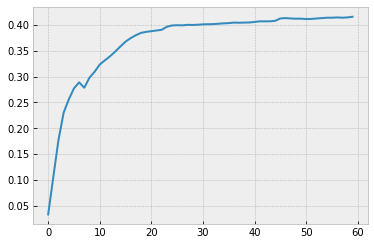

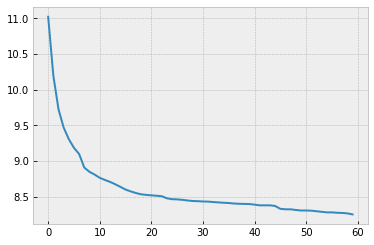

In [23]:

shift=0    
pred_clustered_shifted=np.zeros(len(pred_clustered))
pred_clustered_shifted[shift:len(pred_clustered)]=pred_clustered[0:len(pred_clustered)-shift]
# pred_clustered_shifted=pred_clustered_shifted-np.ones(pred_clustered_shifted.shape)*500
# pred_clustered_shifted[pred_clustered_shifted <=0] = 0


predictions=np.asarray(pred_clustered_shifted)[0:int(len(pred_clustered_shifted))]
appliance_true=np.asarray(Y_true[0:int(len(pred_clustered_shifted))])


predictions_smoothed=smooth(predictions,box_pts=10)
appliance_true_smoothed=smooth(appliance_true,box_pts=10)#(appliance_true[:,0],box_pts=10)

print("+++++++++++++++++++")
# print(str(g_retrain))
print("Smoothed..")
recall2,precision2,F12,accuracy2=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=300)
print("recall= %f, precision= %f, F1= %f, accuracy= %f" %(recall2,precision2,F12,accuracy2))

RE2,MAE2=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=300)
print("RE=%f, MAE= %f"%(RE2,MAE2))
# performance1[str(g_retrain)]=[F12,MAE2,RE2]

print("=============================================================")



f1=[]
mae=[]
for i in range(0,600,10):
#     print(i)
    _,_,f,_=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=i)
    f1.append(f)
    _,mae1=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=i)
    mae.append(mae1)


print(max(f1),mae[f1.index(max(f1))])

plt.plot(f1)
plt.show()

plt.plot(mae)
plt.show()

with open('Perf_M4.txt', 'a') as f:
    f.write("   F1:")
    f.write(str([F12]))
    f.write("   MAE:")
    f.write(str([MAE2]))
    f.write("\n\n")
# f.close()
# plt.plot(predictions_smoothed[11000:15000])
# plt.plot(appliance_true_smoothed[11000:15000])
# plt.show()
# portion=int(portion+15*35)



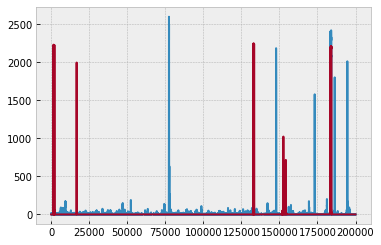

In [22]:
plt.plot(predictions_smoothed)
plt.plot(appliance_true_smoothed)
plt.show()

In [15]:


shift=0    
pred_clustered_shifted=np.zeros(len(pred_clustered))
pred_clustered_shifted[shift:len(pred_clustered)]=pred_clustered[0:len(pred_clustered)-shift]
# pred_clustered_shifted=pred_clustered_shifted-np.ones(pred_clustered_shifted.shape)*500
# pred_clustered_shifted[pred_clustered_shifted <=0] = 0


predictions=np.asarray(pred_clustered_shifted)[0:int(len(pred_clustered_shifted))]
appliance_true=np.asarray(Y_true[0:int(len(pred_clustered_shifted))])


predictions_smoothed=smooth(predictions,box_pts=10)
appliance_true_smoothed=smooth(appliance_true,box_pts=10)

print("+++++++++++++++++++")
print(str(g_retrain))
print("Smoothed..")
recall2,precision2,F12,accuracy2=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
print("recall= %f, precision= %f, F1= %f, accuracy= %f" %(recall2,precision2,F12,accuracy2))

RE2,MAE2=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
print("RE=%f, MAE= %f"%(RE2,MAE2))

performance1[str(g_retrain)]=[F12,MAE2,RE2]

print("=============================================================")


with open('perf_On_UKDALE_WM_data_amount.txt', 'a') as f:
    f.write(str(g_retrain))
    f.write(str(d_retrain))
    f.write(portion)
    f.write("   F1:")
    f.write(str([F12]))
    f.write("\n\n")
f.close()
portion=int(portion+15*35)



f1=[]
mae=[]
for i in range(0,1200,10):
#     print(i)
    _,_,f,_=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=i)
    f1.append(f)
    _,mae1=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=i)
    mae.append(mae1)


print(max(f1),mae[f1.index(max(f1))])

plt.plot(f1)
plt.show()

plt.plot(mae)
plt.show()

+++++++++++++++++++


NameError: name 'g_retrain' is not defined

In [ ]:
predictions_smoothed.shape

## Fix all generator 

g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are kept
g5 weights are kept
g6 weights are kept
g7 weights are kept
d1 weights are initialized
d2 weights are initialized
d3 weights are initialized
d4 weights are initialized
d5 weights are initialized
Batch_no: 0  Epoch: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:71: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


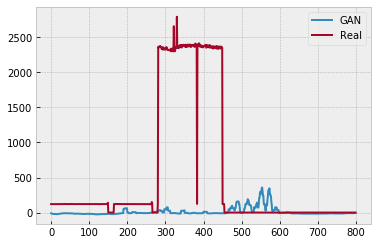

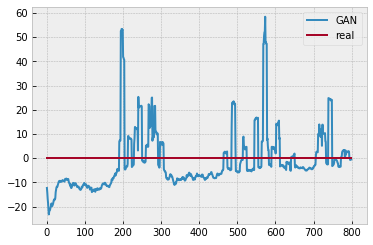

Batch_no: 500  Epoch: 7


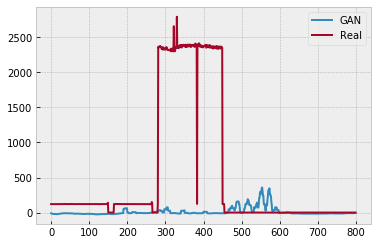

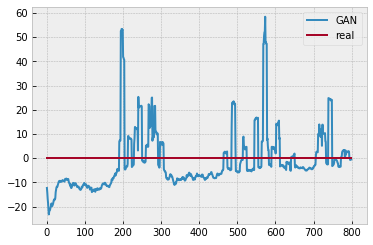

Batch_no: 1000  Epoch: 15


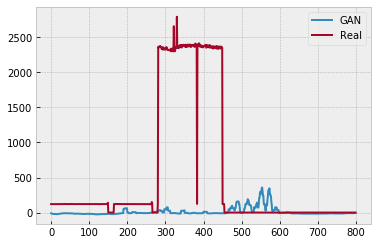

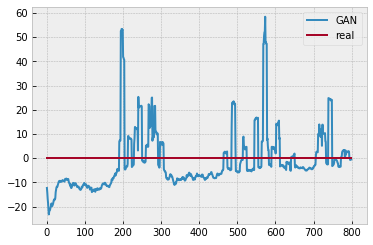

Batch_no: 1500  Epoch: 23


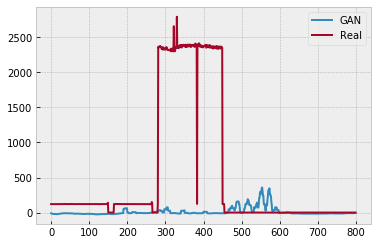

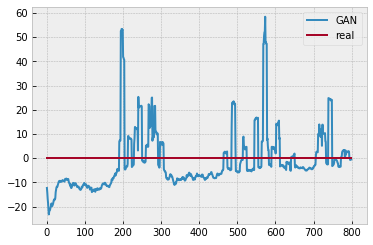

Batch_no: 2000  Epoch: 30


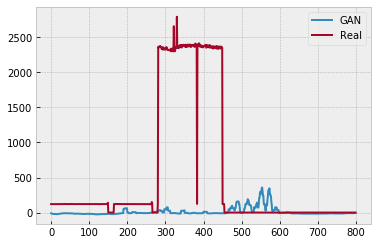

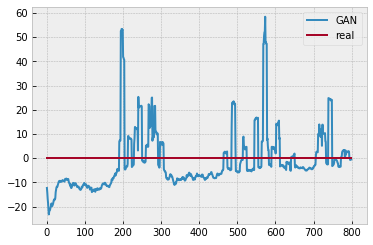

Batch_no: 2500  Epoch: 38


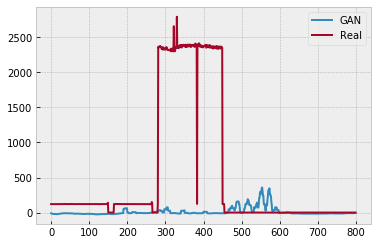

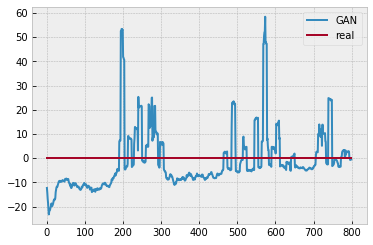

Batch_no: 3000  Epoch: 46


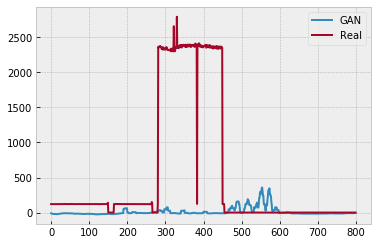

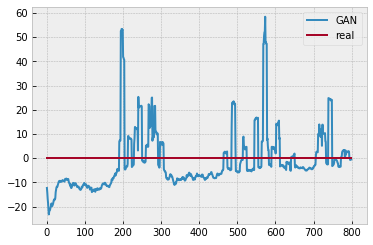

Batch_no: 3500  Epoch: 53


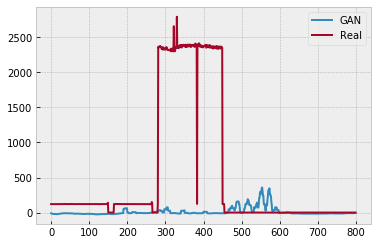

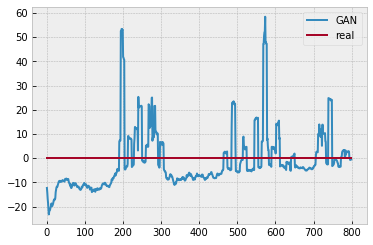

Batch_no: 4000  Epoch: 61


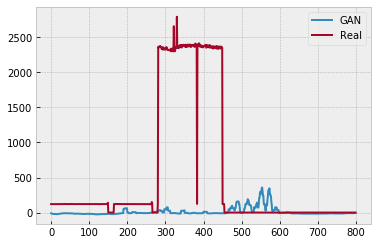

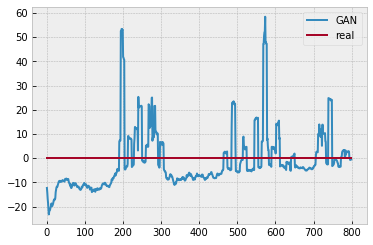

Batch_no: 4500  Epoch: 69


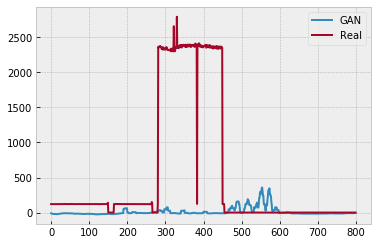

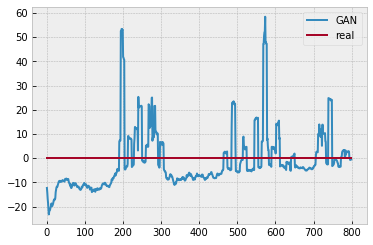

Batch_no: 5000  Epoch: 76


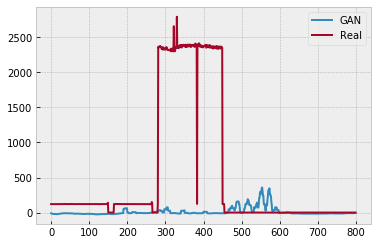

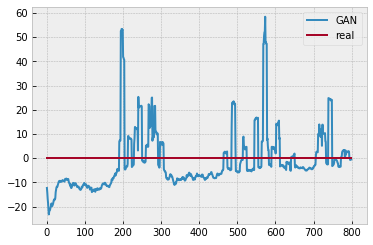

Batch_no: 5500  Epoch: 84


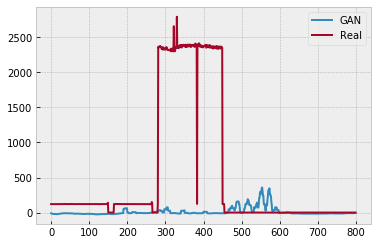

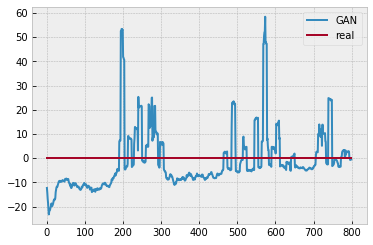

Batch_no: 6000  Epoch: 92


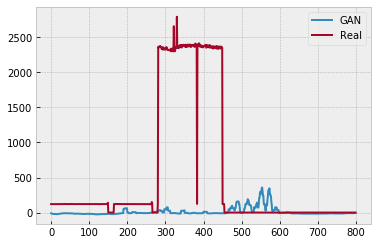

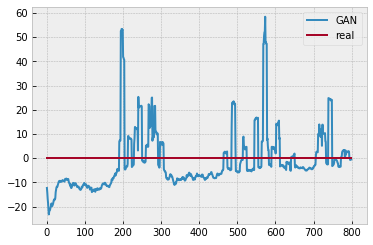

Batch_no: 6500  Epoch: 100


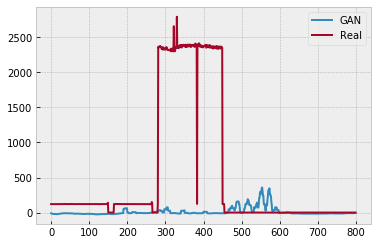

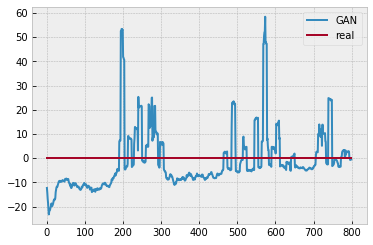

Batch_no: 7000  Epoch: 107


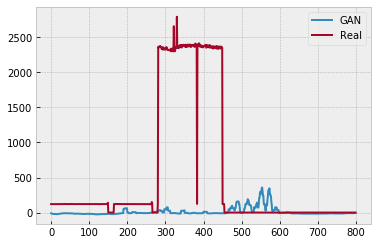

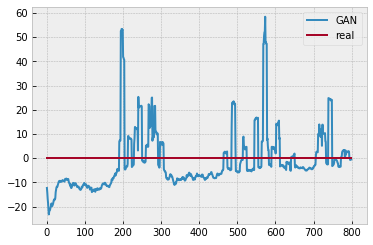

Batch_no: 7500  Epoch: 115


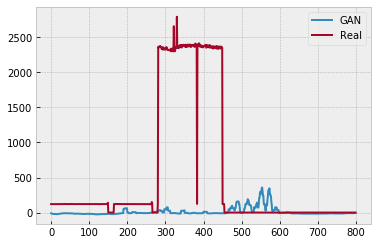

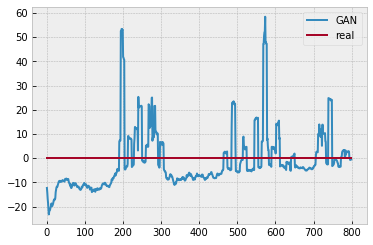

Batch_no: 8000  Epoch: 123


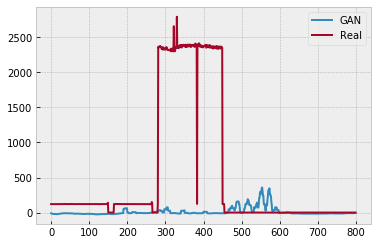

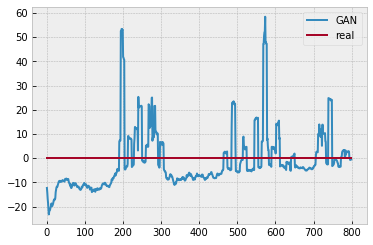

Batch_no: 8500  Epoch: 130


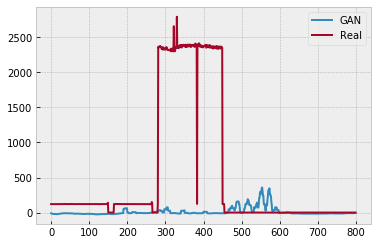

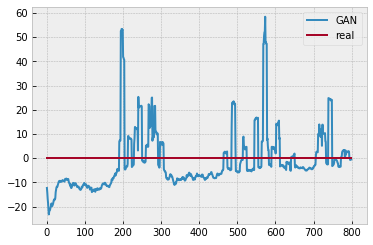

Batch_no: 9000  Epoch: 138


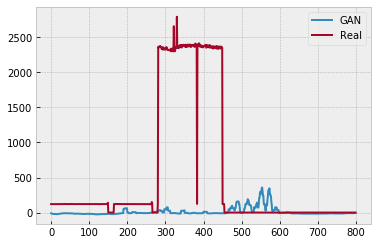

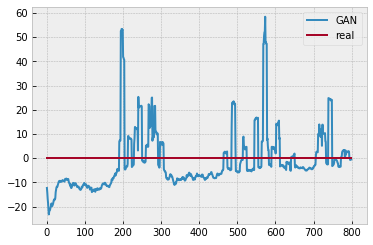

Batch_no: 9500  Epoch: 146


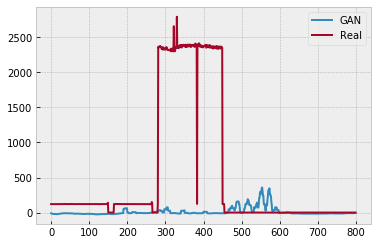

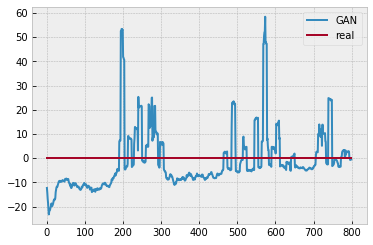

Batch_no: 10000  Epoch: 153


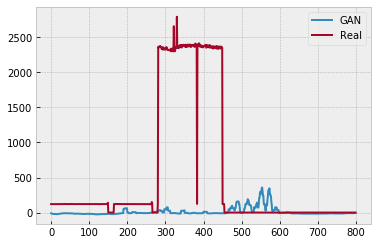

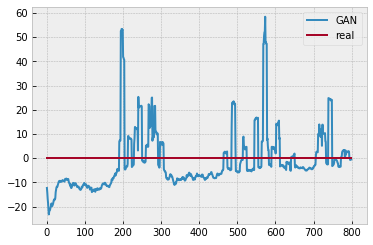

Batch_no: 10500  Epoch: 161


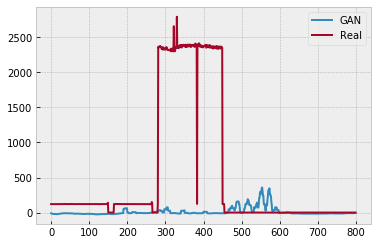

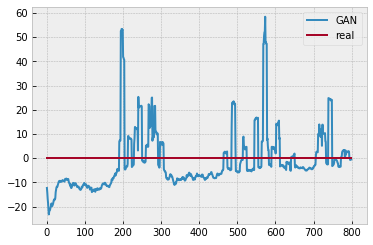

Batch_no: 11000  Epoch: 169


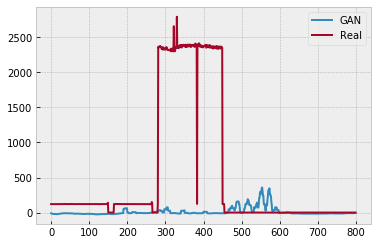

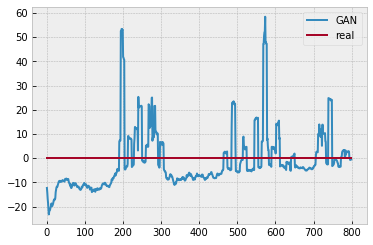

Batch_no: 11500  Epoch: 176


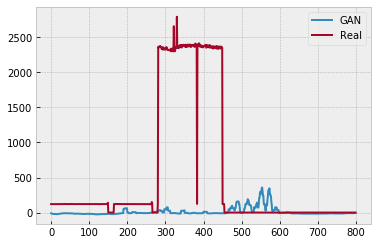

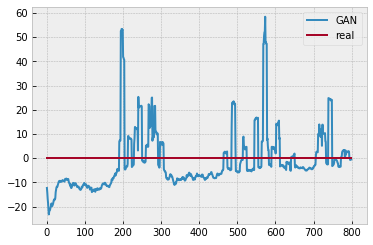

Batch_no: 12000  Epoch: 184


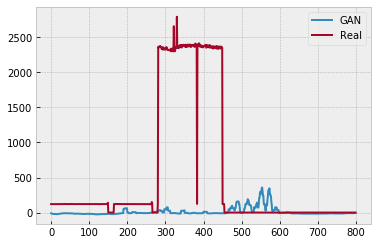

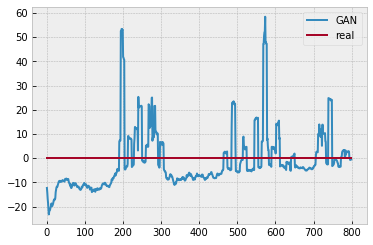

Batch_no: 12500  Epoch: 192


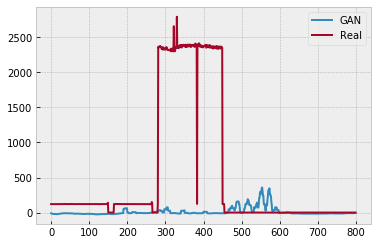

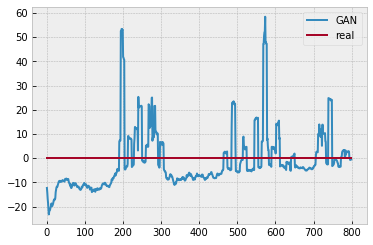

Batch_no: 13000  Epoch: 200


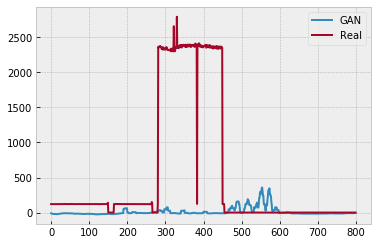

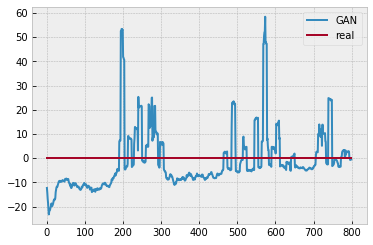

Batch_no: 13500  Epoch: 207


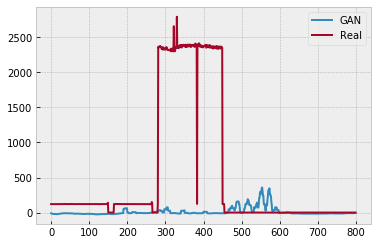

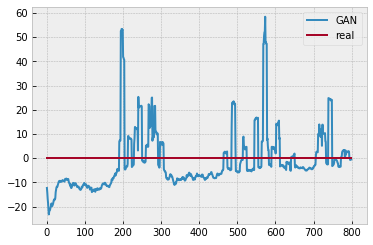

Batch_no: 14000  Epoch: 215


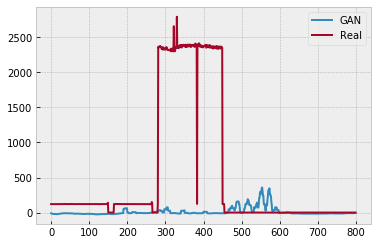

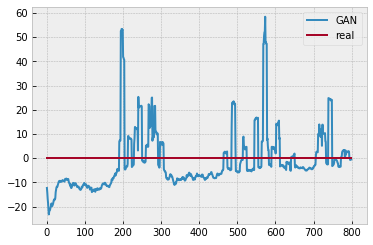

Batch_no: 14500  Epoch: 223


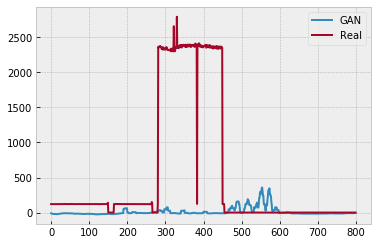

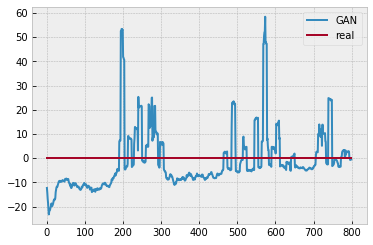

Batch_no: 15000  Epoch: 230


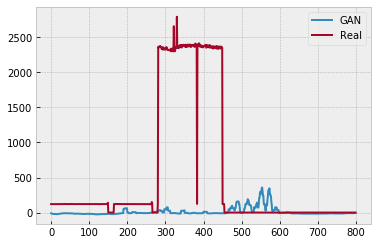

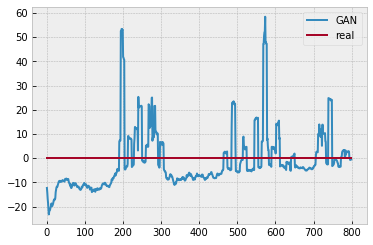

Batch_no: 15500  Epoch: 238


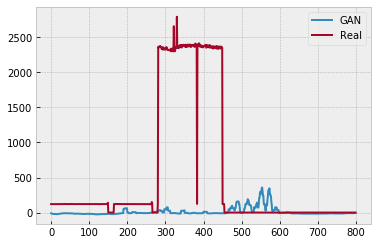

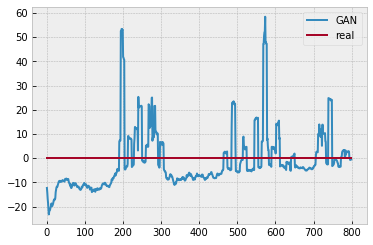

Batch_no: 16000  Epoch: 246


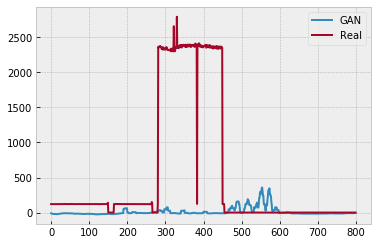

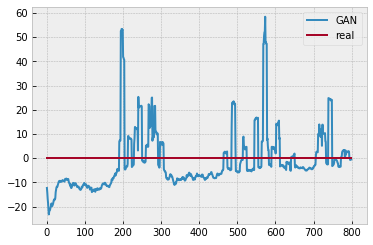

Batch_no: 16500  Epoch: 253


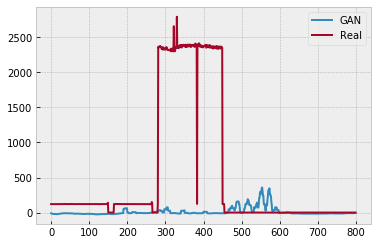

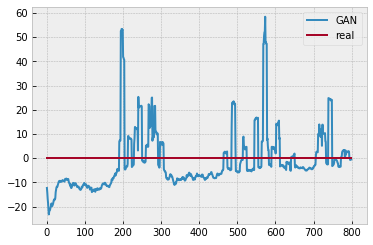

Batch_no: 17000  Epoch: 261


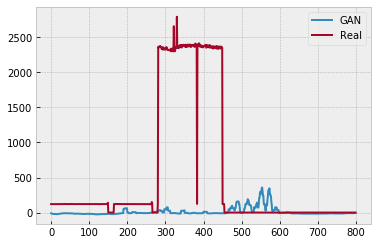

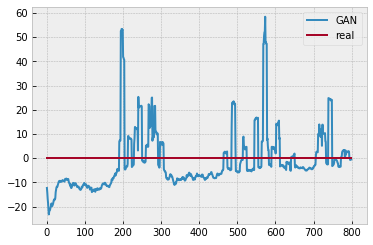

Batch_no: 17500  Epoch: 269


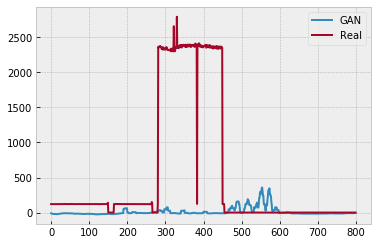

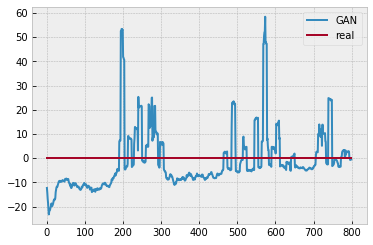

Batch_no: 18000  Epoch: 276


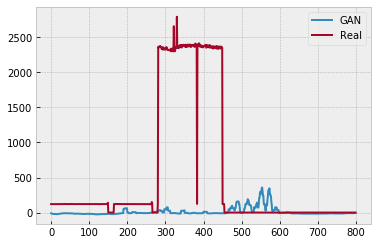

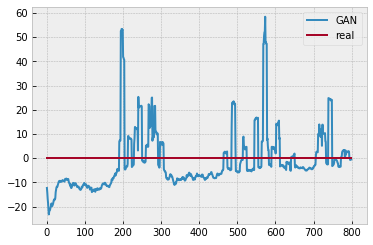

Batch_no: 18500  Epoch: 284


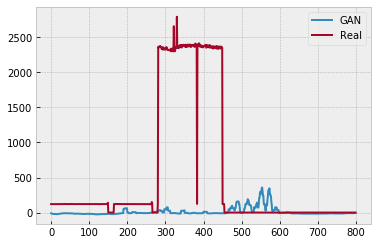

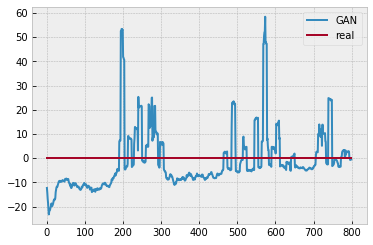

Batch_no: 19000  Epoch: 292


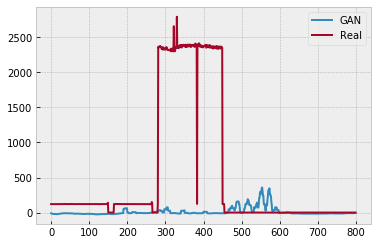

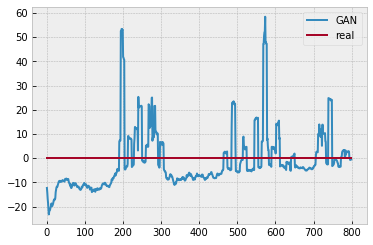

Batch_no: 19500  Epoch: 300


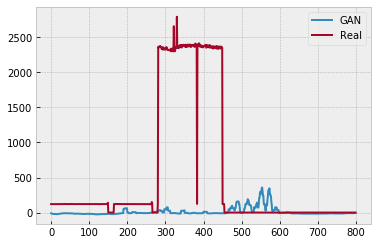

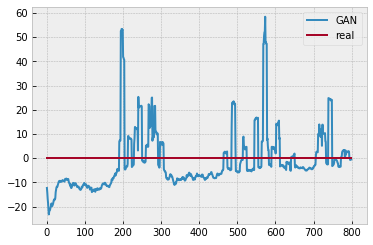

Batch_no: 20000  Epoch: 307


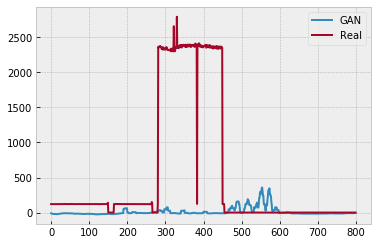

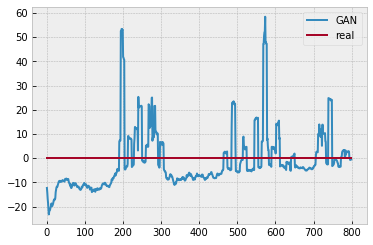

Batch_no: 20500  Epoch: 315


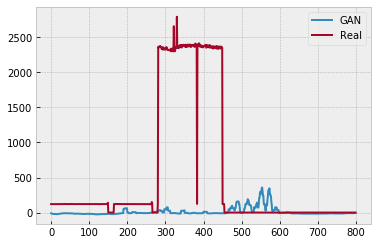

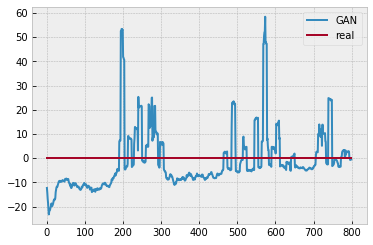

Batch_no: 21000  Epoch: 323


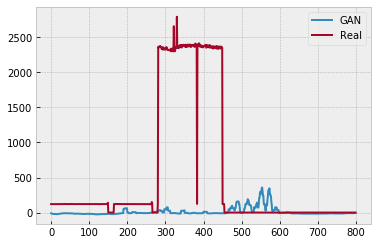

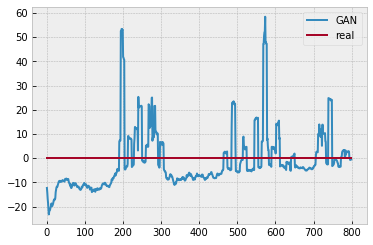

Batch_no: 21500  Epoch: 330


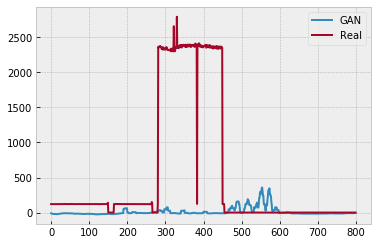

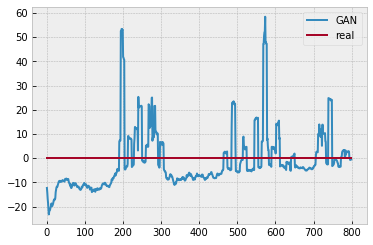

Batch_no: 22000  Epoch: 338


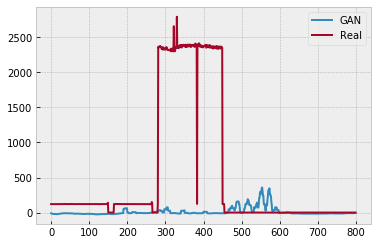

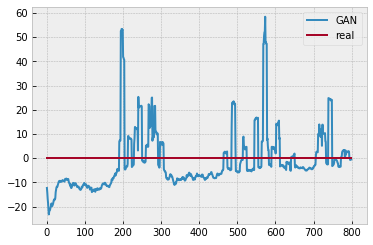

Batch_no: 22500  Epoch: 346


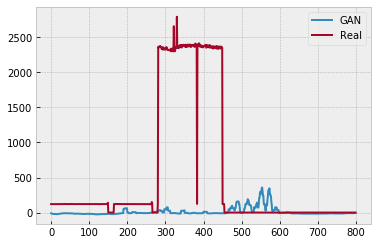

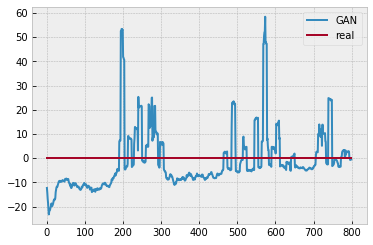

Batch_no: 23000  Epoch: 353


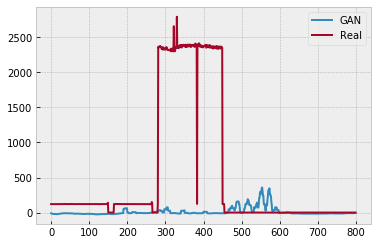

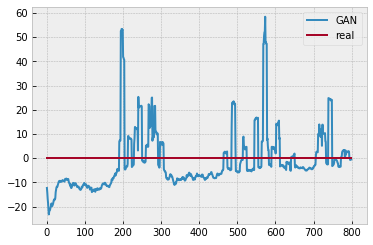

Batch_no: 23500  Epoch: 361


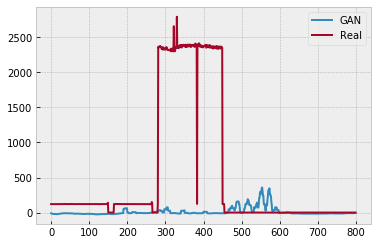

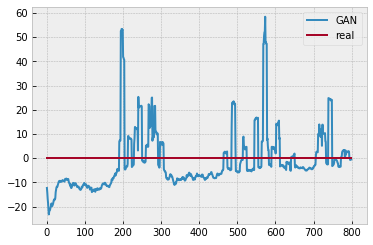

Batch_no: 24000  Epoch: 369


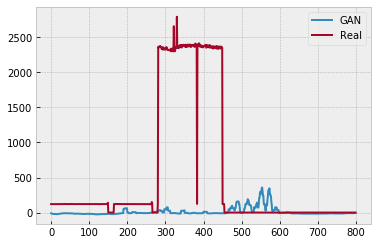

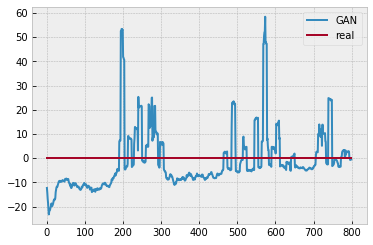

Batch_no: 24500  Epoch: 376


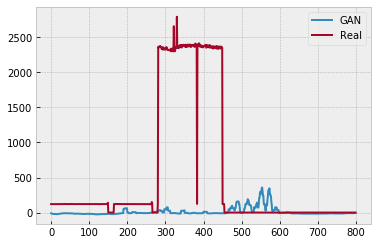

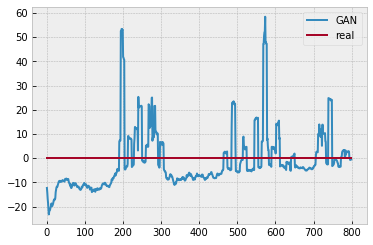

Batch_no: 25000  Epoch: 384


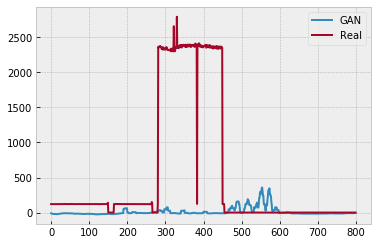

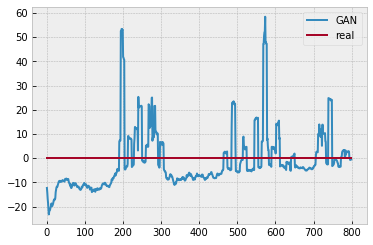

Batch_no: 25500  Epoch: 392


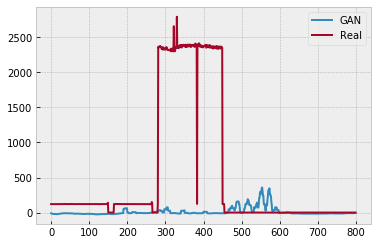

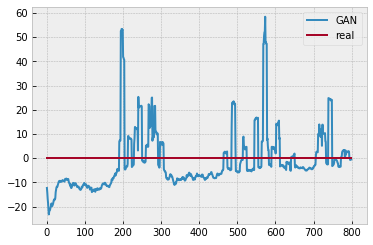

Batch_no: 26000  Epoch: 400


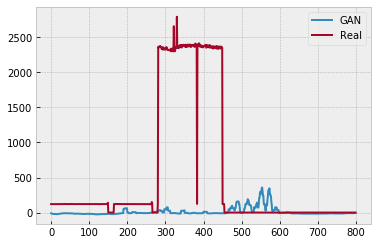

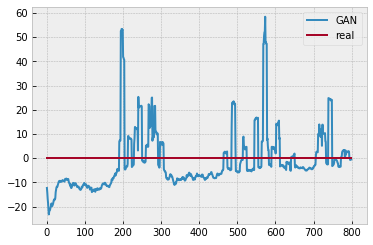

Batch_no: 26500  Epoch: 407


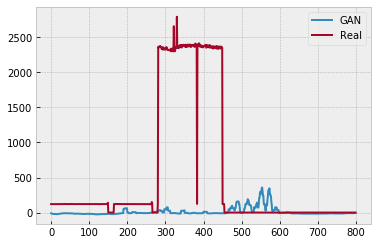

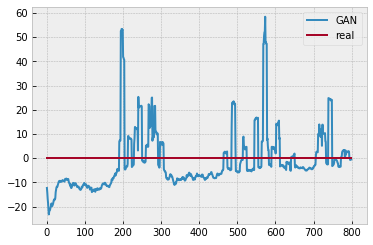

Batch_no: 27000  Epoch: 415


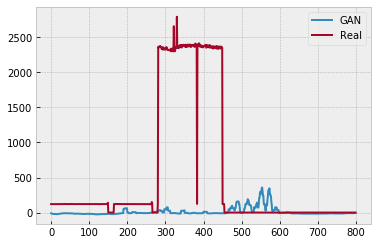

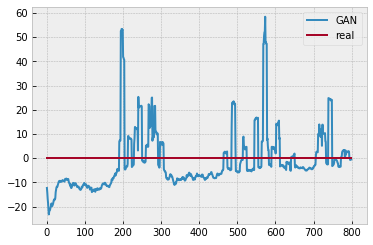

Batch_no: 27500  Epoch: 423


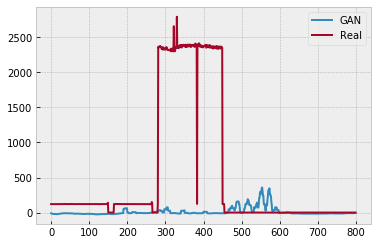

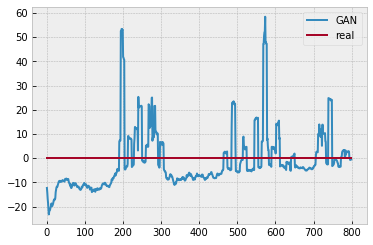

Batch_no: 28000  Epoch: 430


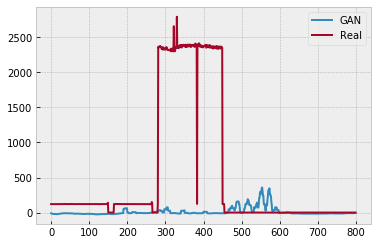

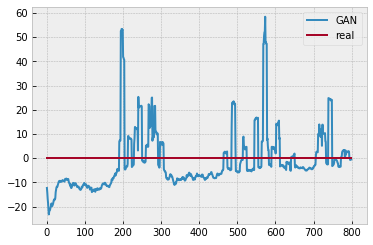

Batch_no: 28500  Epoch: 438


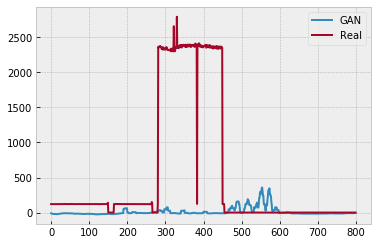

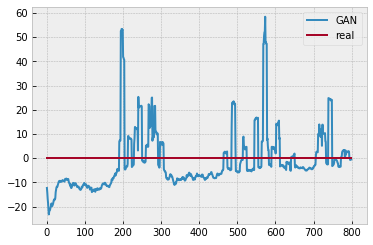

Batch_no: 29000  Epoch: 446


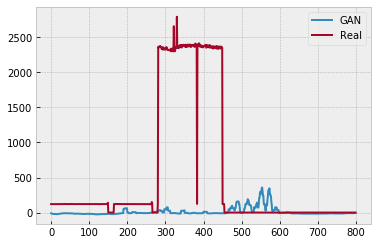

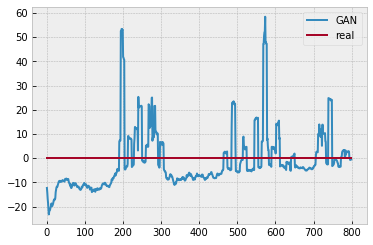

Batch_no: 29500  Epoch: 453


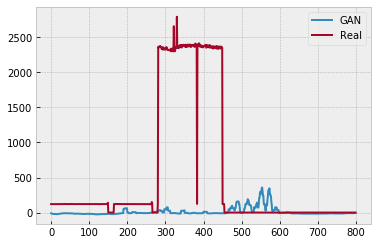

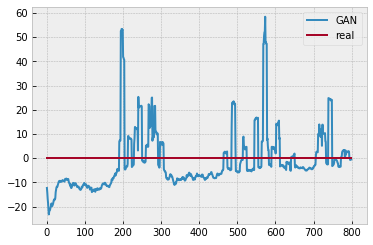

Batch_no: 30000  Epoch: 461


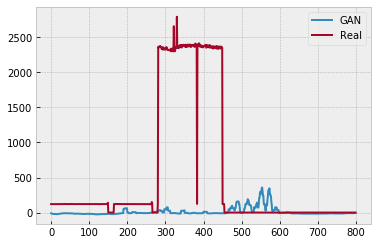

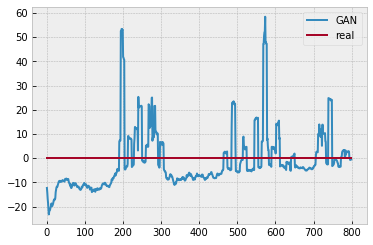

Batch_no: 30500  Epoch: 469


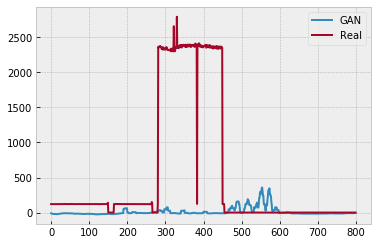

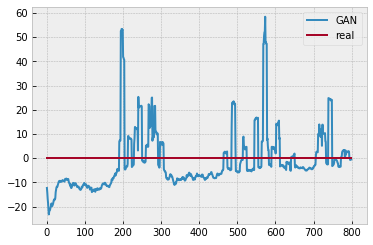

Batch_no: 31000  Epoch: 476


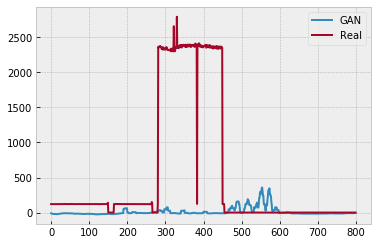

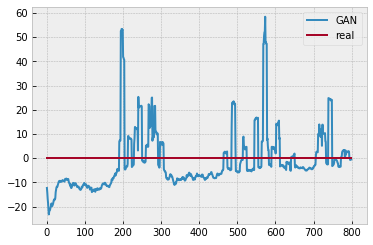

Batch_no: 31500  Epoch: 484


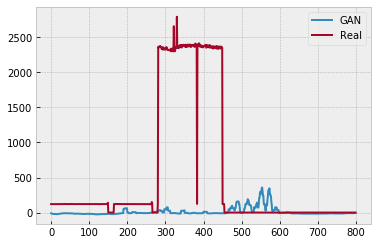

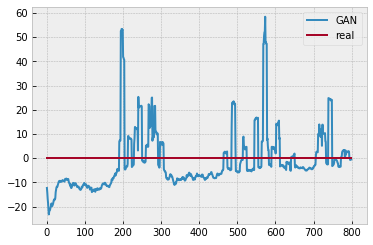

Batch_no: 32000  Epoch: 492


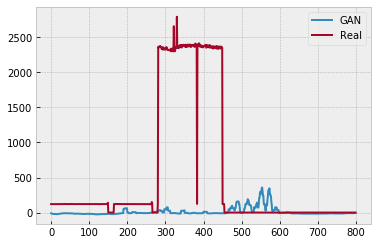

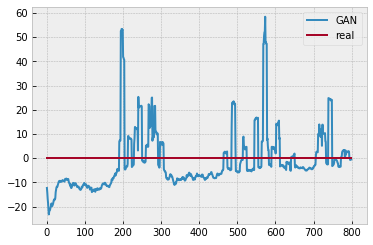

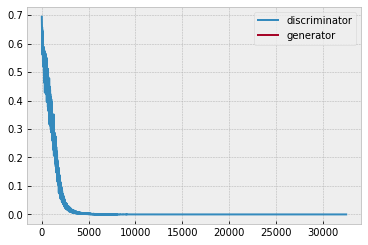

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['gxxx']
Smoothed..
recall= 0.177458, precision= 0.144410, F1= 0.159238, accuracy= 0.945299
RE=0.084864, MAE= 44.550136
g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are kept
g5 weights are kept
g6 weights are kept
g7 weights are kept
d1 weights are kept
d2 weights are initialized
d3 weights are initialized
d4 weights are initialized
d5 weights are initialized
Batch_no: 0  Epoch: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:71: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


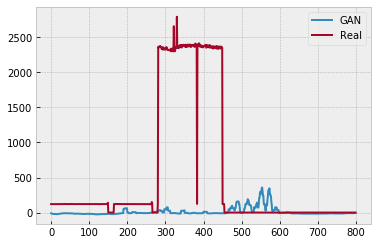

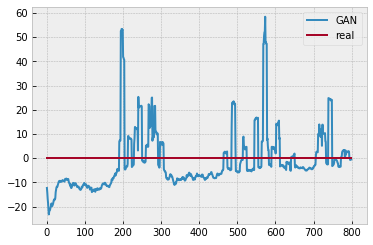

Batch_no: 500  Epoch: 7


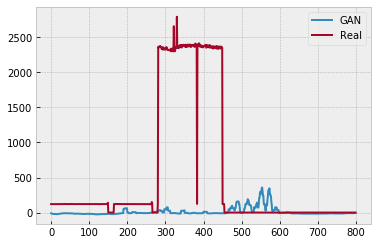

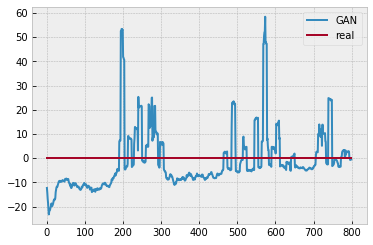

Batch_no: 1000  Epoch: 15


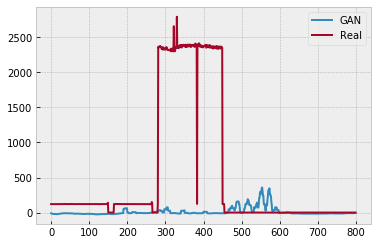

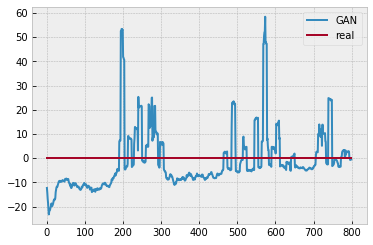

Batch_no: 1500  Epoch: 23


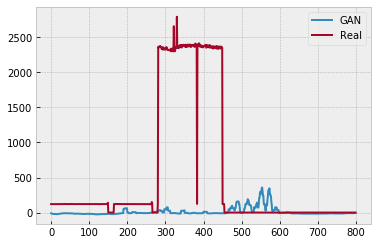

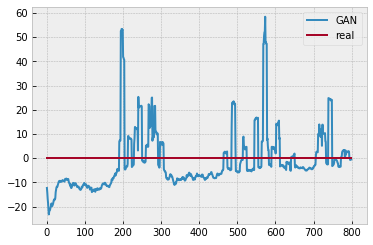

Batch_no: 2000  Epoch: 30


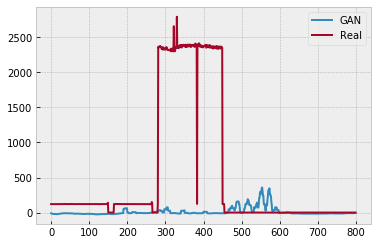

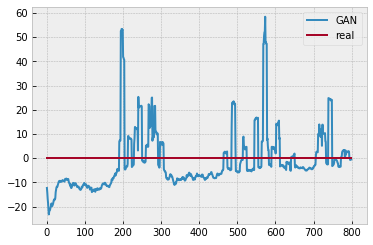

Batch_no: 2500  Epoch: 38


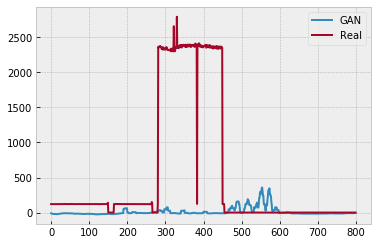

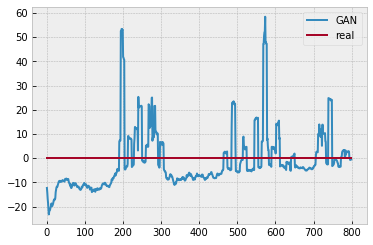

Batch_no: 3000  Epoch: 46


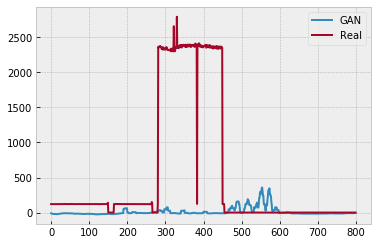

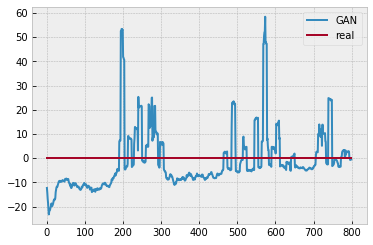

Batch_no: 3500  Epoch: 53


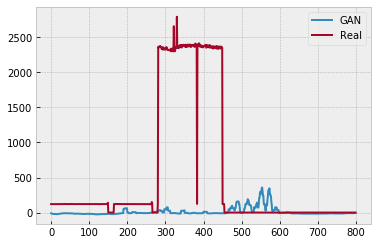

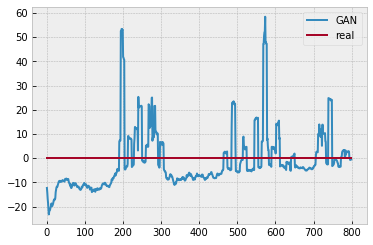

Batch_no: 4000  Epoch: 61


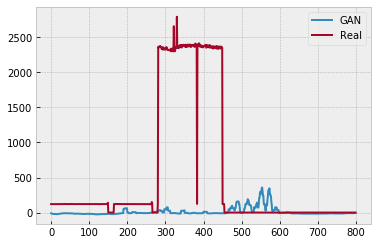

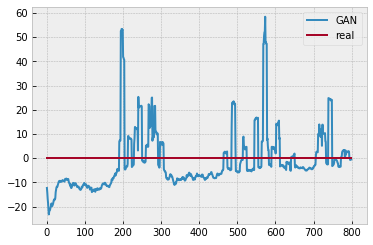

Batch_no: 4500  Epoch: 69


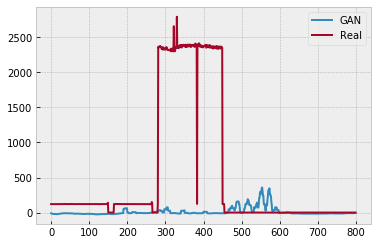

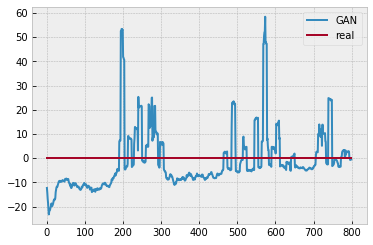

Batch_no: 5000  Epoch: 76


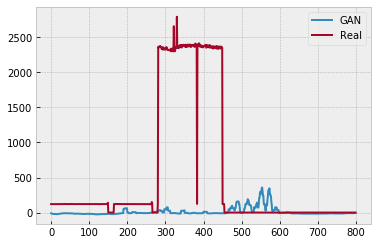

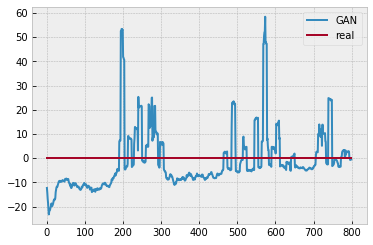

Batch_no: 5500  Epoch: 84


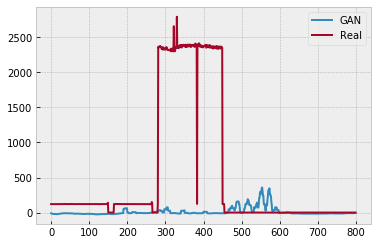

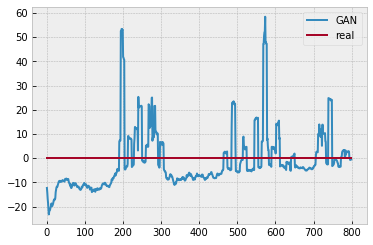

Batch_no: 6000  Epoch: 92


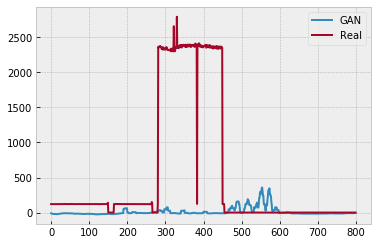

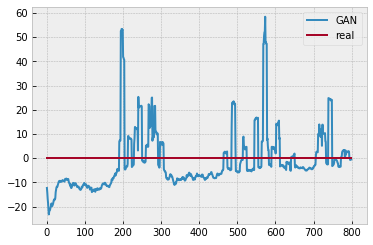

Batch_no: 6500  Epoch: 100


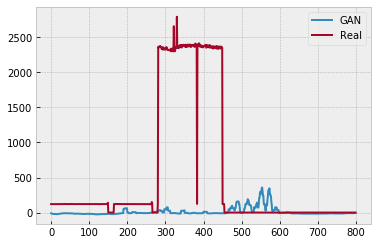

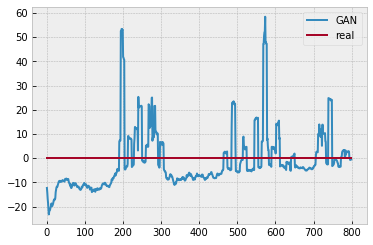

Batch_no: 7000  Epoch: 107


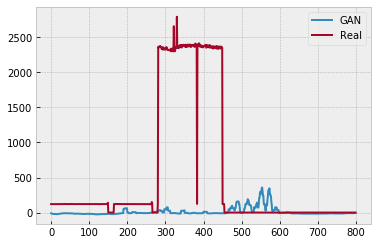

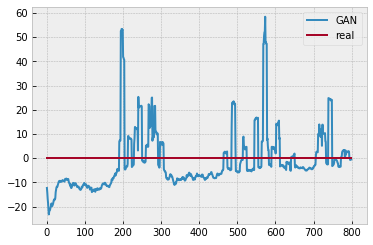

Batch_no: 7500  Epoch: 115


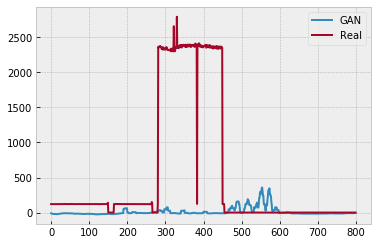

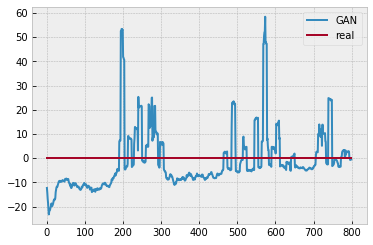

Batch_no: 8000  Epoch: 123


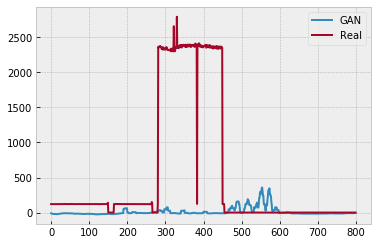

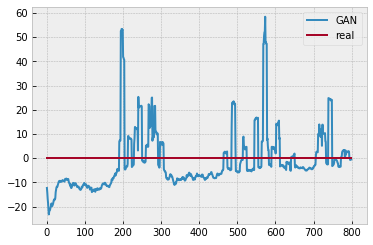

Batch_no: 8500  Epoch: 130


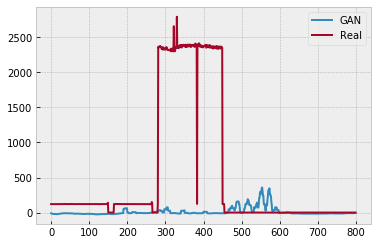

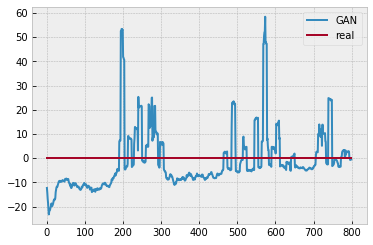

Batch_no: 9000  Epoch: 138


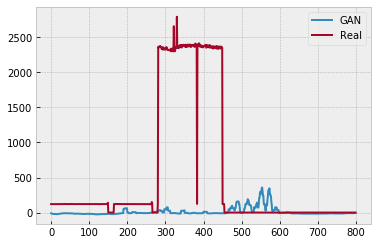

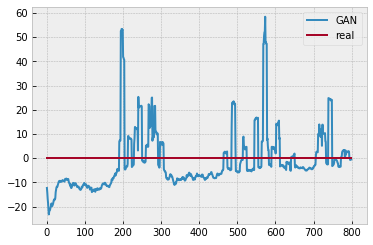

Batch_no: 9500  Epoch: 146


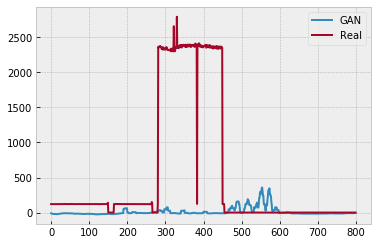

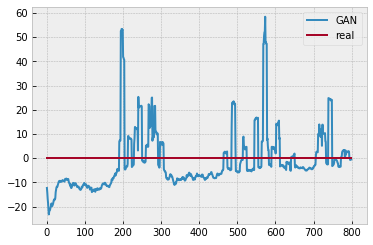

Batch_no: 10000  Epoch: 153


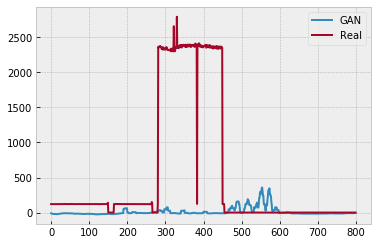

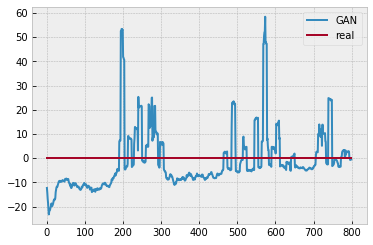

Batch_no: 10500  Epoch: 161


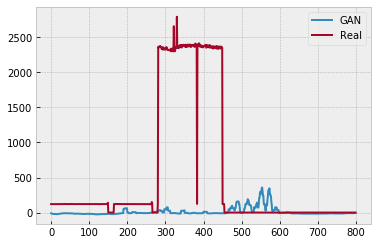

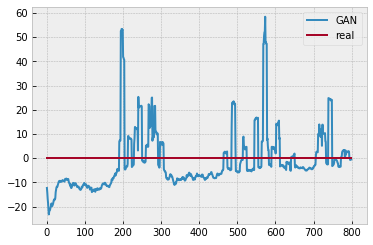

Batch_no: 11000  Epoch: 169


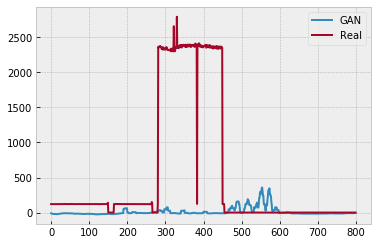

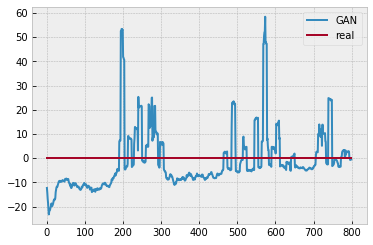

Batch_no: 11500  Epoch: 176


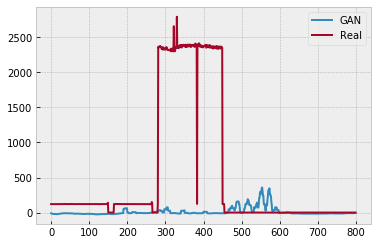

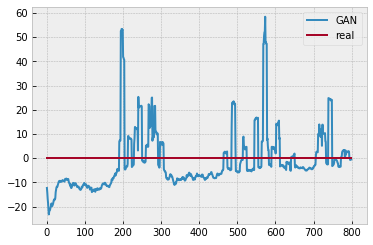

Batch_no: 12000  Epoch: 184


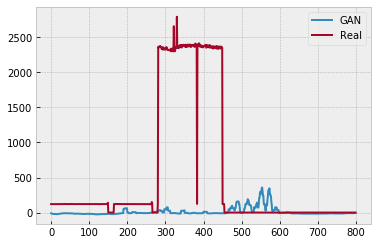

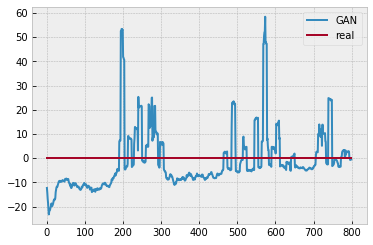

Batch_no: 12500  Epoch: 192


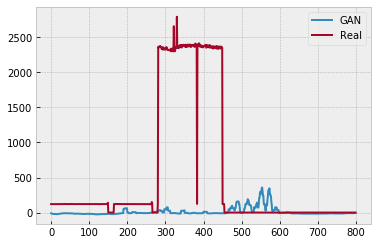

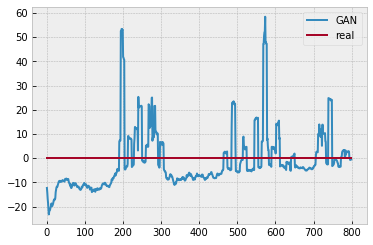

Batch_no: 13000  Epoch: 200


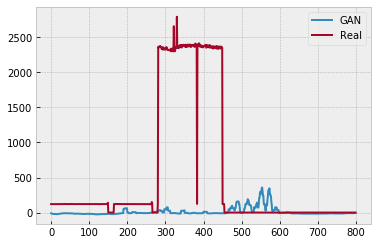

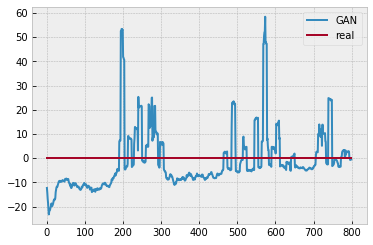

Batch_no: 13500  Epoch: 207


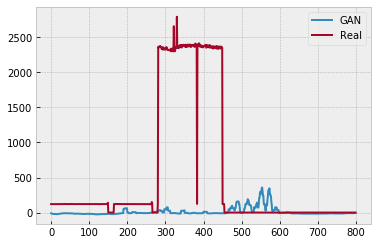

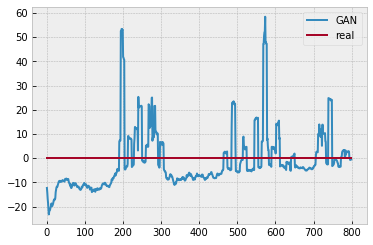

Batch_no: 14000  Epoch: 215


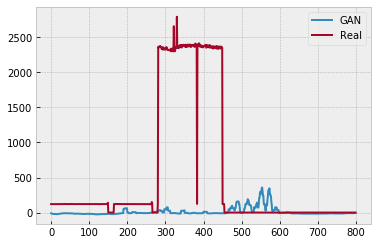

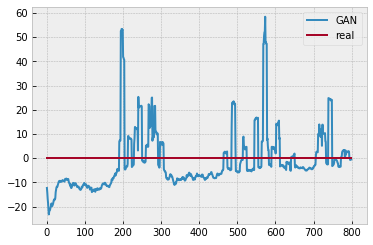

Batch_no: 14500  Epoch: 223


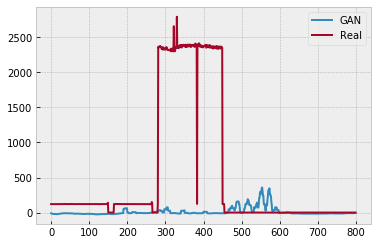

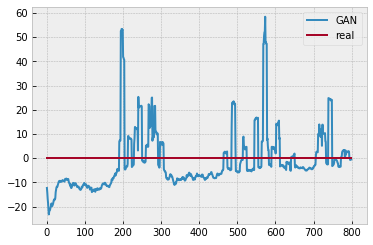

Batch_no: 15000  Epoch: 230


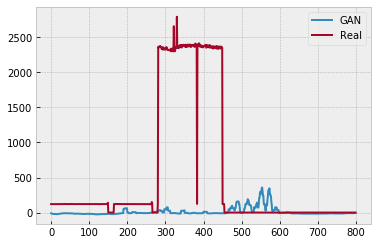

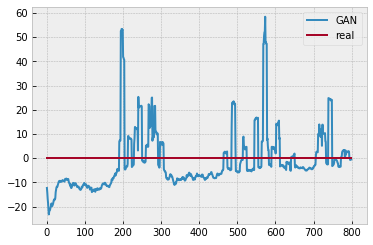

Batch_no: 15500  Epoch: 238


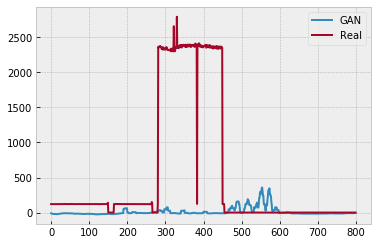

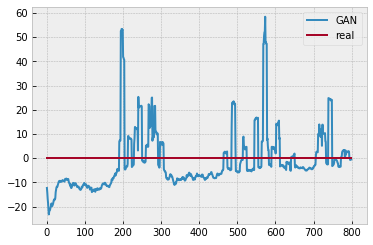

Batch_no: 16000  Epoch: 246


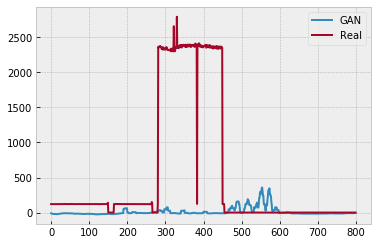

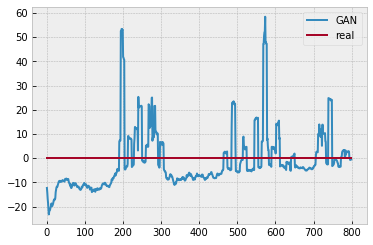

Batch_no: 16500  Epoch: 253


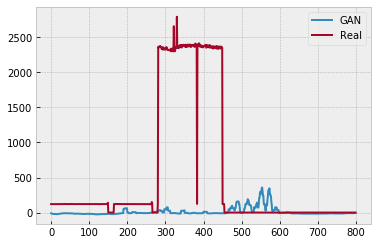

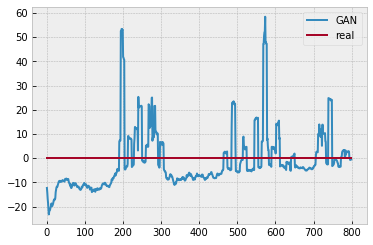

Batch_no: 17000  Epoch: 261


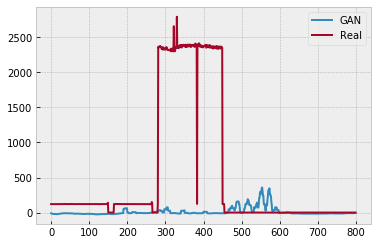

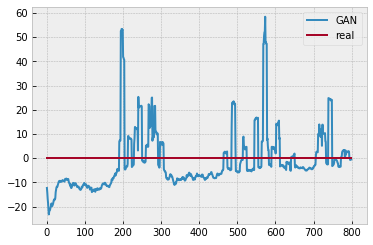

Batch_no: 17500  Epoch: 269


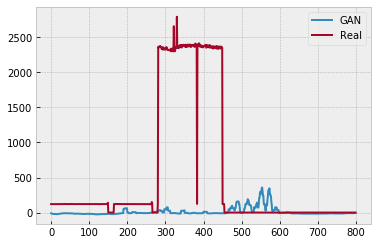

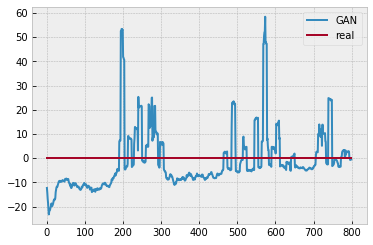

Batch_no: 18000  Epoch: 276


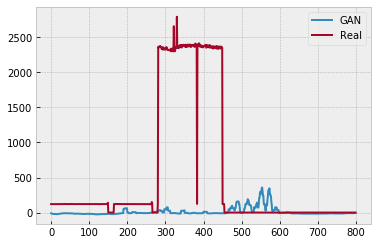

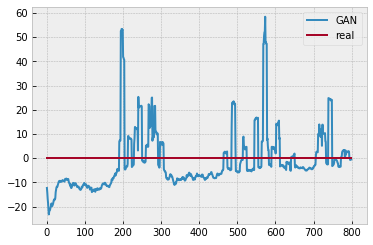

Batch_no: 18500  Epoch: 284


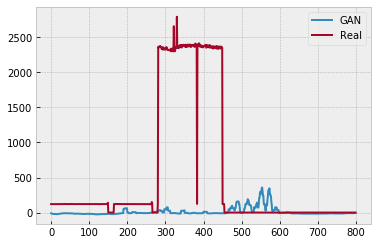

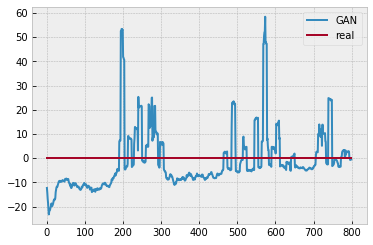

Batch_no: 19000  Epoch: 292


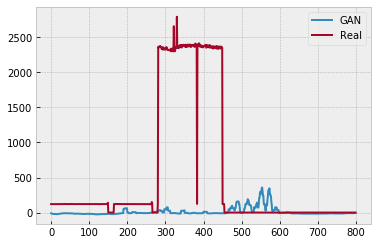

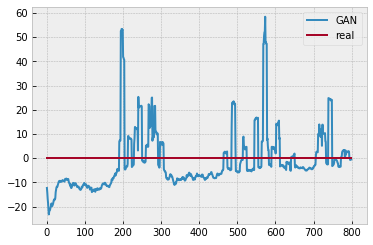

Batch_no: 19500  Epoch: 300


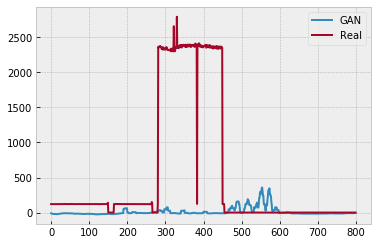

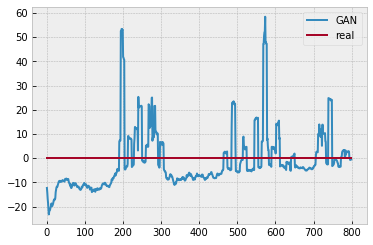

Batch_no: 20000  Epoch: 307


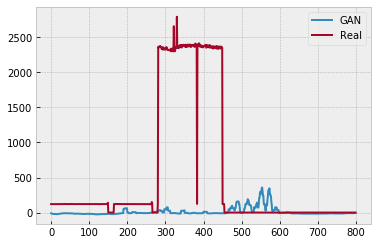

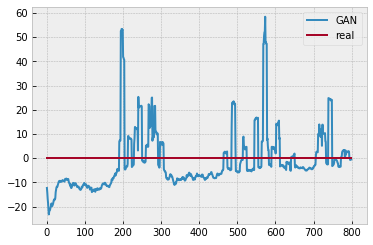

Batch_no: 20500  Epoch: 315


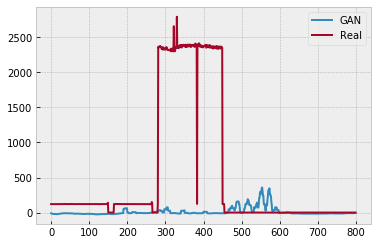

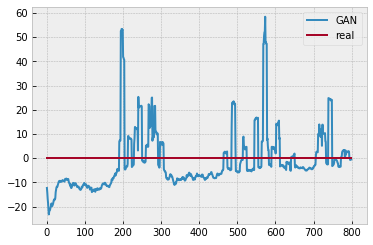

Batch_no: 21000  Epoch: 323


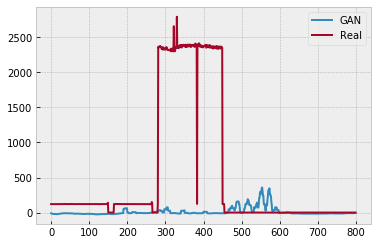

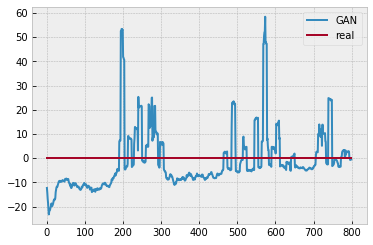

Batch_no: 21500  Epoch: 330


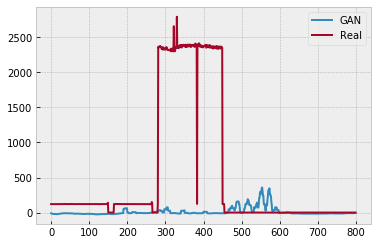

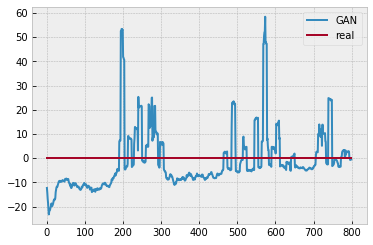

Batch_no: 22000  Epoch: 338


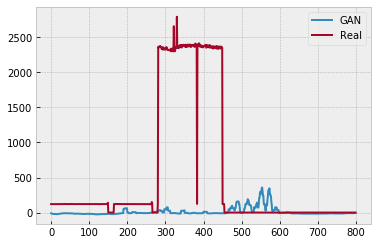

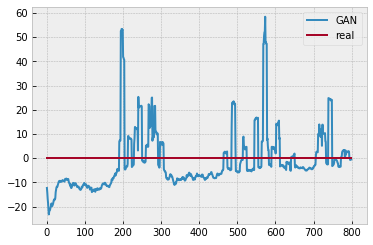

Batch_no: 22500  Epoch: 346


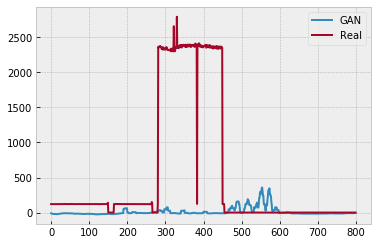

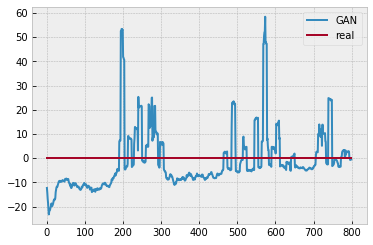

Batch_no: 23000  Epoch: 353


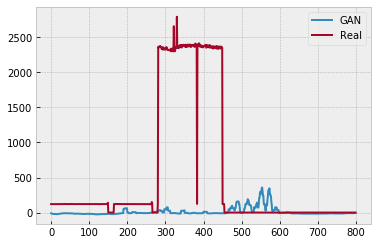

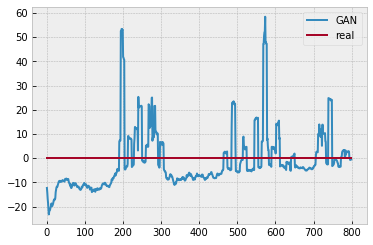

Batch_no: 23500  Epoch: 361


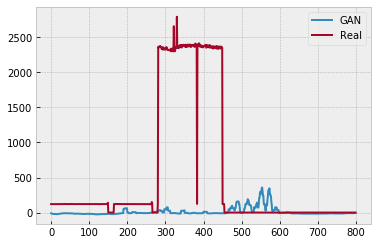

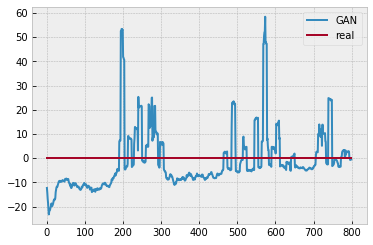

Batch_no: 24000  Epoch: 369


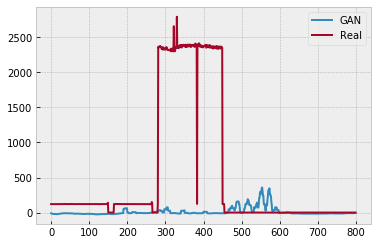

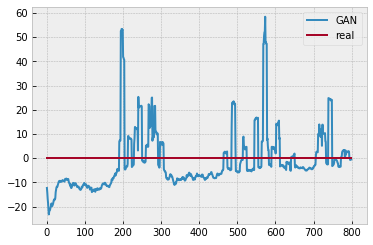

Batch_no: 24500  Epoch: 376


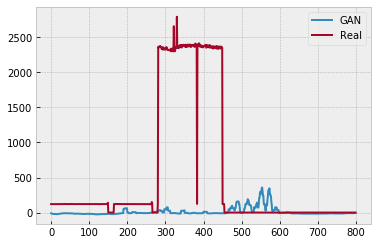

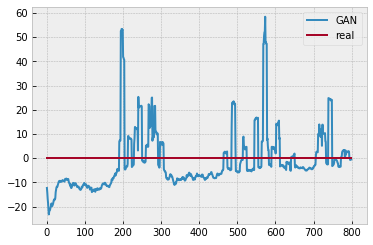

Batch_no: 25000  Epoch: 384


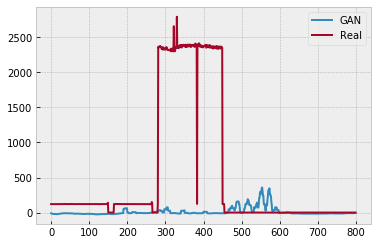

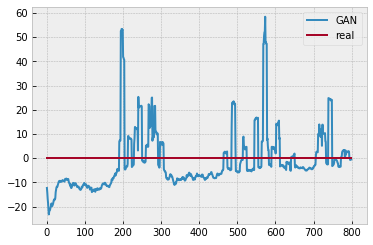

Batch_no: 25500  Epoch: 392


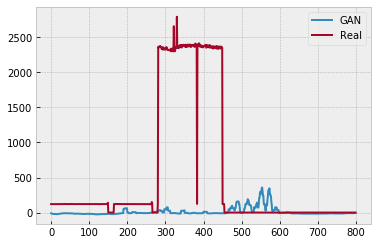

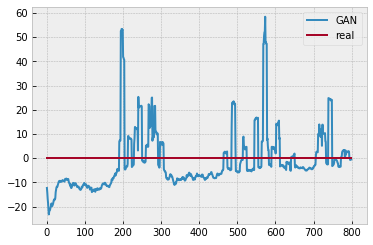

Batch_no: 26000  Epoch: 400


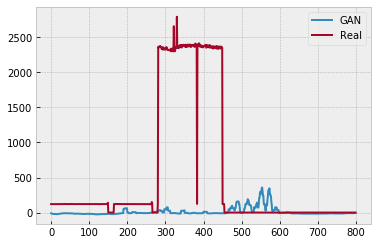

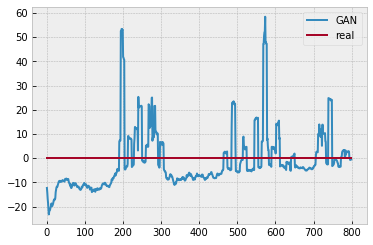

Batch_no: 26500  Epoch: 407


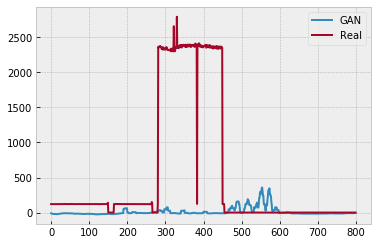

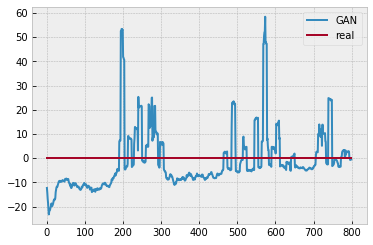

Batch_no: 27000  Epoch: 415


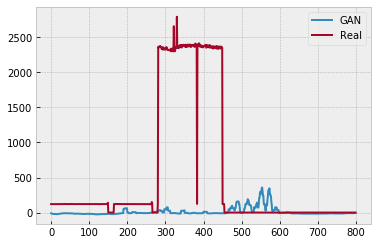

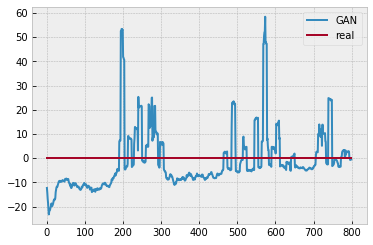

Batch_no: 27500  Epoch: 423


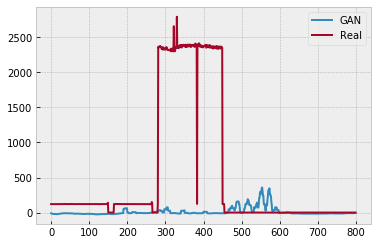

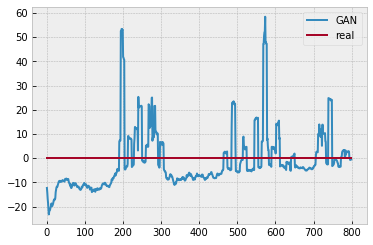

Batch_no: 28000  Epoch: 430


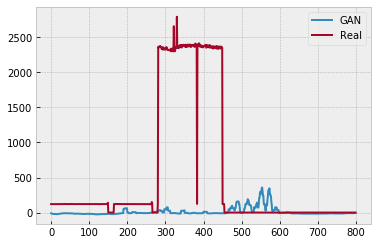

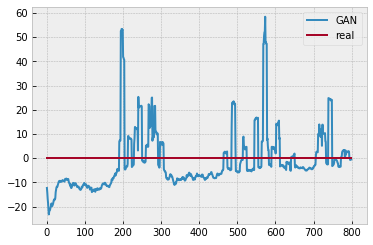

Batch_no: 28500  Epoch: 438


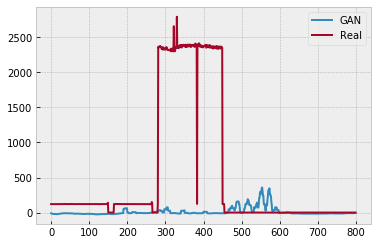

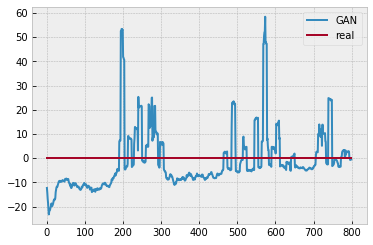

Batch_no: 29000  Epoch: 446


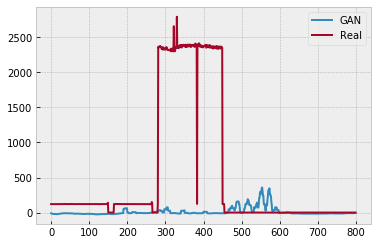

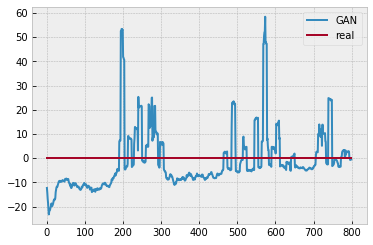

Batch_no: 29500  Epoch: 453


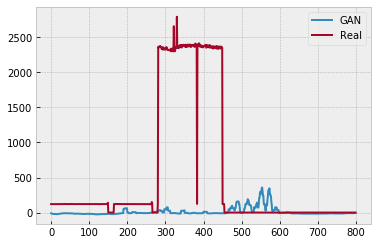

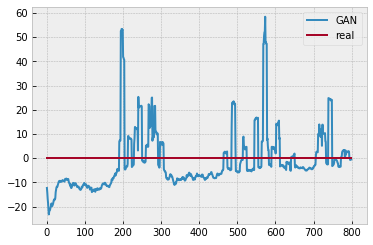

Batch_no: 30000  Epoch: 461


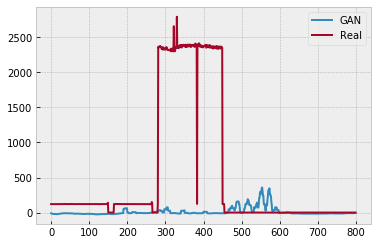

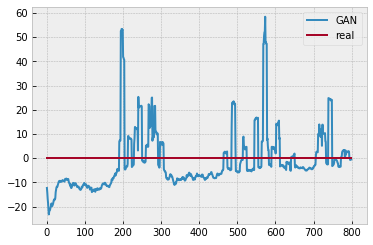

Batch_no: 30500  Epoch: 469


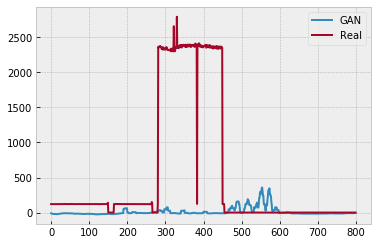

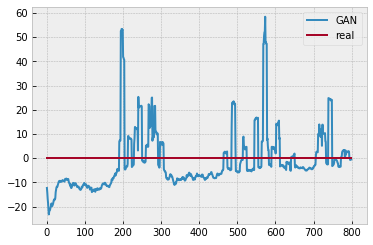

Batch_no: 31000  Epoch: 476


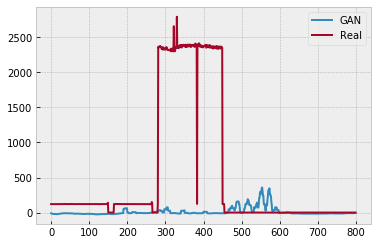

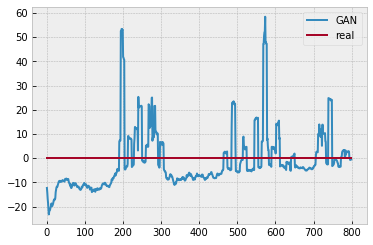

Batch_no: 31500  Epoch: 484


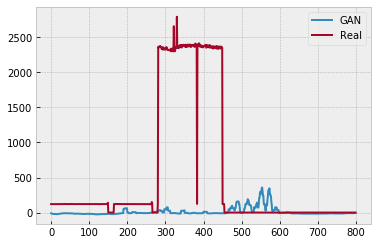

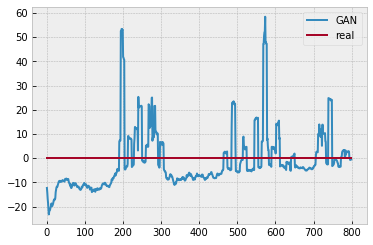

Batch_no: 32000  Epoch: 492


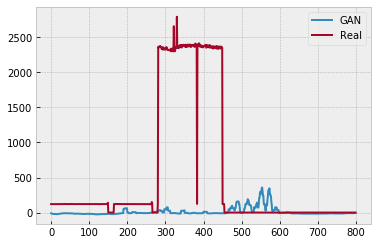

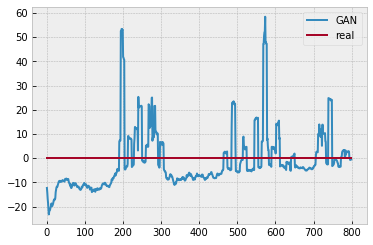

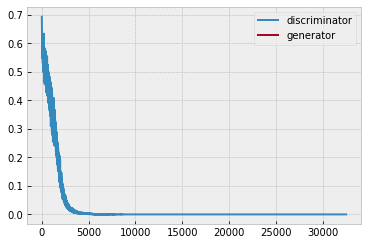

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['gxxx']
Smoothed..
recall= 0.168893, precision= 0.136717, F1= 0.151111, accuracy= 0.944609
RE=0.090065, MAE= 45.302814
g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are kept
g5 weights are kept
g6 weights are kept
g7 weights are kept
d1 weights are kept
d2 weights are kept
d3 weights are initialized
d4 weights are initialized
d5 weights are initialized
Batch_no: 0  Epoch: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:71: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


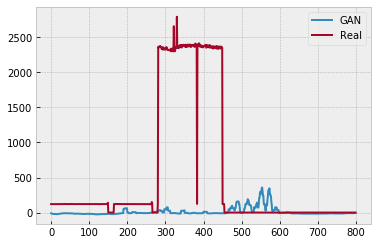

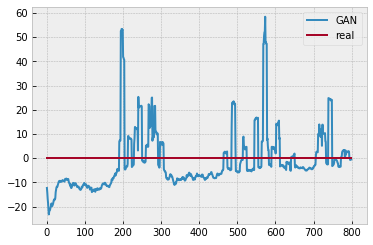

Batch_no: 500  Epoch: 7


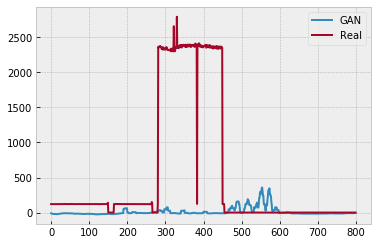

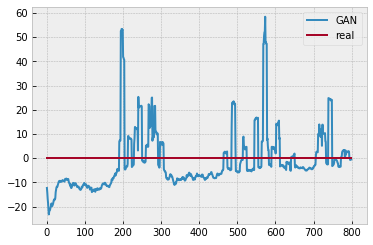

Batch_no: 1000  Epoch: 15


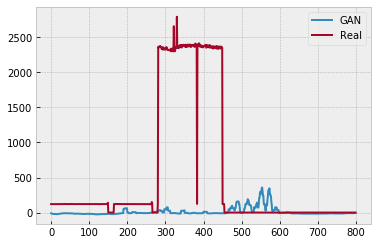

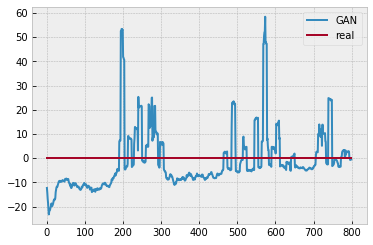

Batch_no: 1500  Epoch: 23


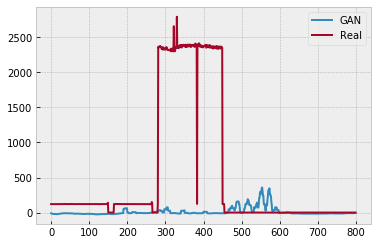

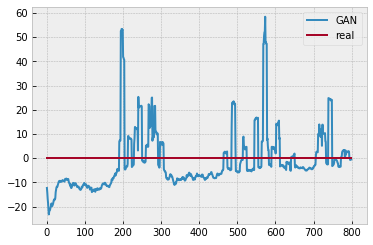

Batch_no: 2000  Epoch: 30


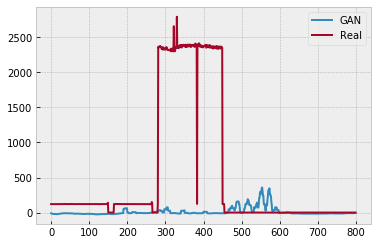

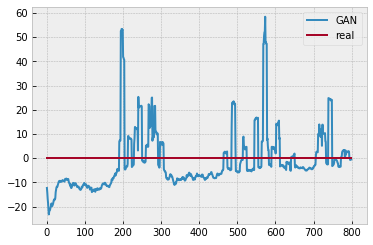

Batch_no: 2500  Epoch: 38


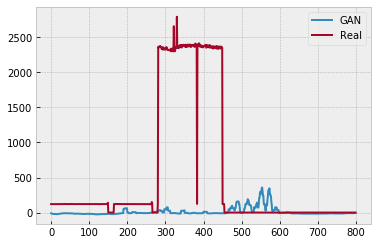

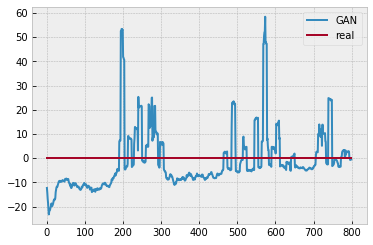

Batch_no: 3000  Epoch: 46


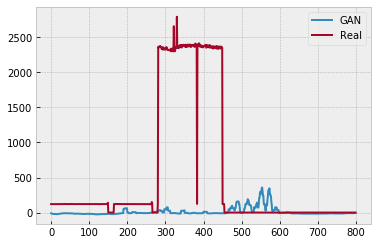

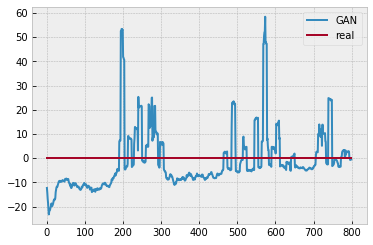

Batch_no: 3500  Epoch: 53


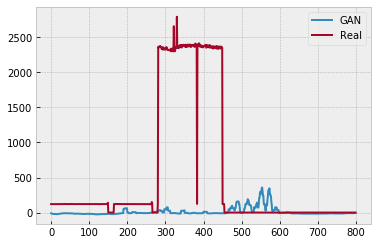

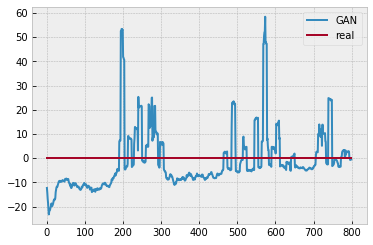

Batch_no: 4000  Epoch: 61


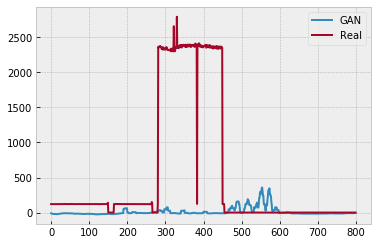

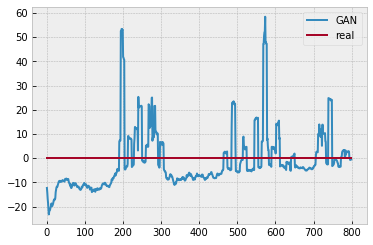

Batch_no: 4500  Epoch: 69


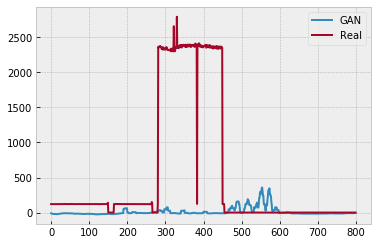

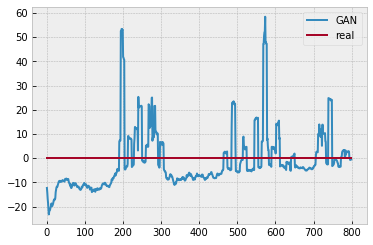

Batch_no: 5000  Epoch: 76


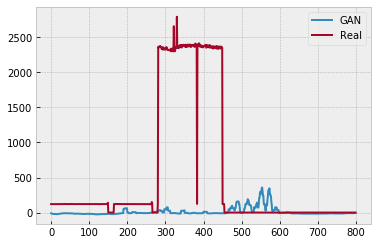

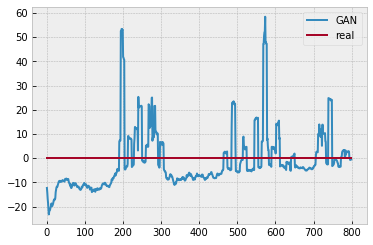

Batch_no: 5500  Epoch: 84


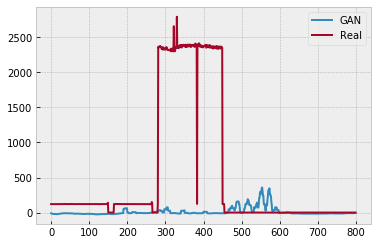

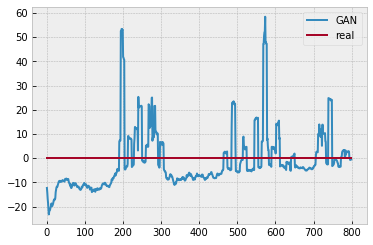

Batch_no: 6000  Epoch: 92


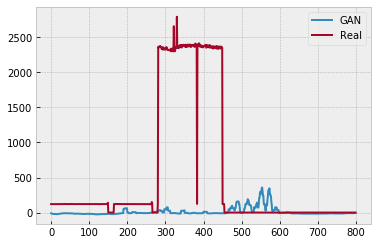

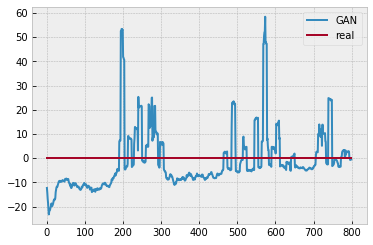

Batch_no: 6500  Epoch: 100


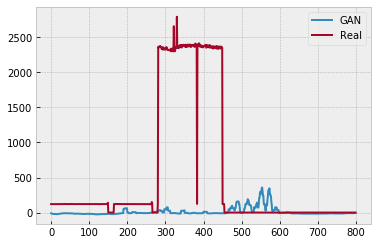

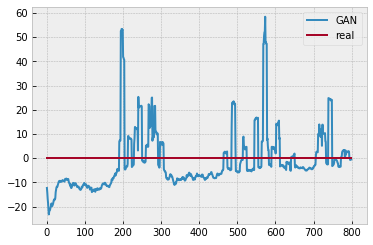

Batch_no: 7000  Epoch: 107


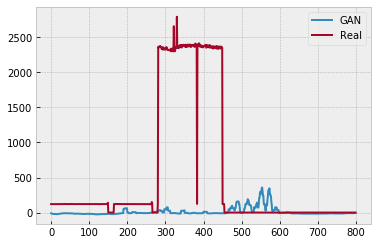

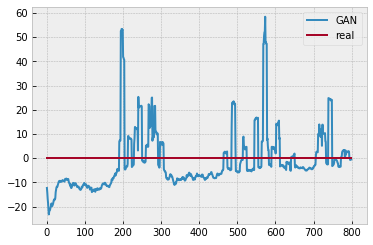

Batch_no: 7500  Epoch: 115


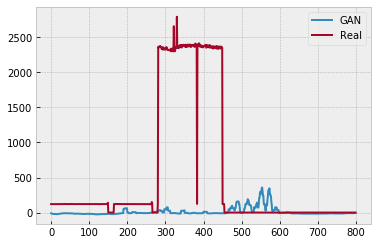

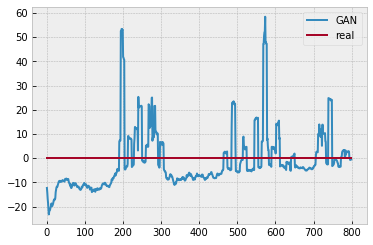

Batch_no: 8000  Epoch: 123


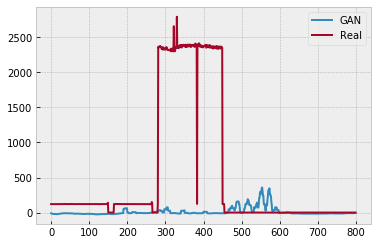

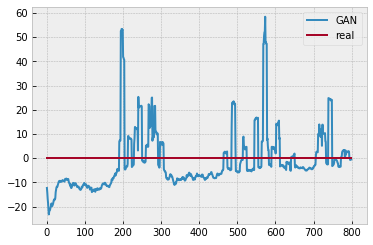

Batch_no: 8500  Epoch: 130


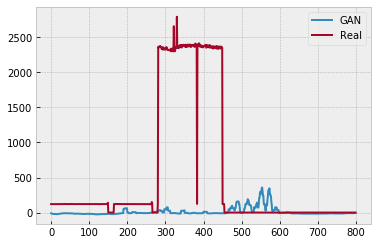

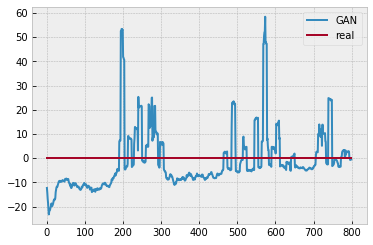

Batch_no: 9000  Epoch: 138


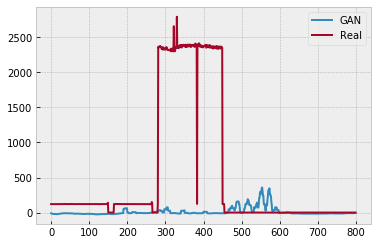

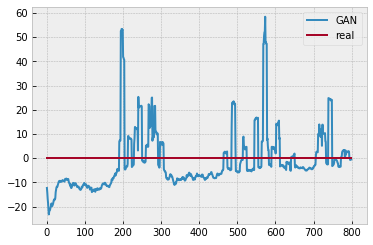

Batch_no: 9500  Epoch: 146


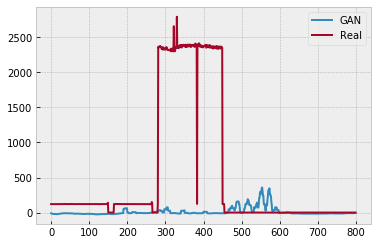

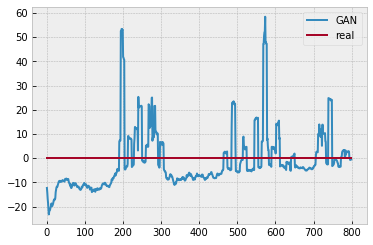

Batch_no: 10000  Epoch: 153


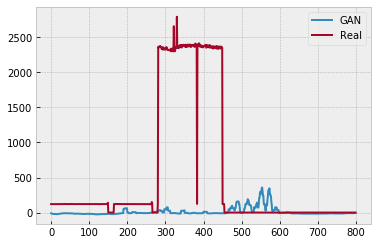

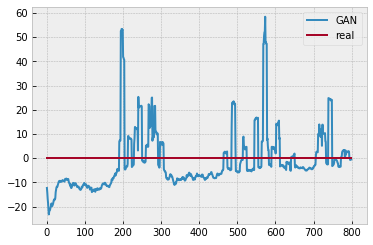

Batch_no: 10500  Epoch: 161


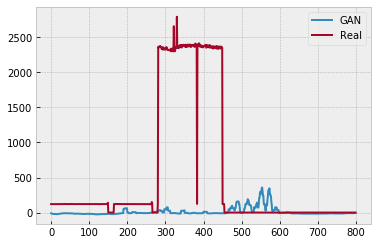

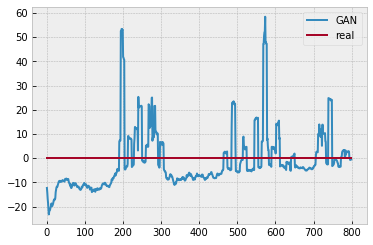

Batch_no: 11000  Epoch: 169


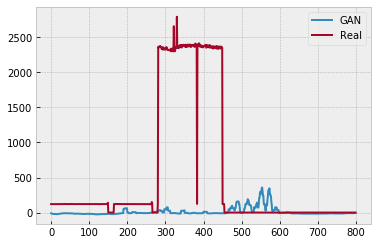

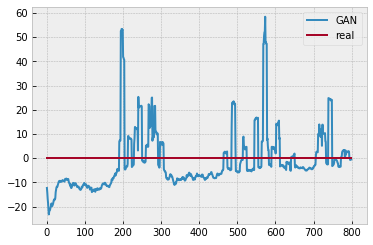

Batch_no: 11500  Epoch: 176


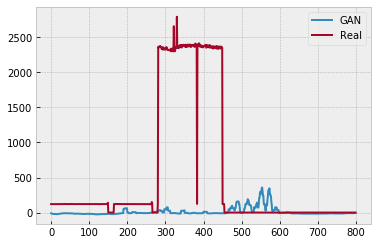

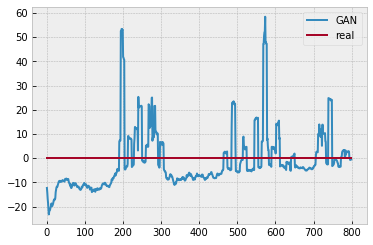

Batch_no: 12000  Epoch: 184


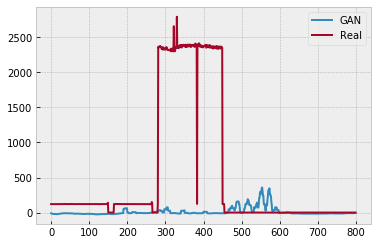

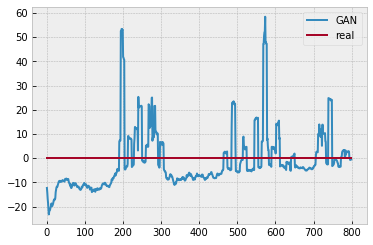

Batch_no: 12500  Epoch: 192


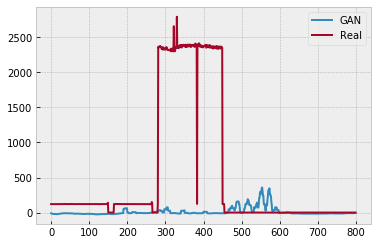

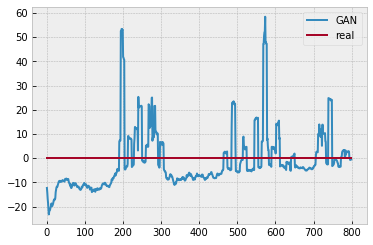

Batch_no: 13000  Epoch: 200


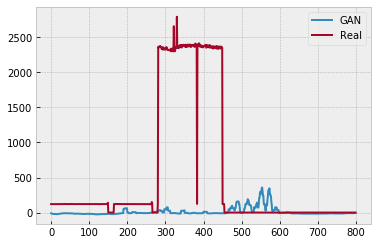

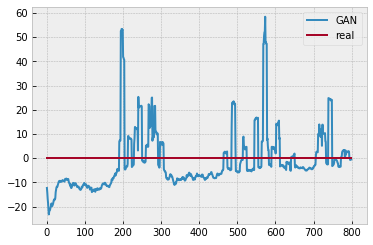

Batch_no: 13500  Epoch: 207


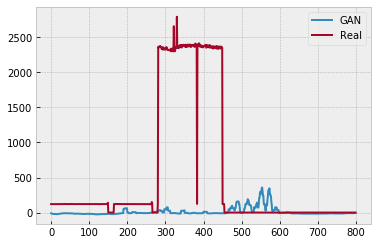

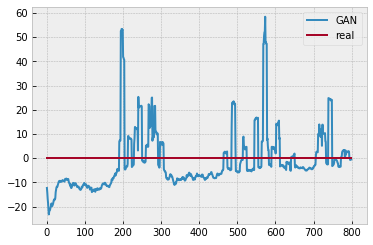

Batch_no: 14000  Epoch: 215


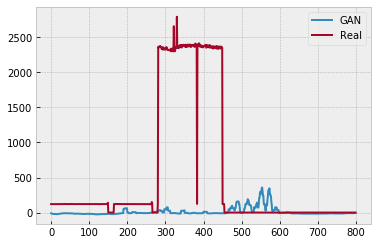

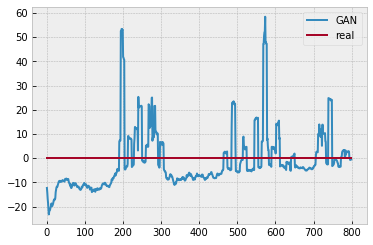

Batch_no: 14500  Epoch: 223


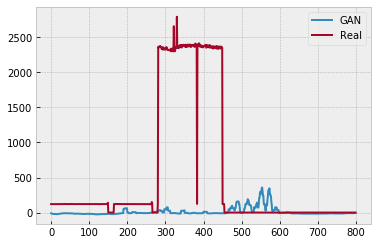

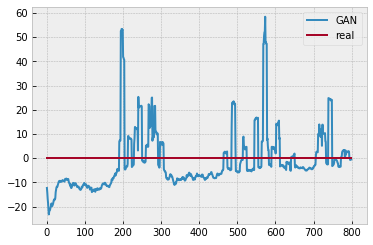

Batch_no: 15000  Epoch: 230


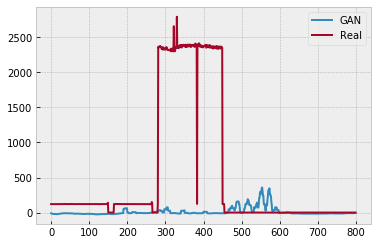

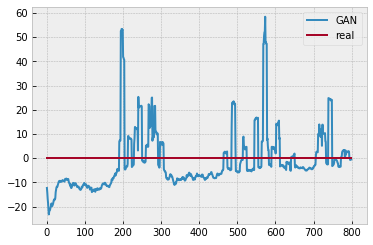

Batch_no: 15500  Epoch: 238


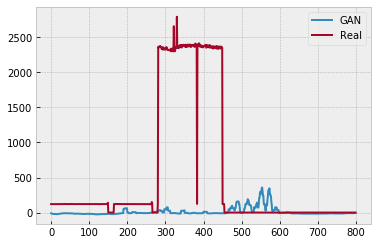

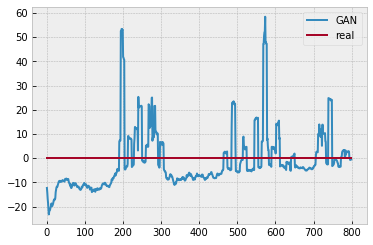

Batch_no: 16000  Epoch: 246


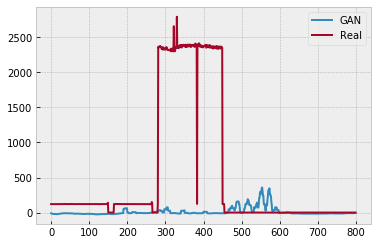

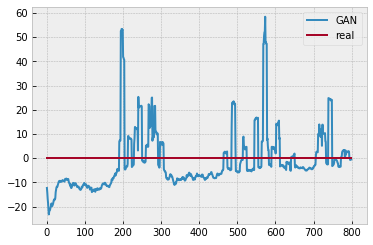

Batch_no: 16500  Epoch: 253


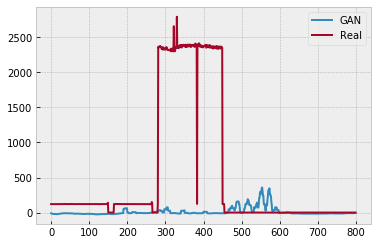

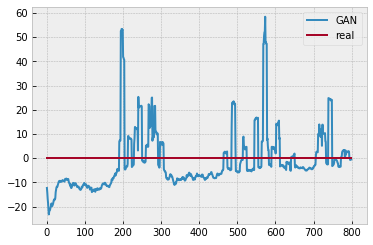

Batch_no: 17000  Epoch: 261


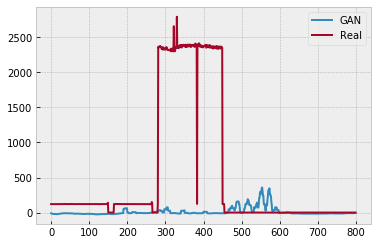

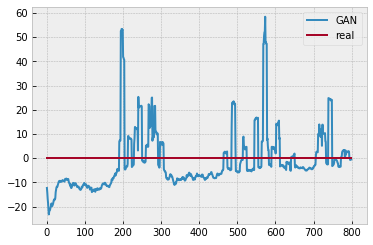

Batch_no: 17500  Epoch: 269


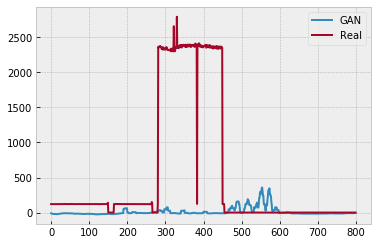

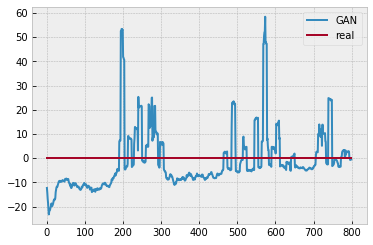

Batch_no: 18000  Epoch: 276


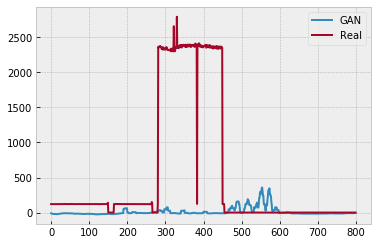

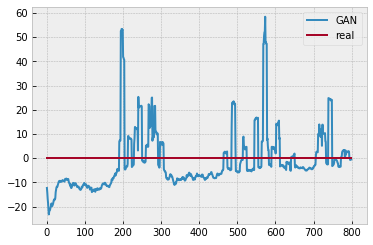

Batch_no: 18500  Epoch: 284


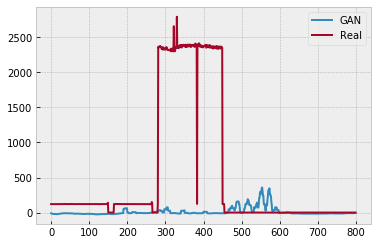

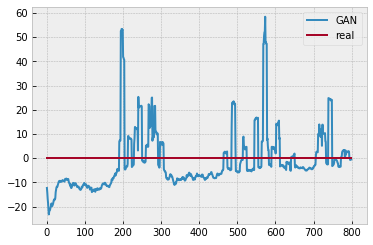

Batch_no: 19000  Epoch: 292


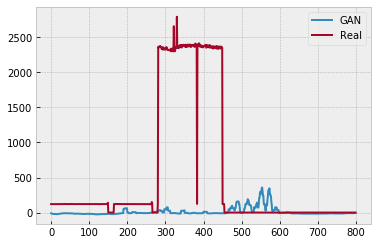

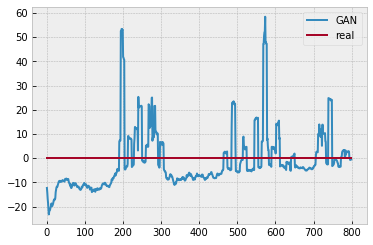

Batch_no: 19500  Epoch: 300


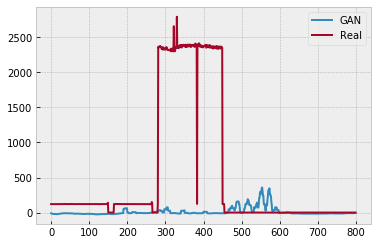

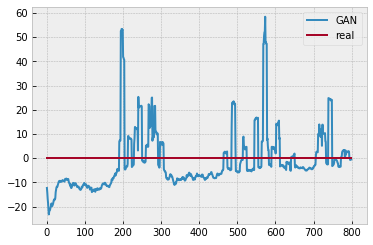

Batch_no: 20000  Epoch: 307


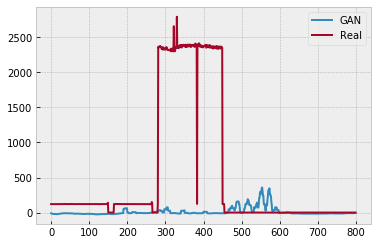

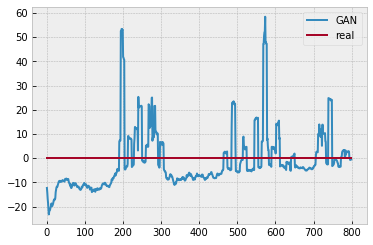

Batch_no: 20500  Epoch: 315


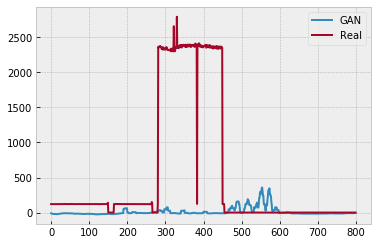

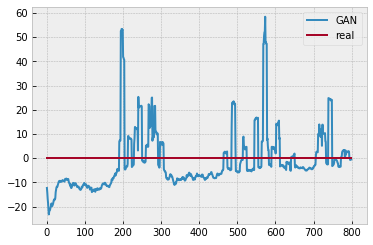

Batch_no: 21000  Epoch: 323


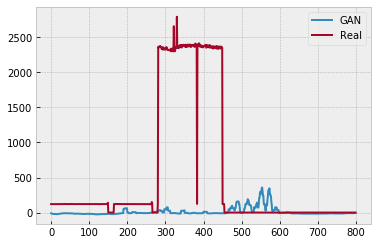

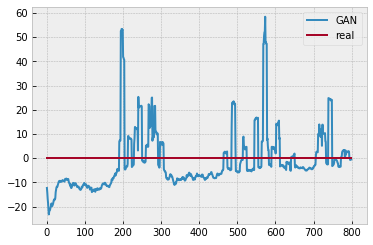

Batch_no: 21500  Epoch: 330


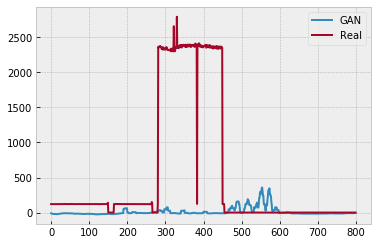

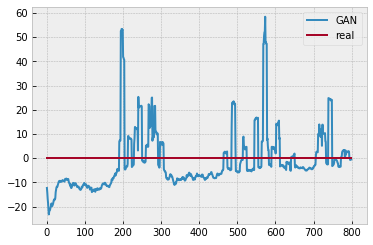

Batch_no: 22000  Epoch: 338


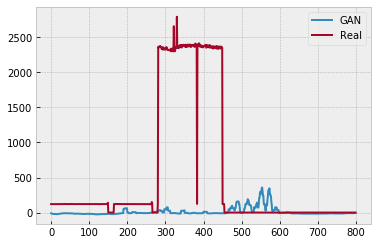

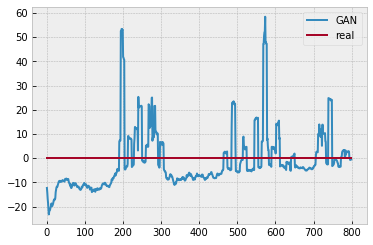

Batch_no: 22500  Epoch: 346


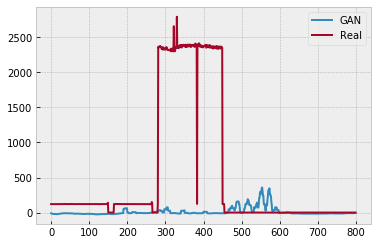

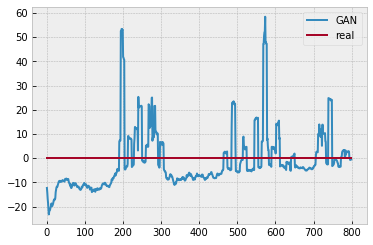

Batch_no: 23000  Epoch: 353


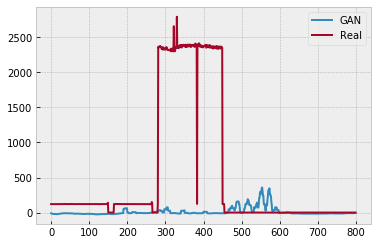

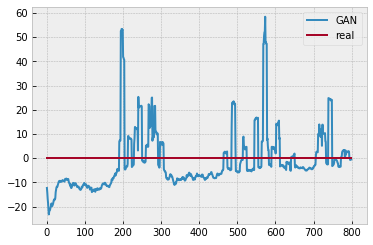

Batch_no: 23500  Epoch: 361


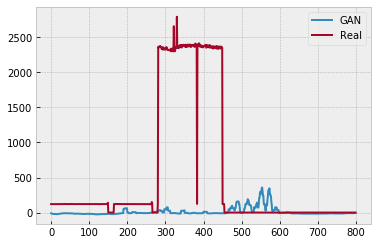

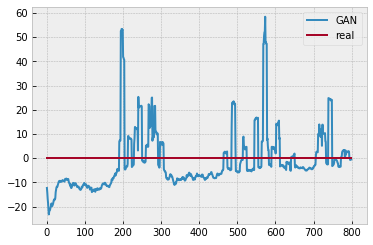

Batch_no: 24000  Epoch: 369


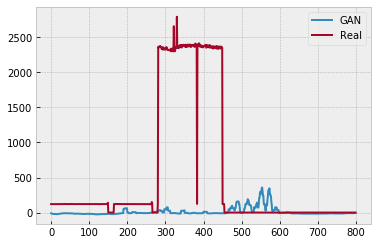

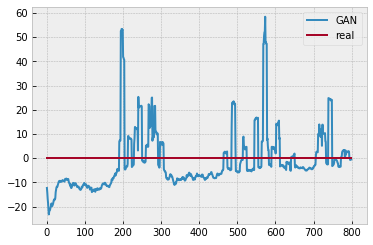

Batch_no: 24500  Epoch: 376


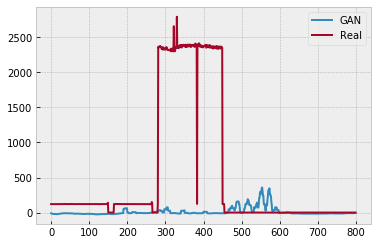

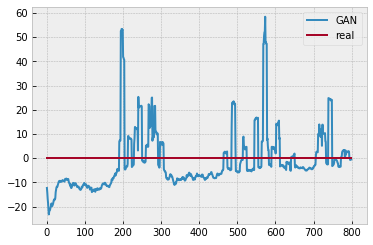

Batch_no: 25000  Epoch: 384


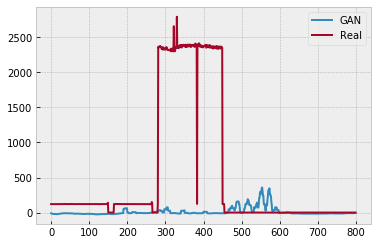

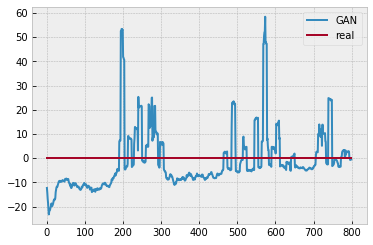

Batch_no: 25500  Epoch: 392


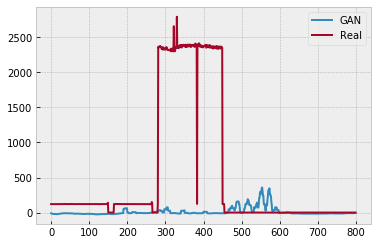

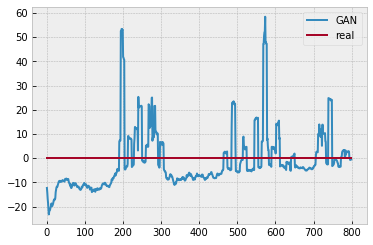

Batch_no: 26000  Epoch: 400


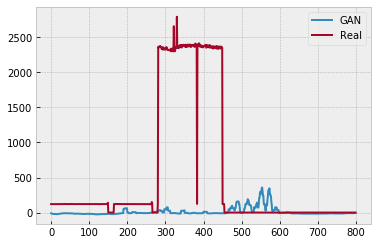

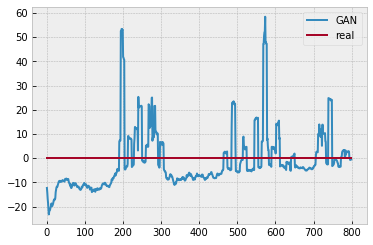

Batch_no: 26500  Epoch: 407


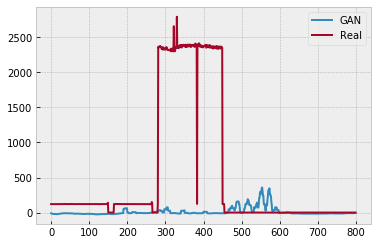

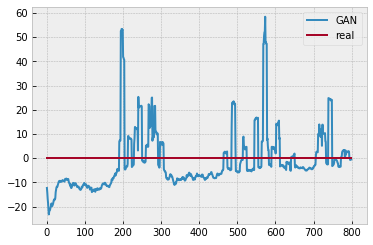

Batch_no: 27000  Epoch: 415


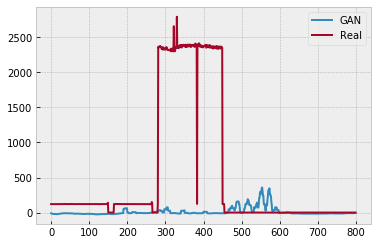

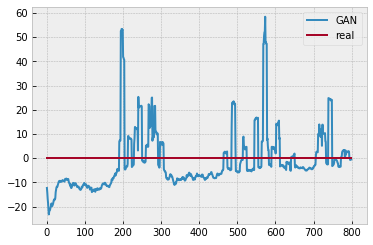

Batch_no: 27500  Epoch: 423


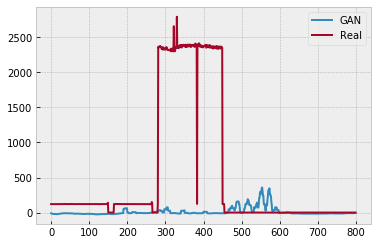

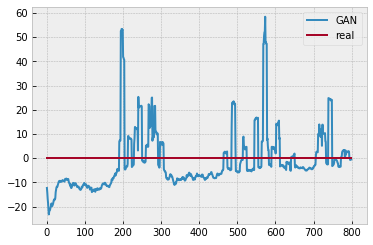

Batch_no: 28000  Epoch: 430


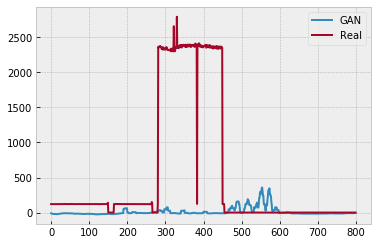

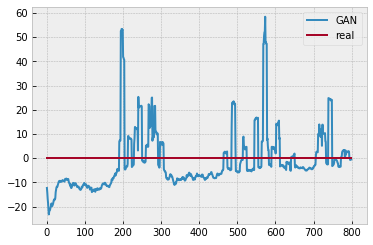

Batch_no: 28500  Epoch: 438


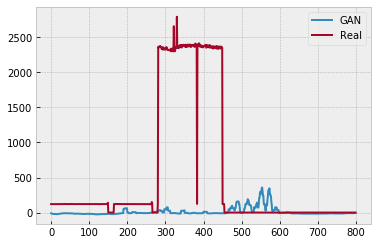

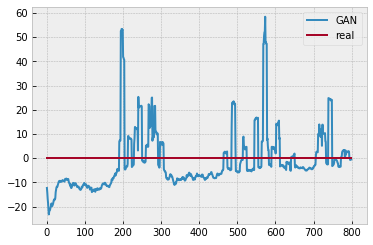

Batch_no: 29000  Epoch: 446


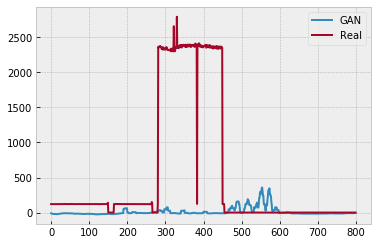

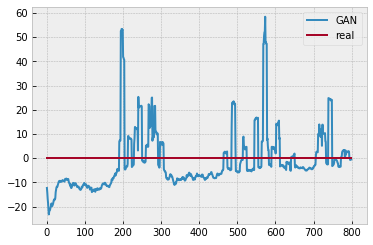

Batch_no: 29500  Epoch: 453


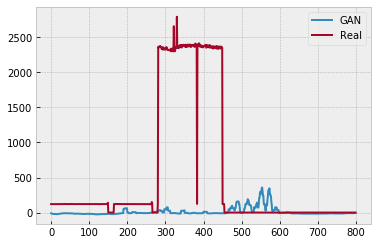

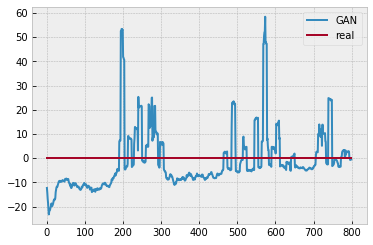

Batch_no: 30000  Epoch: 461


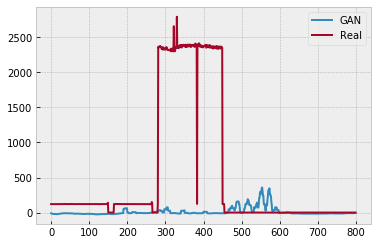

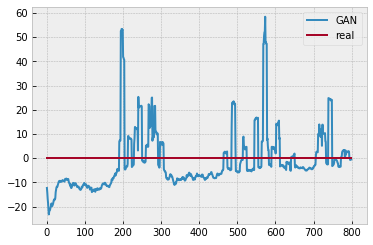

Batch_no: 30500  Epoch: 469


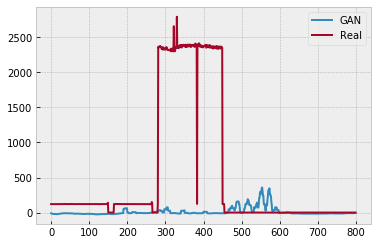

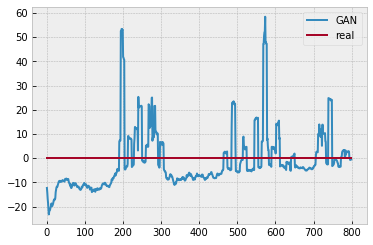

Batch_no: 31000  Epoch: 476


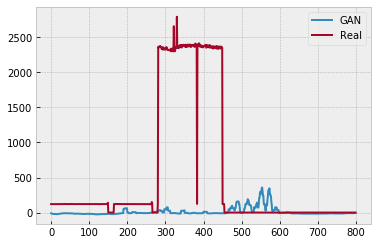

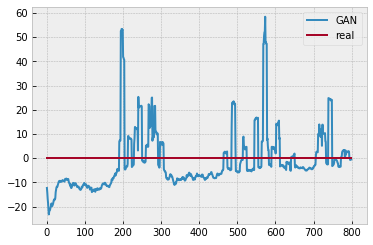

Batch_no: 31500  Epoch: 484


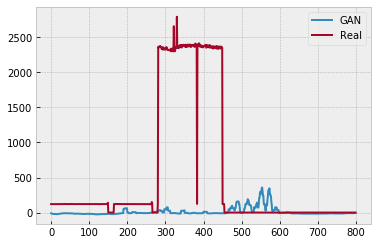

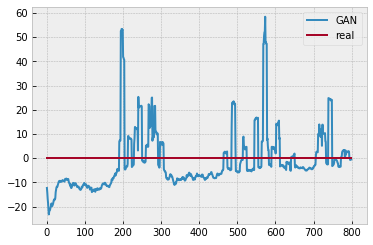

Batch_no: 32000  Epoch: 492


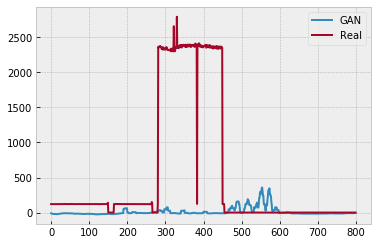

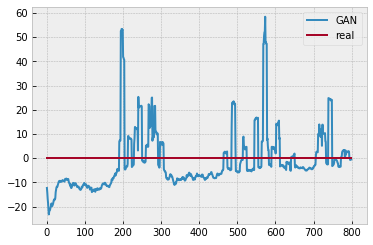

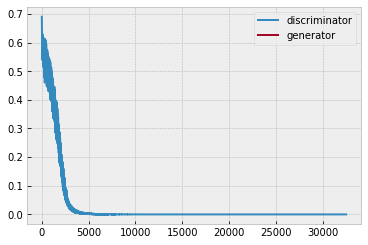

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['gxxx']
Smoothed..
recall= 0.179514, precision= 0.145880, F1= 0.160958, accuracy= 0.945369
RE=0.035813, MAE= 43.298357
g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are kept
g5 weights are kept
g6 weights are kept
g7 weights are kept
d1 weights are kept
d2 weights are kept
d3 weights are kept
d4 weights are initialized
d5 weights are initialized
Batch_no: 0  Epoch: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:71: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


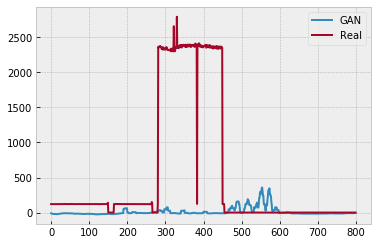

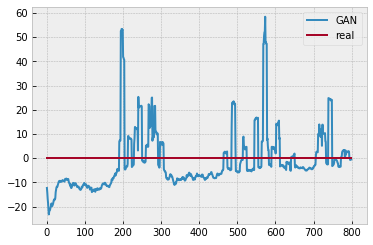

Batch_no: 500  Epoch: 7


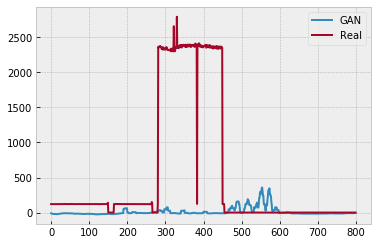

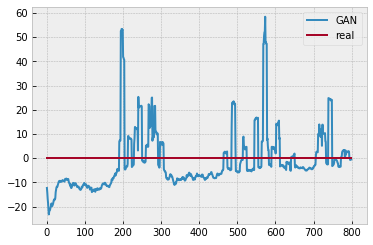

Batch_no: 1000  Epoch: 15


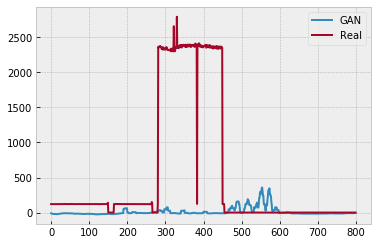

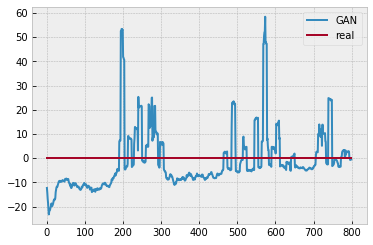

Batch_no: 1500  Epoch: 23


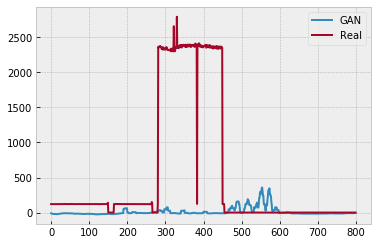

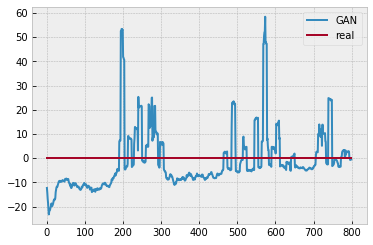

Batch_no: 2000  Epoch: 30


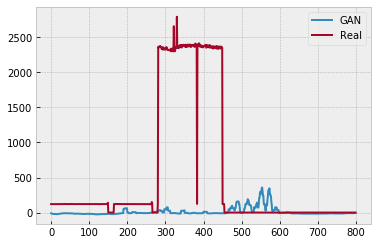

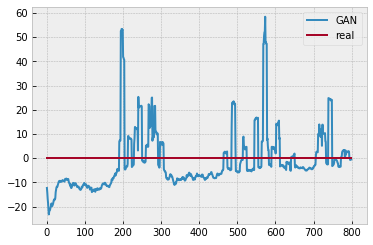

Batch_no: 2500  Epoch: 38


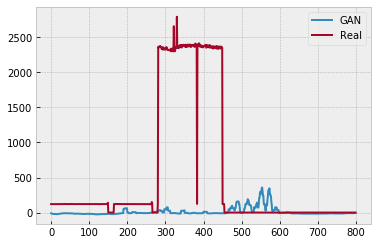

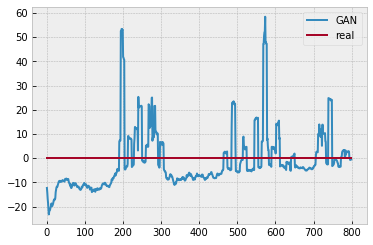

Batch_no: 3000  Epoch: 46


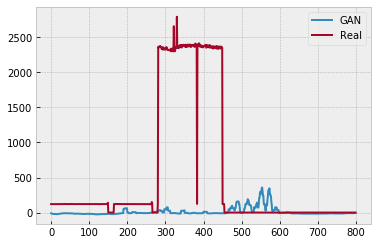

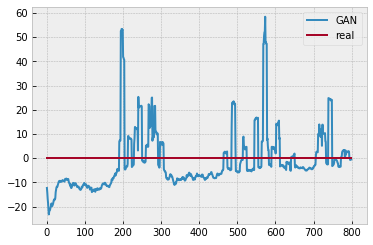

Batch_no: 3500  Epoch: 53


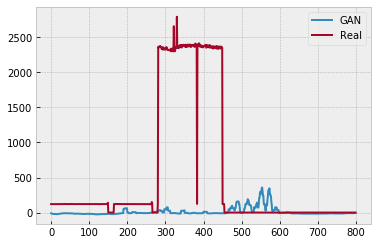

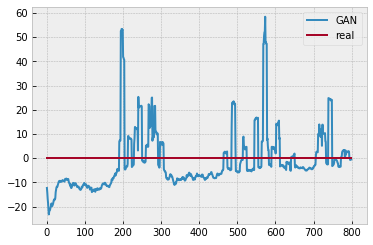

Batch_no: 4000  Epoch: 61


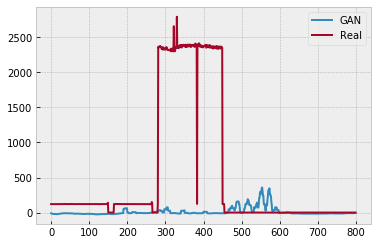

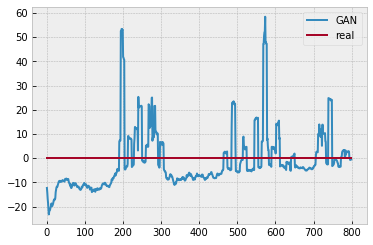

Batch_no: 4500  Epoch: 69


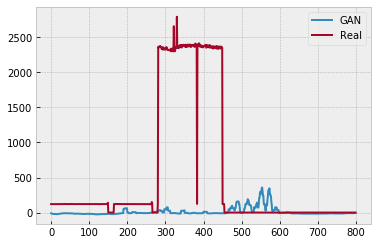

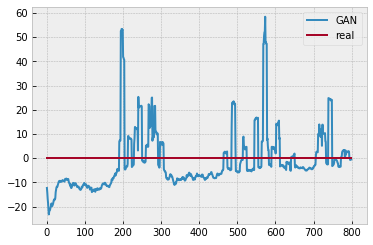

Batch_no: 5000  Epoch: 76


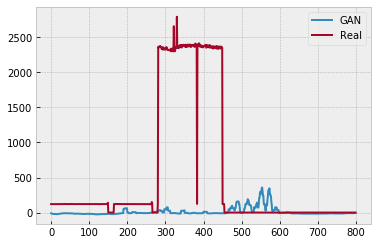

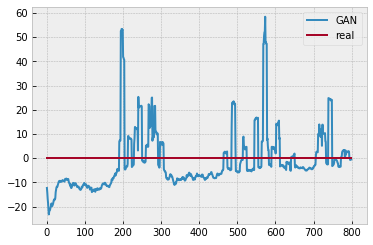

Batch_no: 5500  Epoch: 84


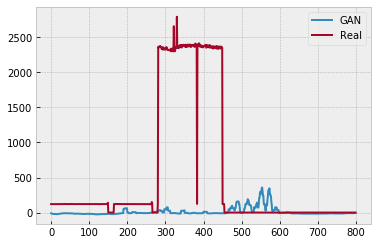

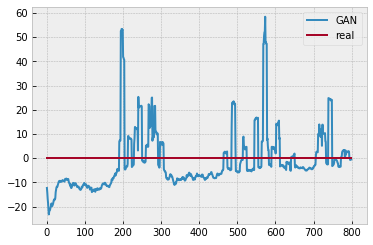

Batch_no: 6000  Epoch: 92


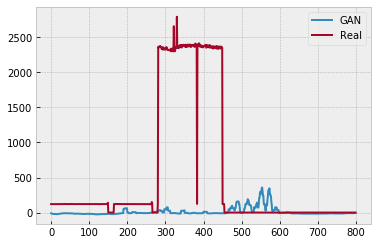

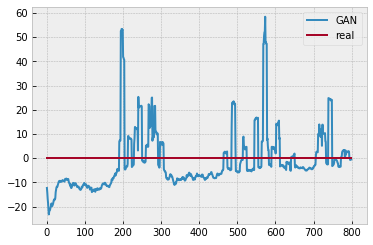

Batch_no: 6500  Epoch: 100


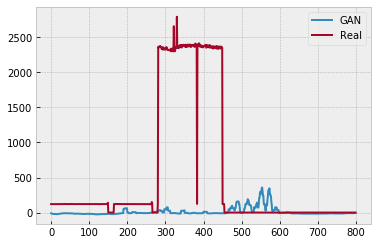

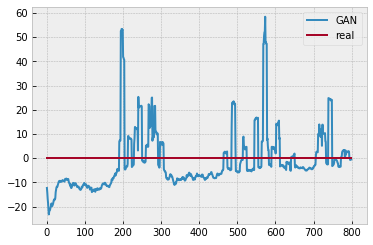

Batch_no: 7000  Epoch: 107


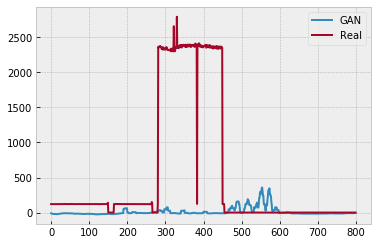

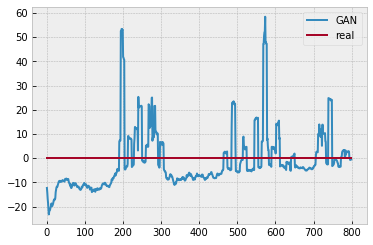

Batch_no: 7500  Epoch: 115


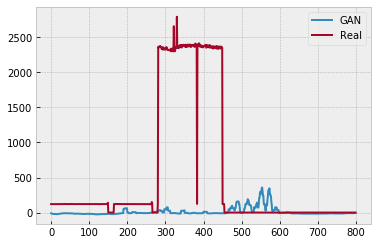

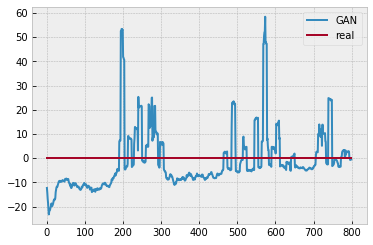

Batch_no: 8000  Epoch: 123


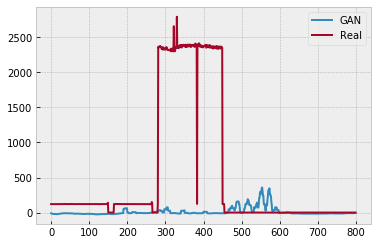

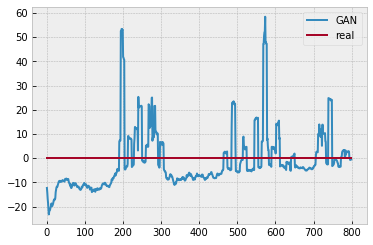

Batch_no: 8500  Epoch: 130


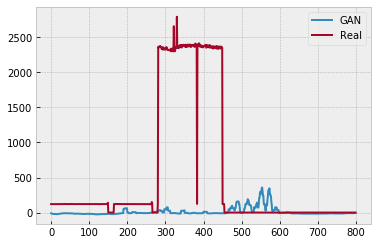

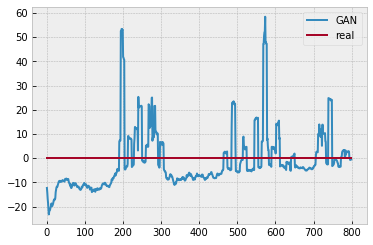

Batch_no: 9000  Epoch: 138


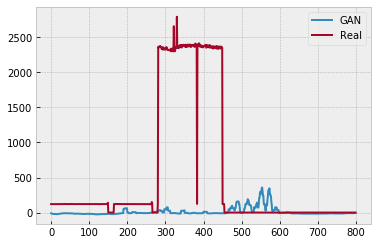

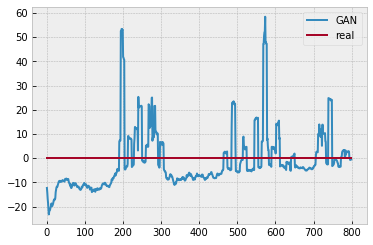

Batch_no: 9500  Epoch: 146


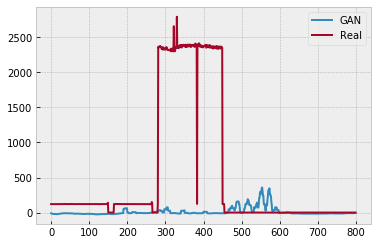

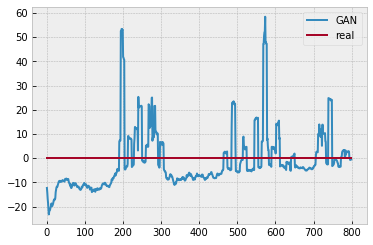

Batch_no: 10000  Epoch: 153


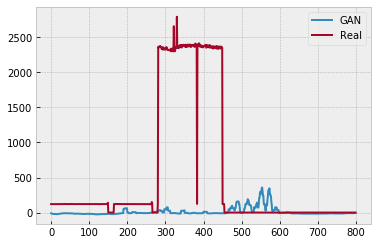

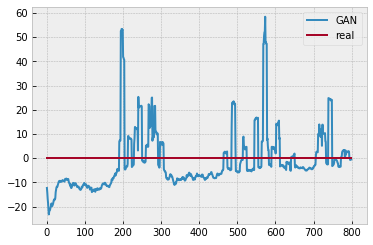

Batch_no: 10500  Epoch: 161


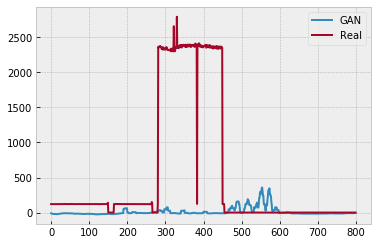

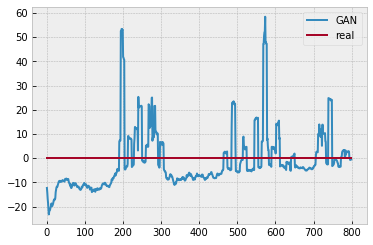

Batch_no: 11000  Epoch: 169


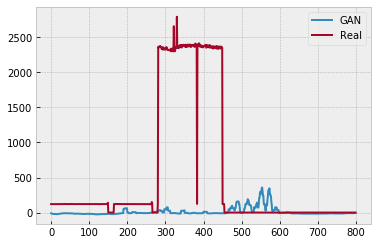

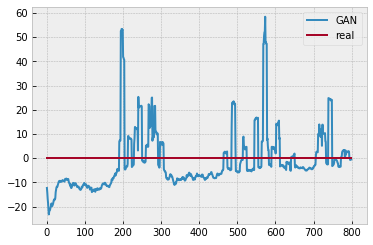

Batch_no: 11500  Epoch: 176


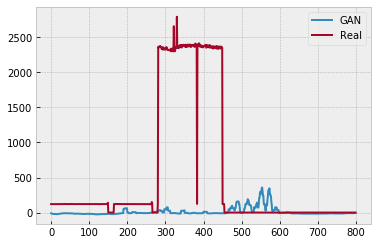

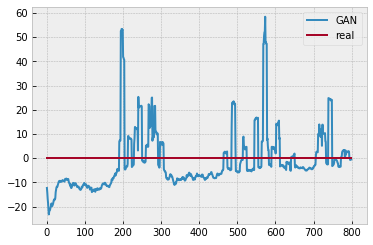

Batch_no: 12000  Epoch: 184


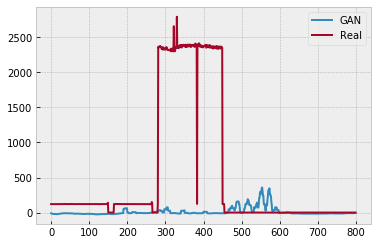

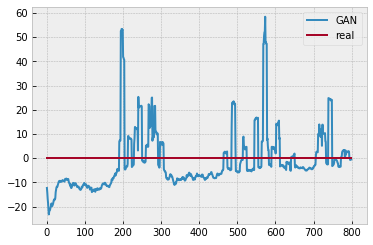

Batch_no: 12500  Epoch: 192


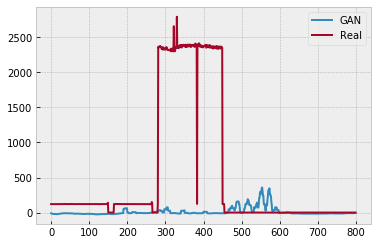

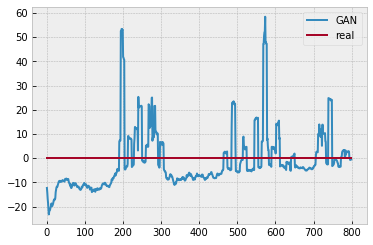

Batch_no: 13000  Epoch: 200


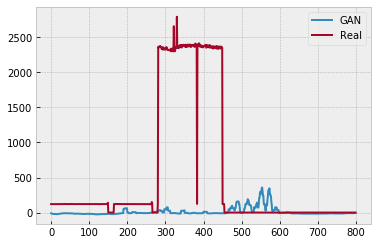

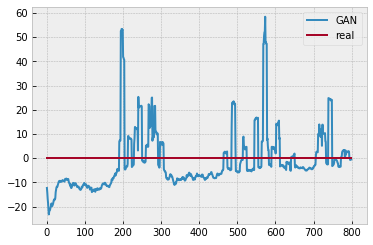

Batch_no: 13500  Epoch: 207


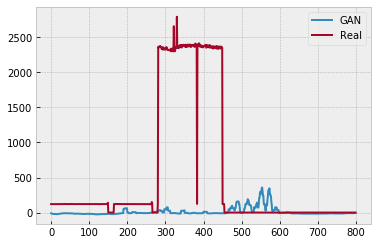

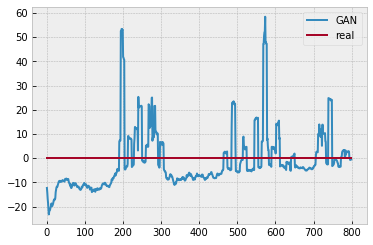

Batch_no: 14000  Epoch: 215


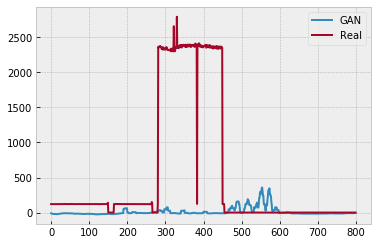

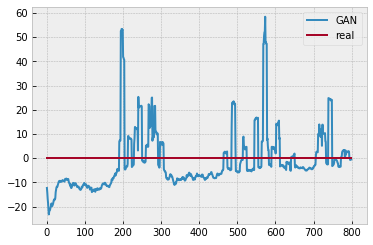

Batch_no: 14500  Epoch: 223


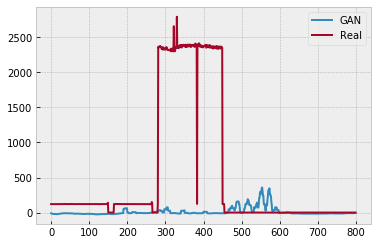

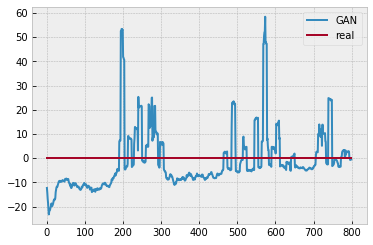

Batch_no: 15000  Epoch: 230


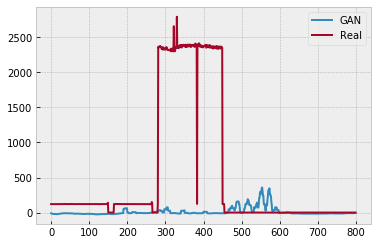

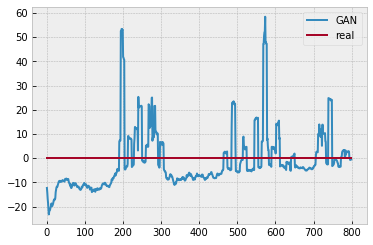

Batch_no: 15500  Epoch: 238


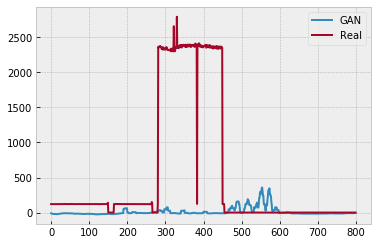

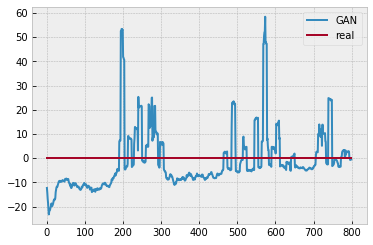

Batch_no: 16000  Epoch: 246


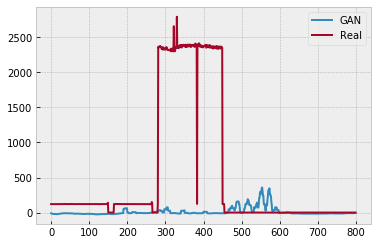

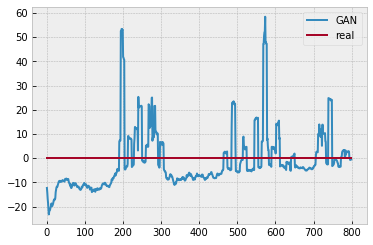

Batch_no: 16500  Epoch: 253


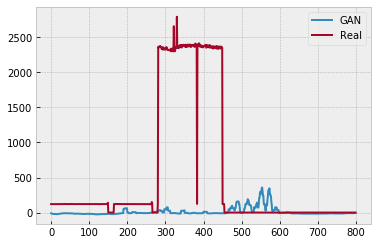

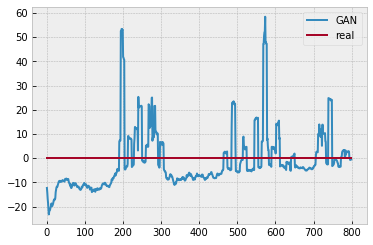

Batch_no: 17000  Epoch: 261


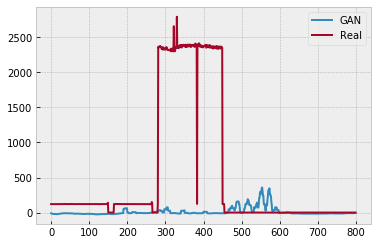

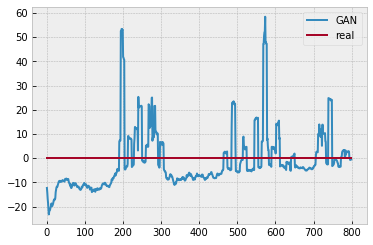

Batch_no: 17500  Epoch: 269


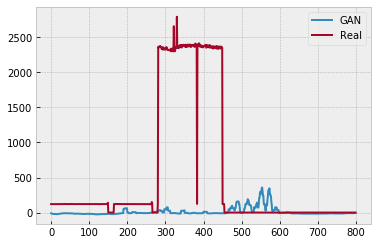

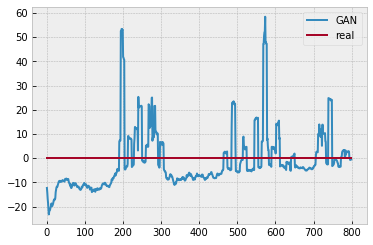

Batch_no: 18000  Epoch: 276


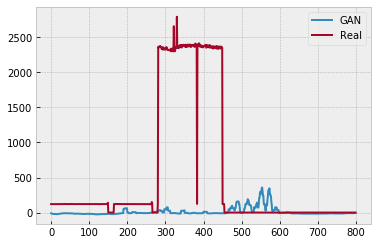

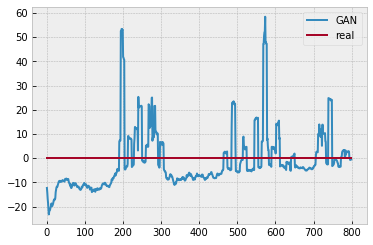

Batch_no: 18500  Epoch: 284


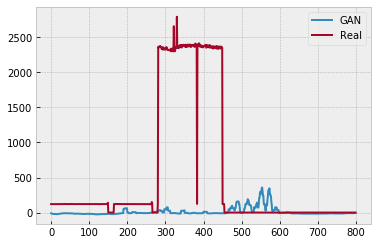

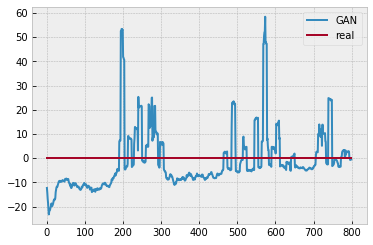

Batch_no: 19000  Epoch: 292


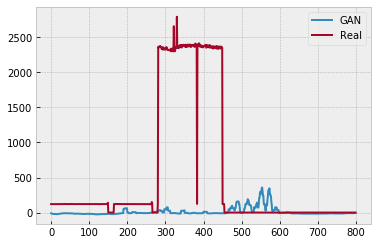

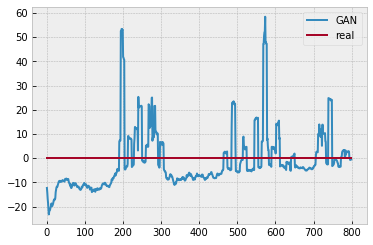

Batch_no: 19500  Epoch: 300


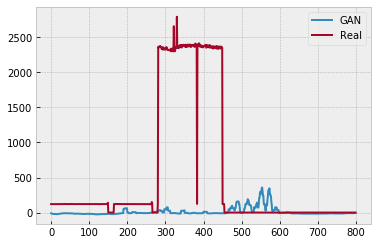

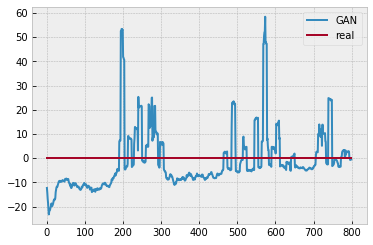

Batch_no: 20000  Epoch: 307


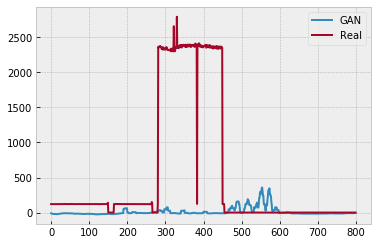

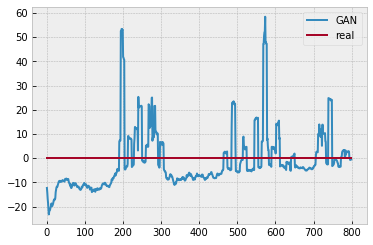

Batch_no: 20500  Epoch: 315


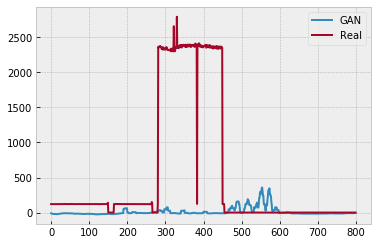

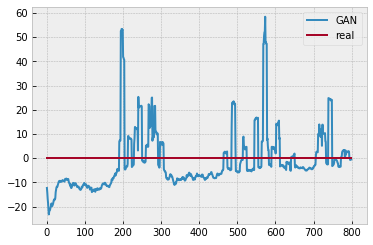

Batch_no: 21000  Epoch: 323


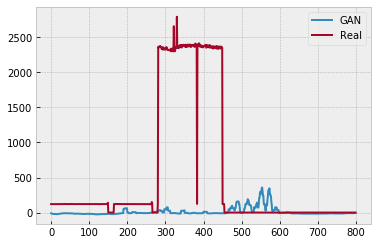

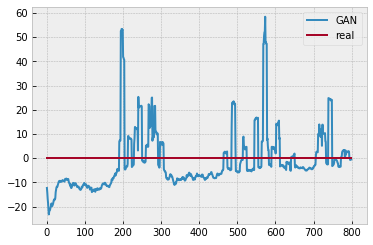

Batch_no: 21500  Epoch: 330


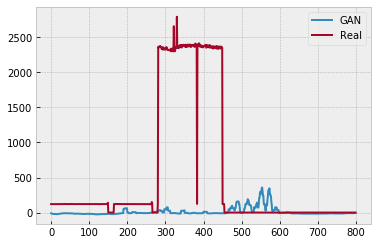

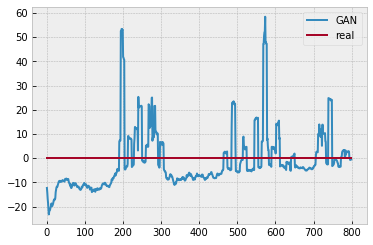

Batch_no: 22000  Epoch: 338


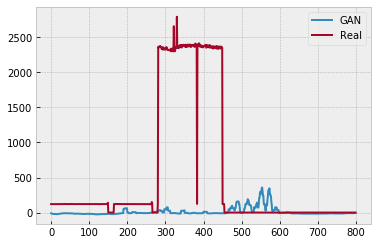

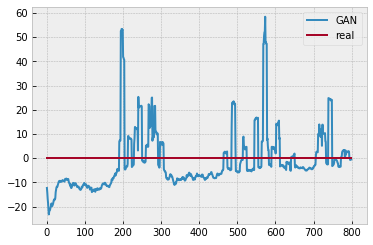

Batch_no: 22500  Epoch: 346


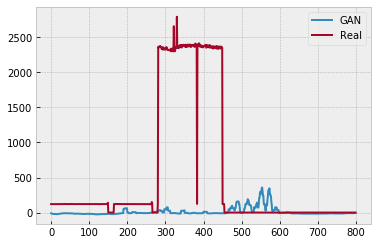

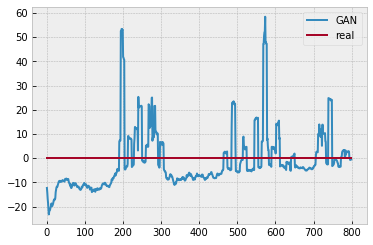

Batch_no: 23000  Epoch: 353


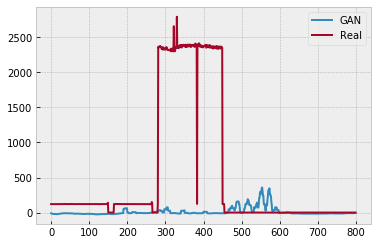

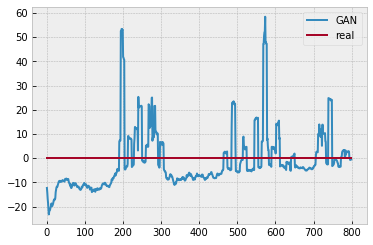

Batch_no: 23500  Epoch: 361


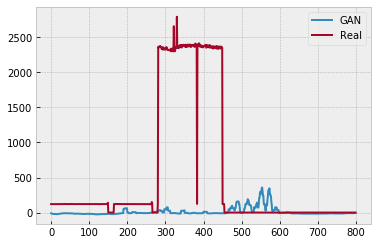

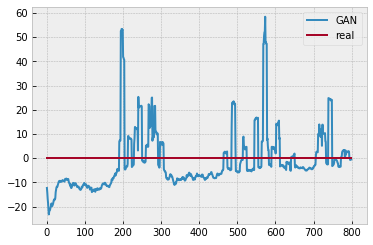

Batch_no: 24000  Epoch: 369


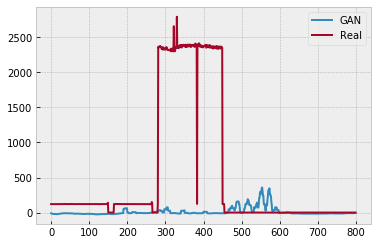

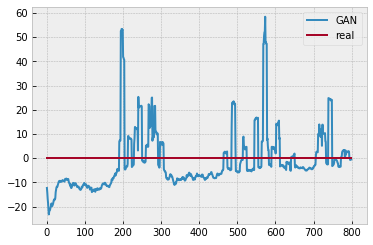

Batch_no: 24500  Epoch: 376


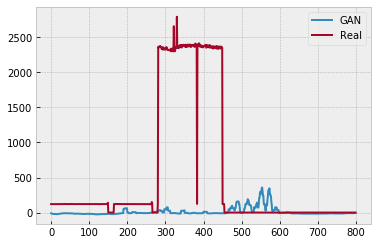

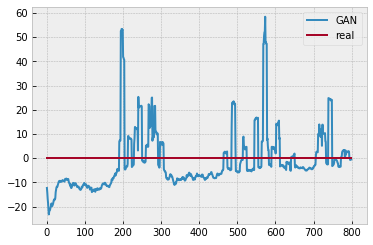

Batch_no: 25000  Epoch: 384


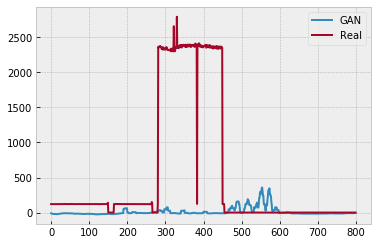

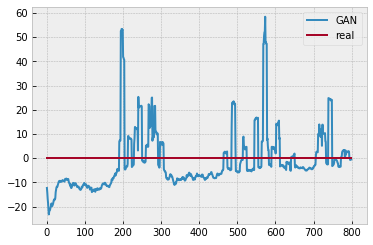

Batch_no: 25500  Epoch: 392


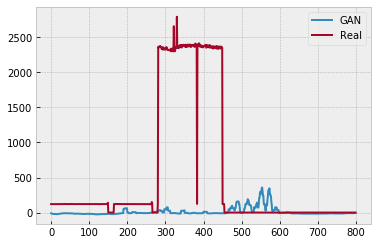

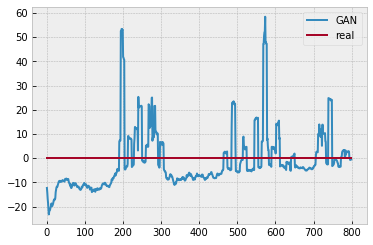

Batch_no: 26000  Epoch: 400


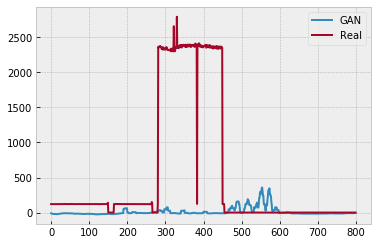

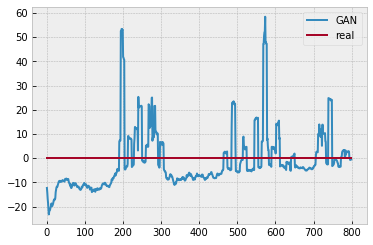

Batch_no: 26500  Epoch: 407


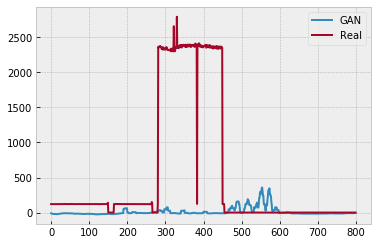

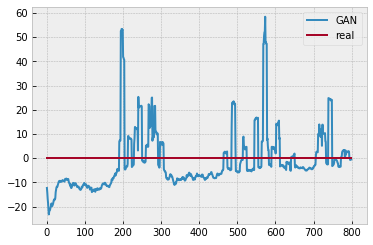

Batch_no: 27000  Epoch: 415


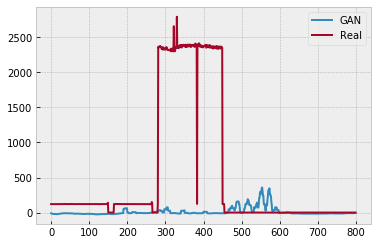

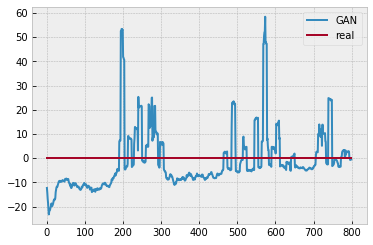

Batch_no: 27500  Epoch: 423


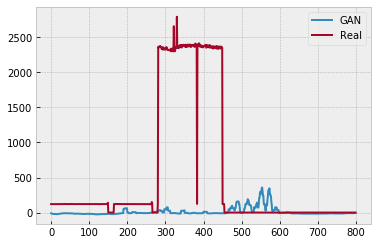

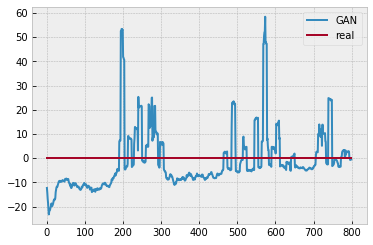

Batch_no: 28000  Epoch: 430


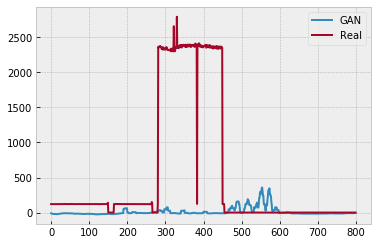

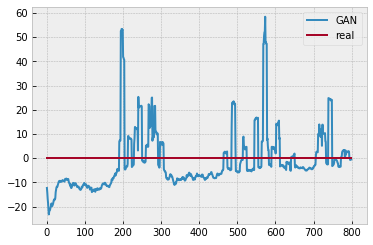

Batch_no: 28500  Epoch: 438


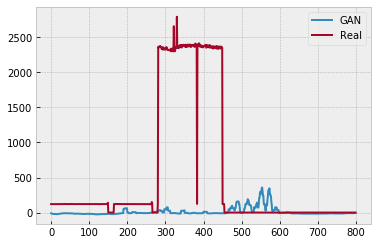

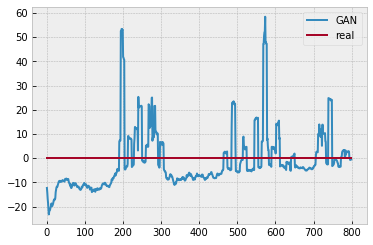

Batch_no: 29000  Epoch: 446


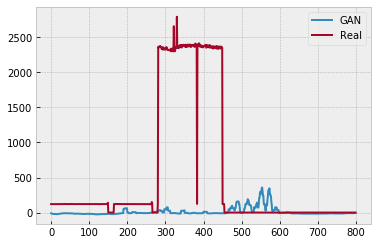

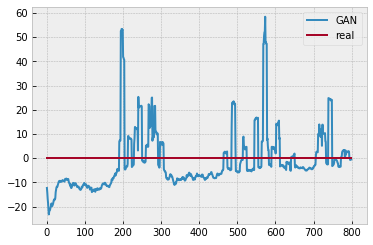

Batch_no: 29500  Epoch: 453


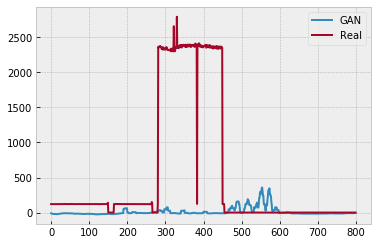

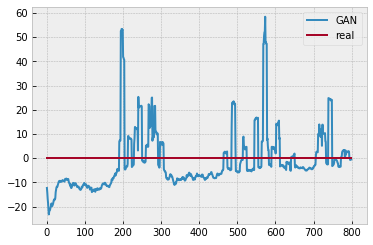

Batch_no: 30000  Epoch: 461


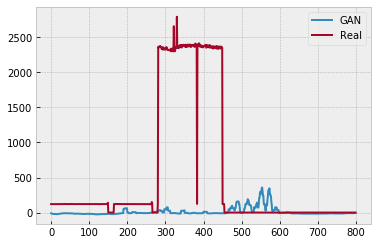

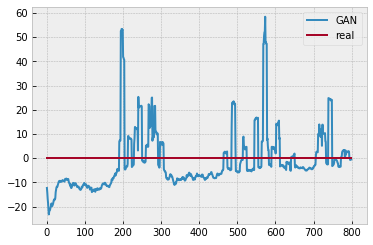

Batch_no: 30500  Epoch: 469


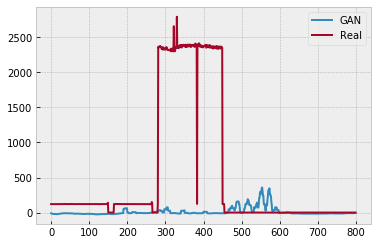

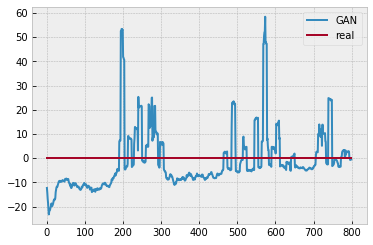

Batch_no: 31000  Epoch: 476


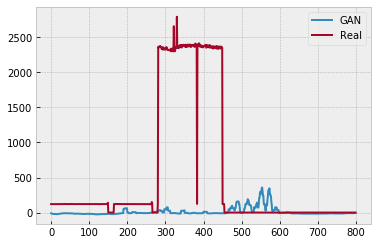

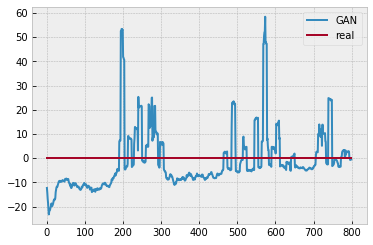

Batch_no: 31500  Epoch: 484


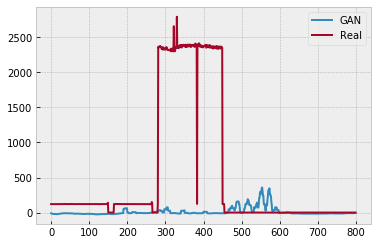

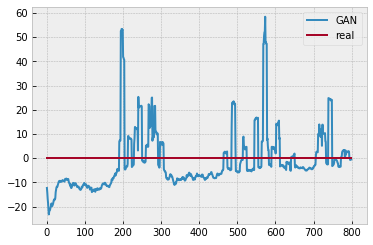

Batch_no: 32000  Epoch: 492


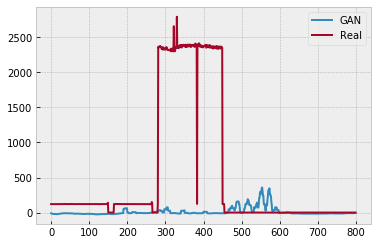

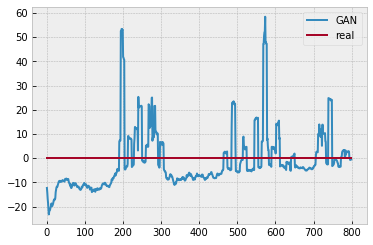

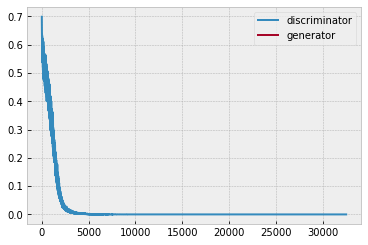

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['gxxx']
Smoothed..
recall= 0.253169, precision= 0.152528, F1= 0.190366, accuracy= 0.937139
RE=0.126711, MAE= 42.715213
g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are kept
g5 weights are kept
g6 weights are kept
g7 weights are kept
d1 weights are kept
d2 weights are kept
d3 weights are kept
d4 weights are kept
d5 weights are initialized
Batch_no: 0  Epoch: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:71: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


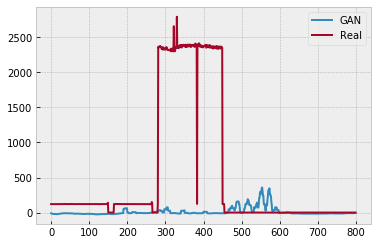

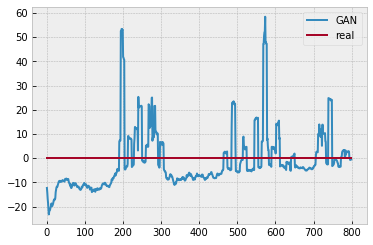

Batch_no: 500  Epoch: 7


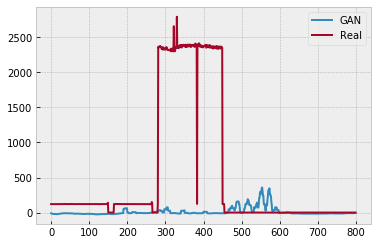

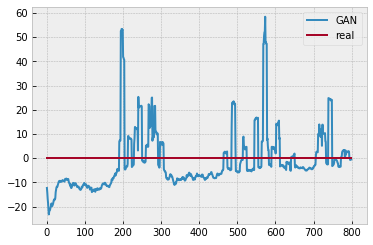

Batch_no: 1000  Epoch: 15


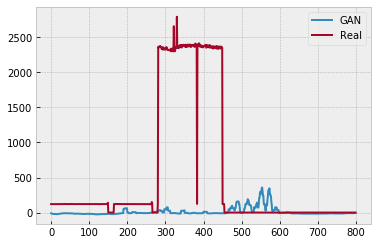

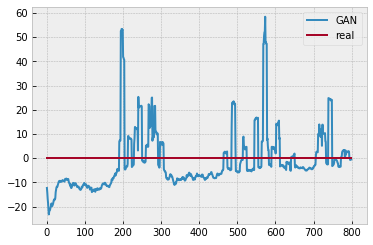

Batch_no: 1500  Epoch: 23


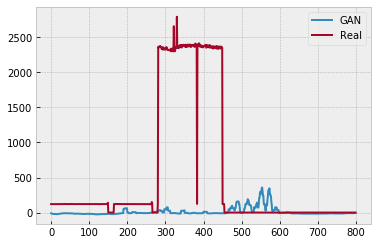

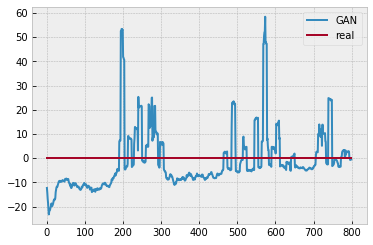

Batch_no: 2000  Epoch: 30


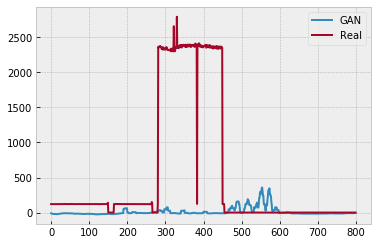

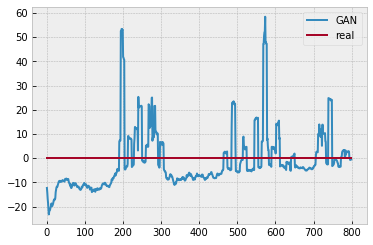

Batch_no: 2500  Epoch: 38


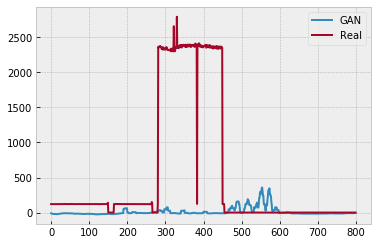

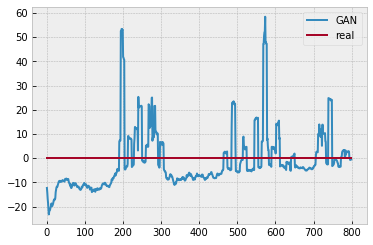

Batch_no: 3000  Epoch: 46


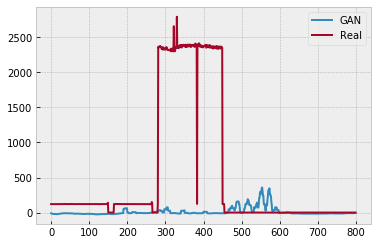

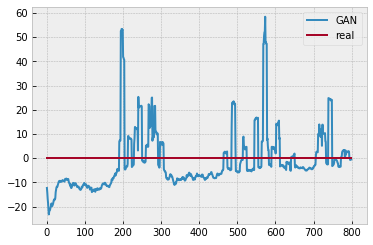

Batch_no: 3500  Epoch: 53


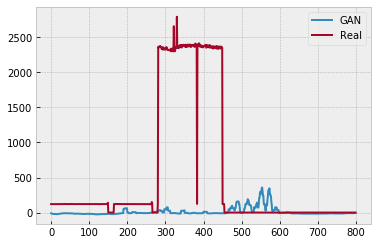

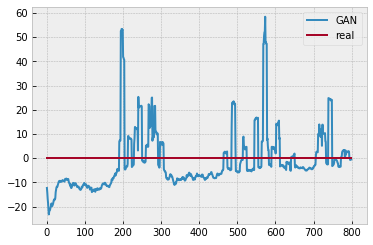

Batch_no: 4000  Epoch: 61


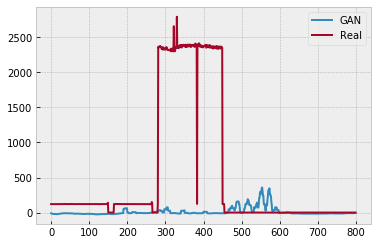

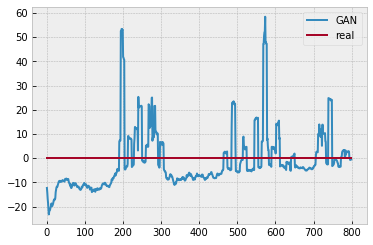

Batch_no: 4500  Epoch: 69


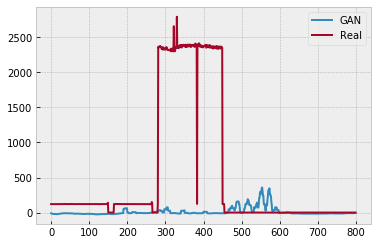

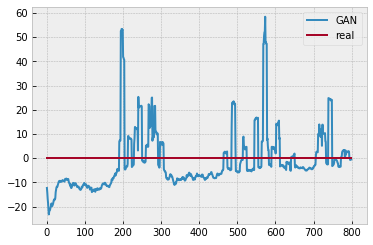

Batch_no: 5000  Epoch: 76


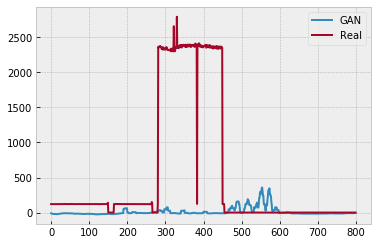

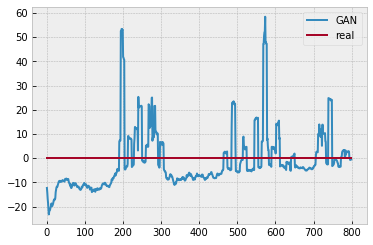

Batch_no: 5500  Epoch: 84


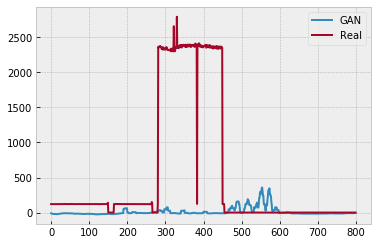

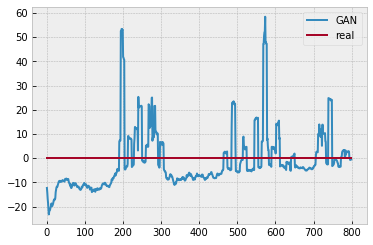

Batch_no: 6000  Epoch: 92


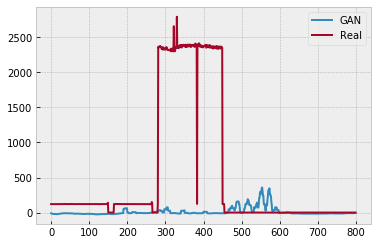

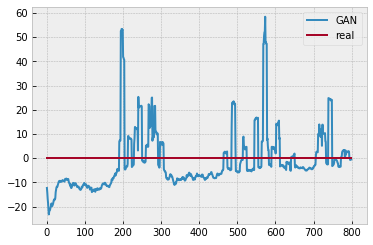

Batch_no: 6500  Epoch: 100


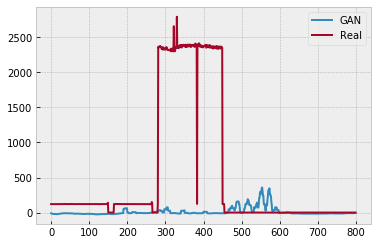

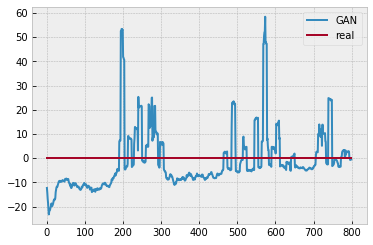

Batch_no: 7000  Epoch: 107


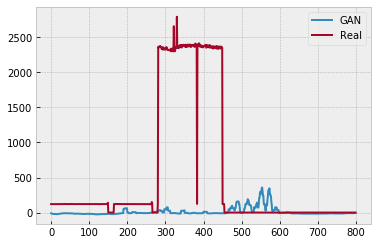

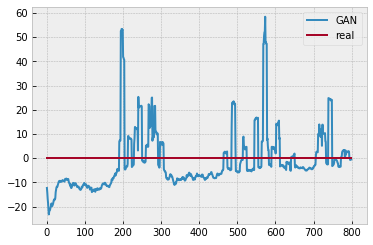

Batch_no: 7500  Epoch: 115


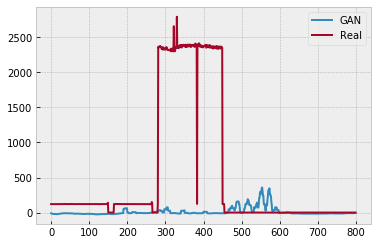

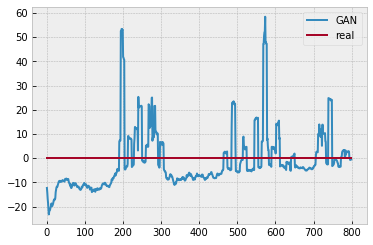

Batch_no: 8000  Epoch: 123


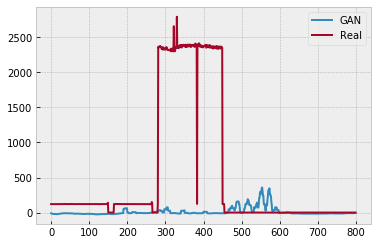

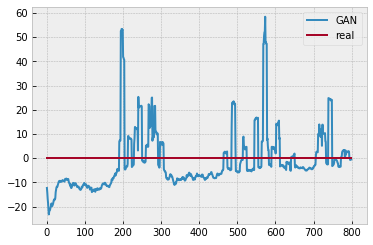

Batch_no: 8500  Epoch: 130


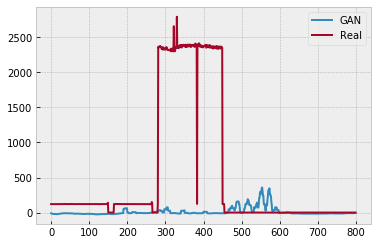

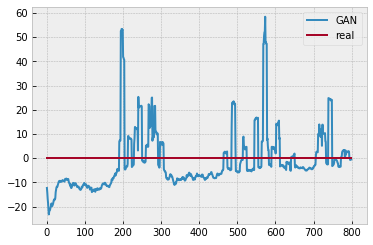

Batch_no: 9000  Epoch: 138


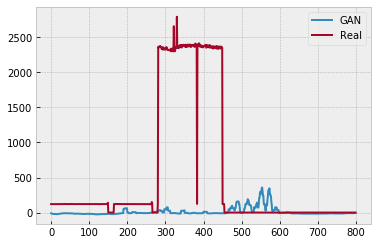

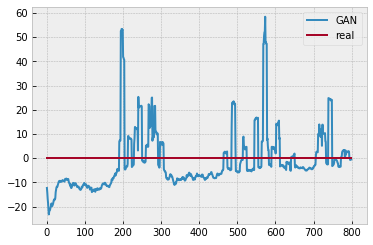

Batch_no: 9500  Epoch: 146


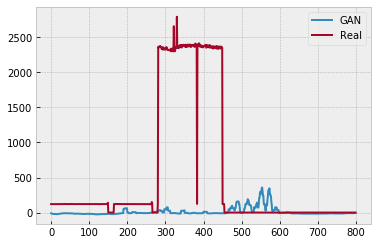

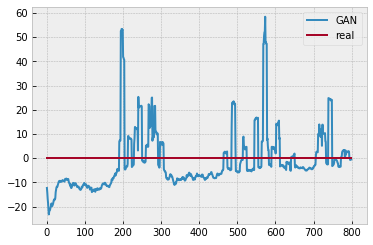

Batch_no: 10000  Epoch: 153


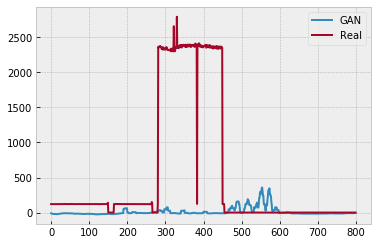

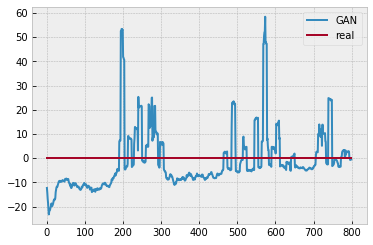

Batch_no: 10500  Epoch: 161


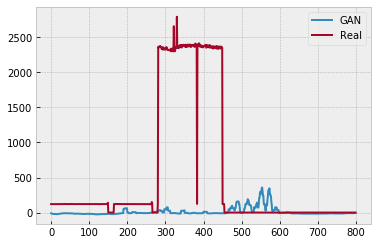

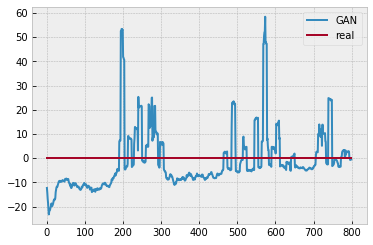

Batch_no: 11000  Epoch: 169


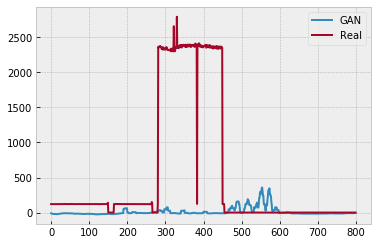

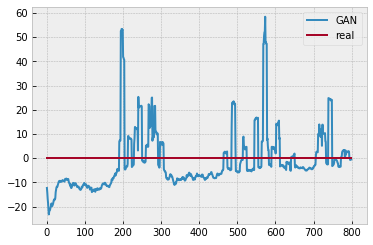

Batch_no: 11500  Epoch: 176


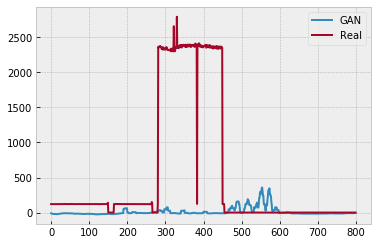

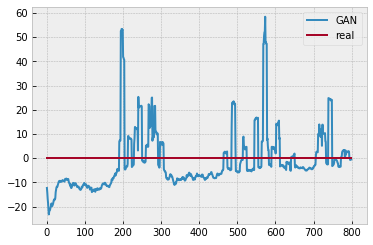

Batch_no: 12000  Epoch: 184


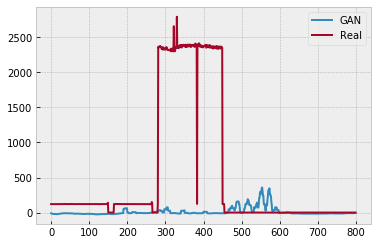

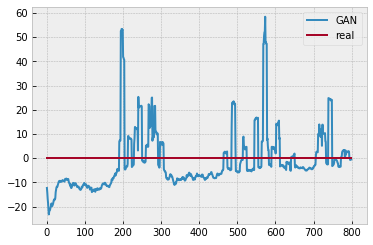

Batch_no: 12500  Epoch: 192


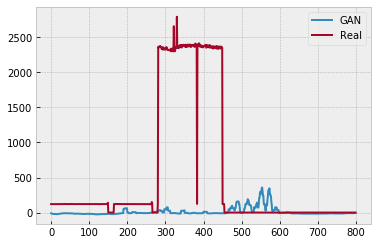

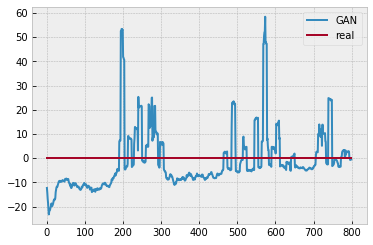

Batch_no: 13000  Epoch: 200


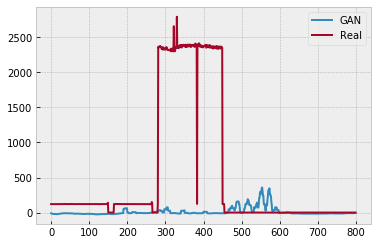

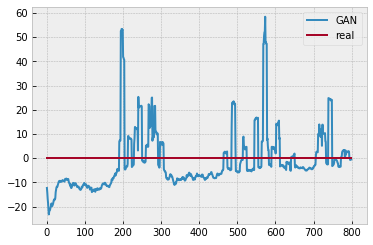

Batch_no: 13500  Epoch: 207


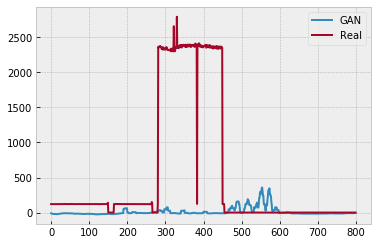

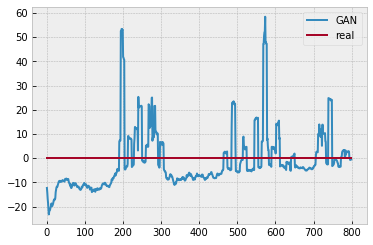

Batch_no: 14000  Epoch: 215


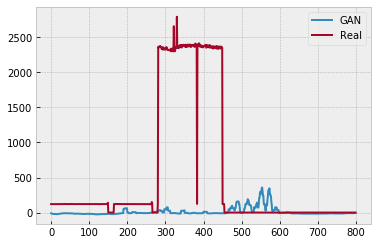

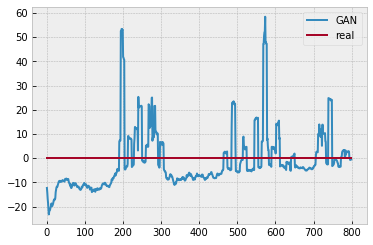

Batch_no: 14500  Epoch: 223


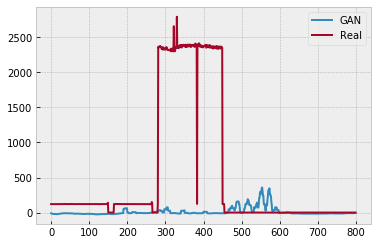

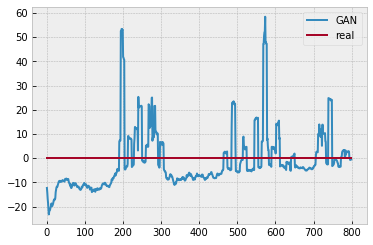

Batch_no: 15000  Epoch: 230


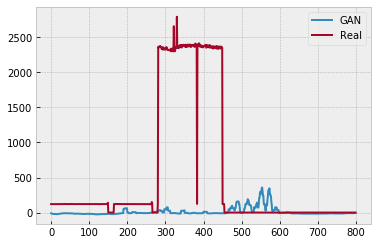

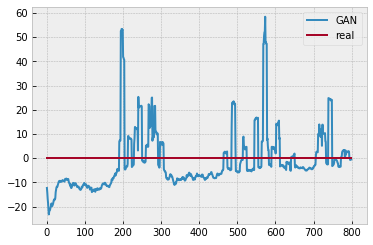

Batch_no: 15500  Epoch: 238


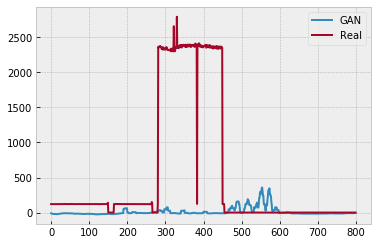

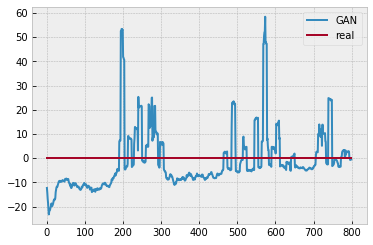

Batch_no: 16000  Epoch: 246


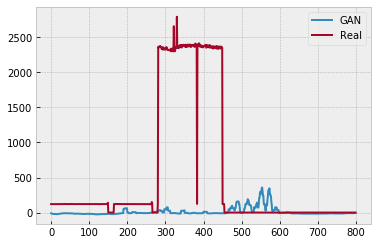

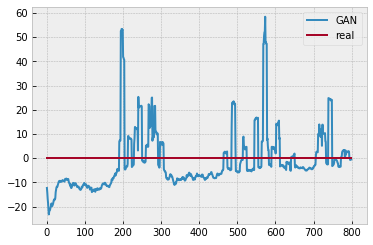

Batch_no: 16500  Epoch: 253


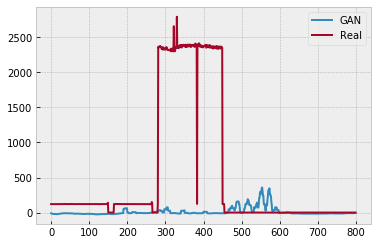

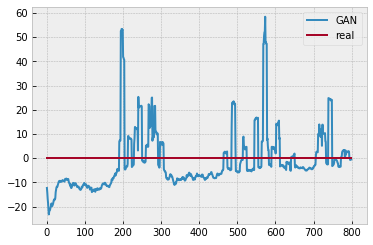

Batch_no: 17000  Epoch: 261


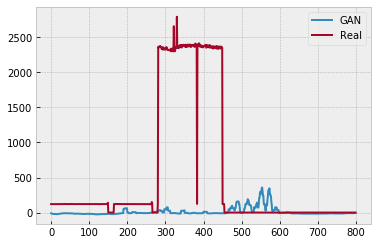

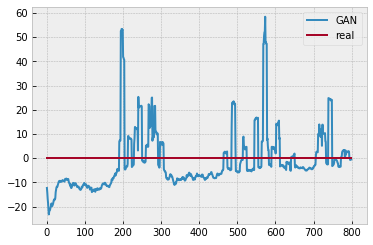

Batch_no: 17500  Epoch: 269


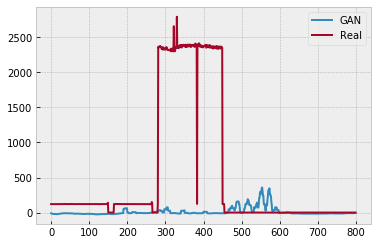

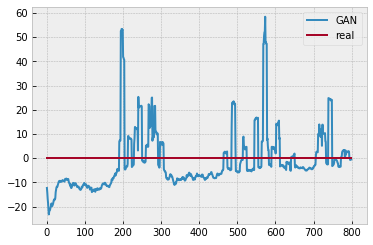

Batch_no: 18000  Epoch: 276


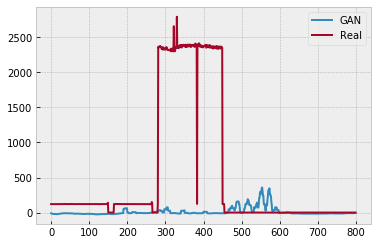

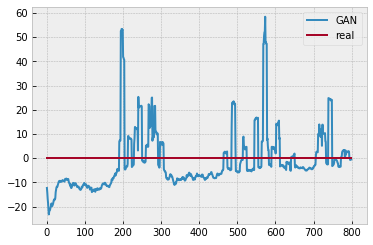

Batch_no: 18500  Epoch: 284


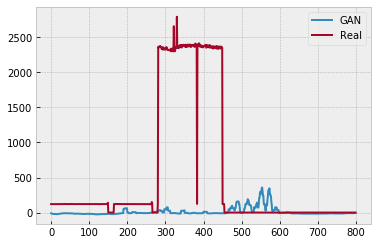

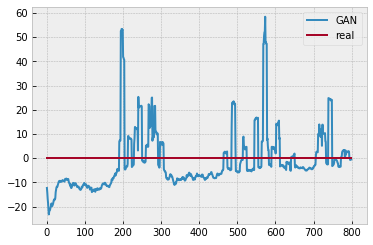

Batch_no: 19000  Epoch: 292


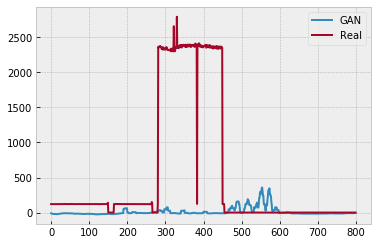

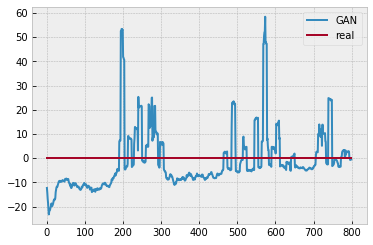

Batch_no: 19500  Epoch: 300


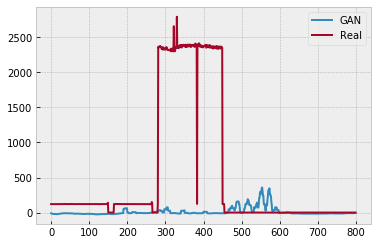

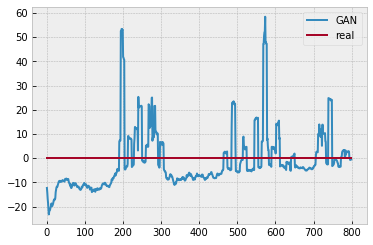

Batch_no: 20000  Epoch: 307


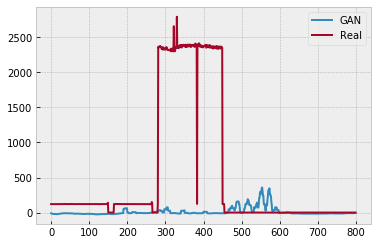

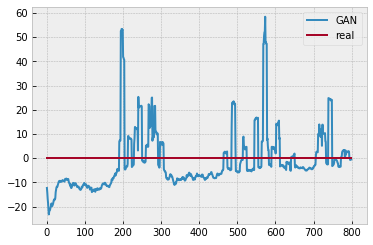

Batch_no: 20500  Epoch: 315


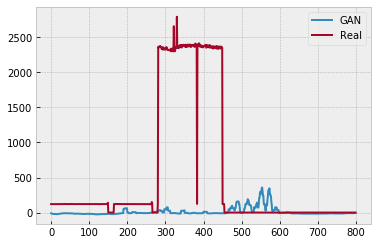

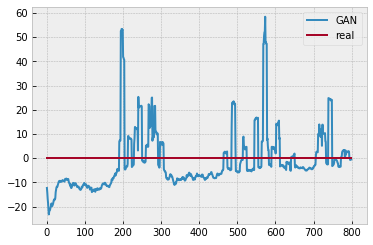

Batch_no: 21000  Epoch: 323


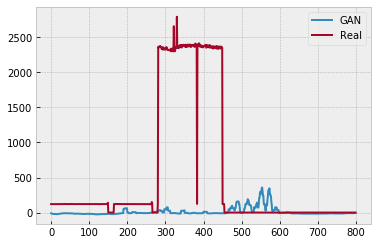

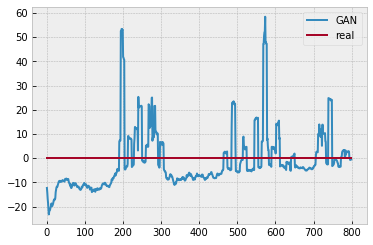

Batch_no: 21500  Epoch: 330


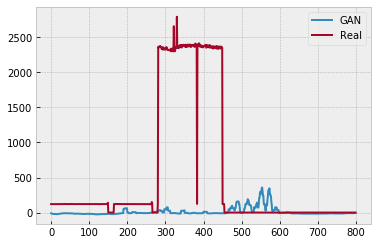

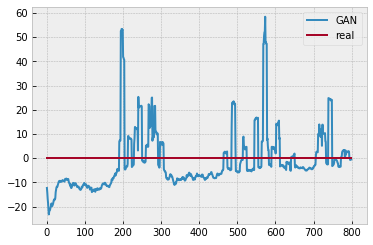

Batch_no: 22000  Epoch: 338


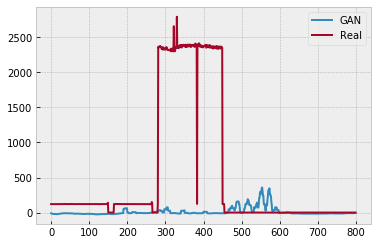

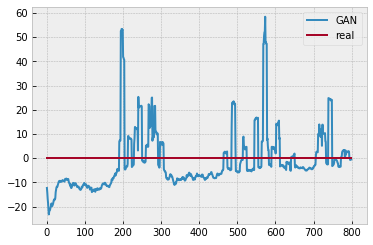

Batch_no: 22500  Epoch: 346


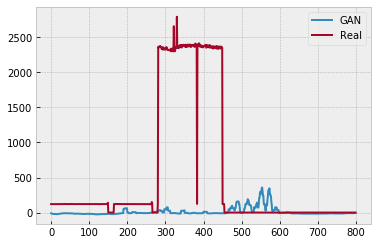

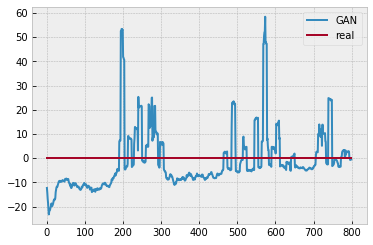

Batch_no: 23000  Epoch: 353


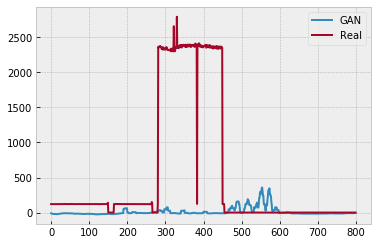

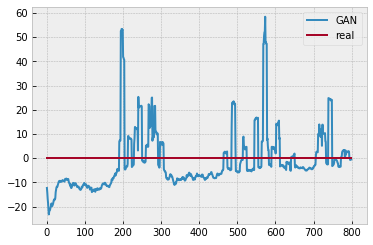

Batch_no: 23500  Epoch: 361


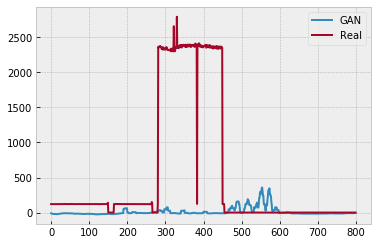

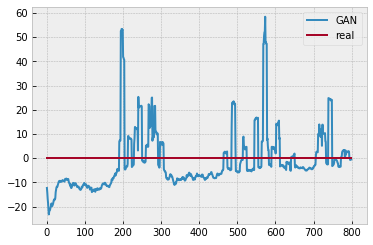

Batch_no: 24000  Epoch: 369


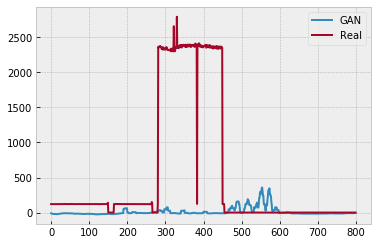

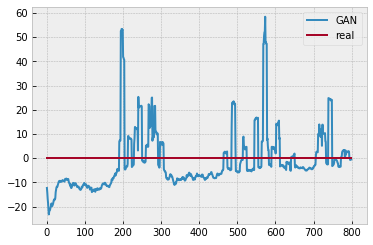

Batch_no: 24500  Epoch: 376


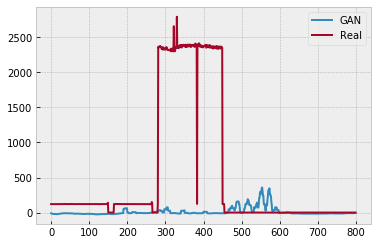

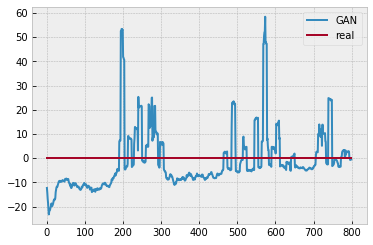

Batch_no: 25000  Epoch: 384


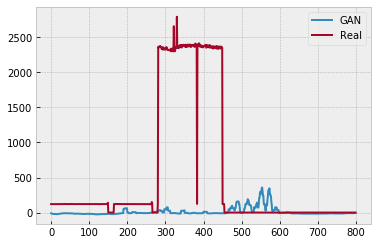

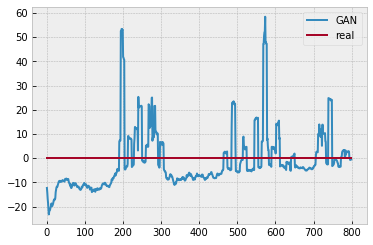

Batch_no: 25500  Epoch: 392


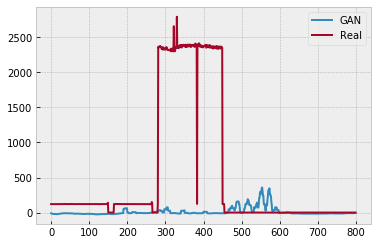

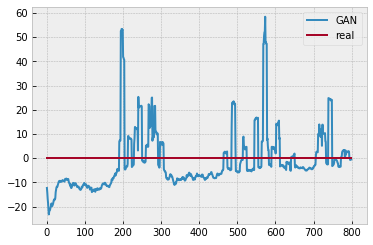

Batch_no: 26000  Epoch: 400


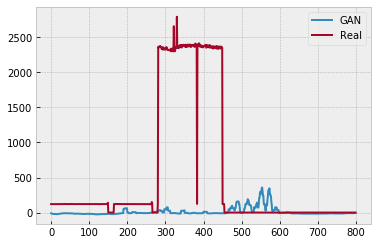

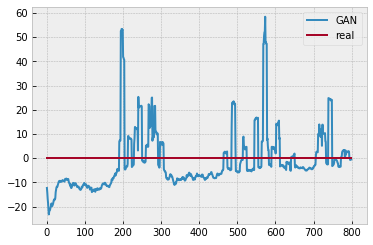

Batch_no: 26500  Epoch: 407


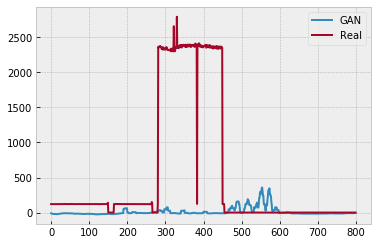

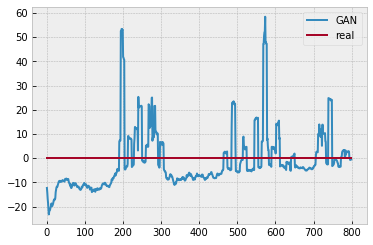

Batch_no: 27000  Epoch: 415


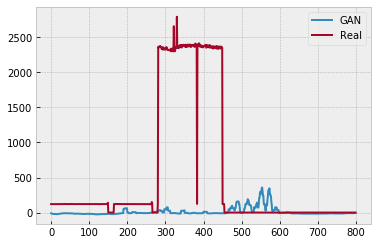

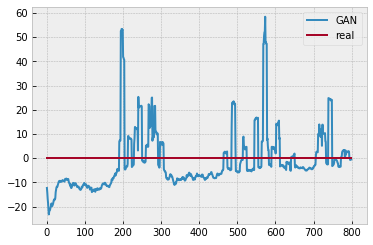

Batch_no: 27500  Epoch: 423


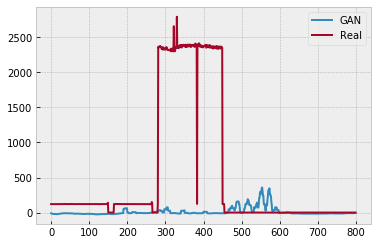

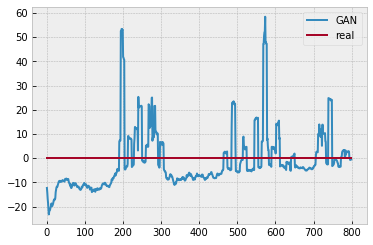

Batch_no: 28000  Epoch: 430


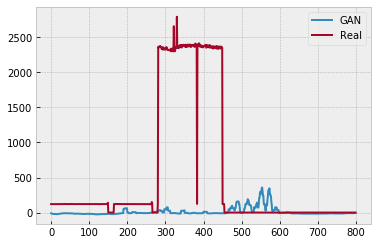

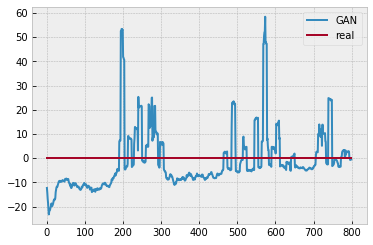

Batch_no: 28500  Epoch: 438


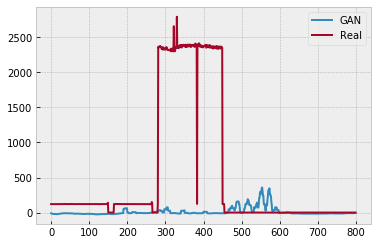

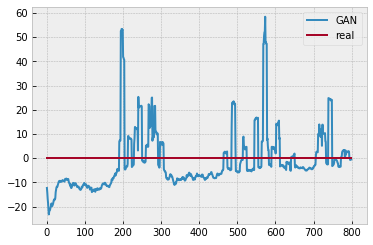

Batch_no: 29000  Epoch: 446


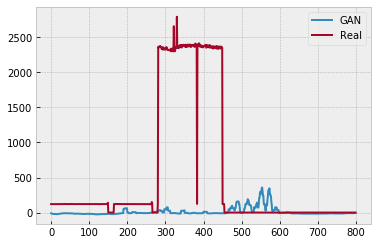

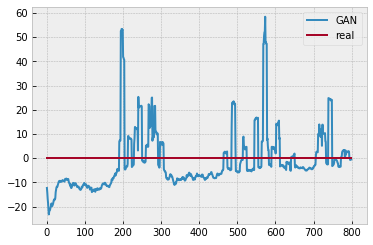

Batch_no: 29500  Epoch: 453


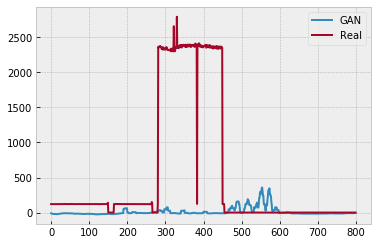

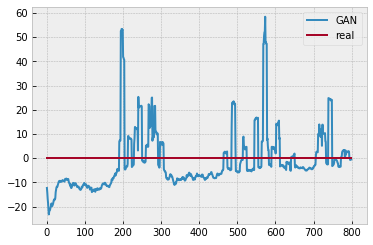

Batch_no: 30000  Epoch: 461


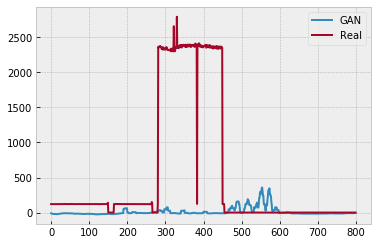

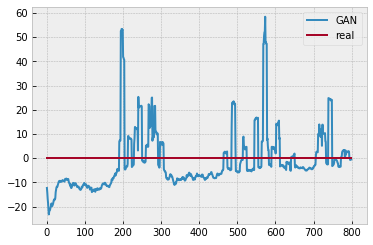

Batch_no: 30500  Epoch: 469


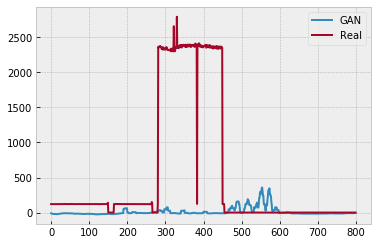

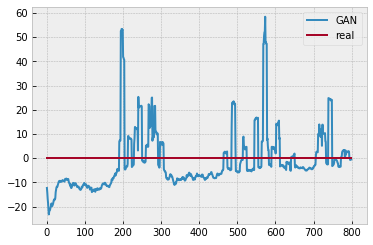

Batch_no: 31000  Epoch: 476


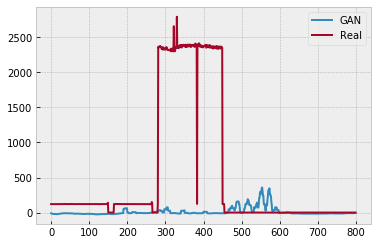

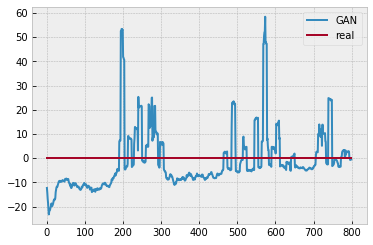

Batch_no: 31500  Epoch: 484


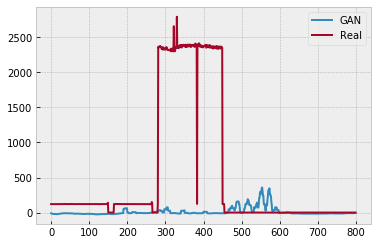

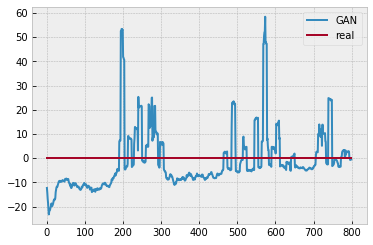

Batch_no: 32000  Epoch: 492


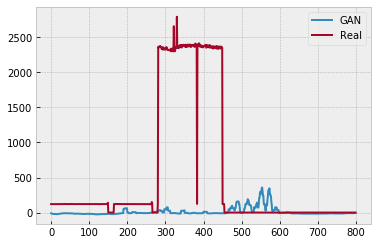

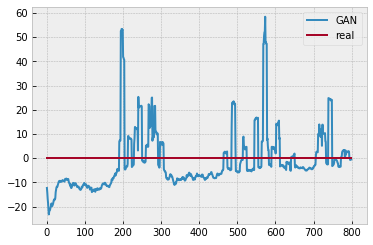

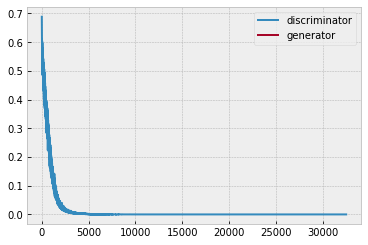

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['gxxx']
Smoothed..
recall= 0.300445, precision= 0.165753, F1= 0.213642, accuracy= 0.935439
RE=0.248880, MAE= 43.556246


In [11]:
performance1={}

X_to_disaggregate=np.load("data/UKDALE_house1_X_raw_test_DW.npy")
Y_true=np.load("data/UKDALE_house1_Y_raw_test_DW.npy")

# d_train_group=[["d5"]] #["d1","d2","d3","d4","d5"]




d_train_group=[["d1","d2","d3","d4","d5"],
               ["d2","d3","d4","d5"],
               ["d3","d4","d5"],
               ["d4","d5"],
               ["d5"]]
                




# d_train_group=[["d2","d3","d4","d5"]]





g_train_group=[["gxxx"]]

#generator configuring
for ii, d_retrain in enumerate(d_train_group):
    for i, g_retrain in enumerate(g_train_group):
        generator.load_state_dict(checkpoint['g_state_dict'],strict=True)
        discriminator.load_state_dict(checkpoint['d_state_dict'],strict=True)
        
#         for name, child in generator.named_children():
#             if name in g_retrain:
#                 print(name + ' is unfrozen in generator')
#                 for param in child.parameters():
#                     param.requires_grad = True
#             else:
#                 print(name + ' is frozen in generator')
#                 for param in child.parameters():
#                     param.requires_grad = False


#         #discriminator configuring
#         for name, child in discriminator.named_children():
#             if name in d_retrain:
#                 print(name + ' is unfrozen in discriminator ')
#                 for param in child.parameters():
#                     param.requires_grad = True
#             else:
#                 print(name + ' is frozen in discriminator')
#                 for param in child.parameters():
#                     param.requires_grad = False

                    
                    
                    

        for name, child in generator.named_children():
            if name in g_retrain:
                print(name + ' weights are initialized')
                torch.nn.init.xavier_uniform(child[0].weight.data)
            else:
                print(name + ' weights are kept')

        for name, child in discriminator.named_children():
            if name in d_retrain:
                print(name + ' weights are initialized')
                torch.nn.init.xavier_uniform(child[0].weight.data)
            else:
                print(name + ' weights are kept')

       
    
    # Optimizers
        optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
        optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1, b2))
        # optimizer_G.state_dict()["param_groups"][0]["params"]


        #loading optimizers states
        optimizer_G.load_state_dict(checkpoint["g_opt_dict"])
        optimizer_D.load_state_dict(checkpoint["d_opt_dict"])




        g_losses=[]
        d_losses=[]

        for epoch in range(n_epochs):
            g_running_loss=0.0
            d_running_loss=0.0
            for i, (aggregate, appliance) in enumerate(dataloader):

                #reshaping to fit the convolution layer
                aggregate_reshaped=aggregate.reshape(aggregate.shape[0],1,aggregate.shape[1])

                batch_size = appliance.shape[0]
                app=appliance[:,:]

                # Adversarial ground truths
                valid = Variable(FloatTensor(batch_size, 1).fill_(1.0), requires_grad=False)
                fake = Variable(FloatTensor(batch_size, 1).fill_(0.0), requires_grad=False)

                # Configure input
                real_aggregate_reshaped = Variable(aggregate_reshaped.type(FloatTensor))
                real_appliance = Variable(app.type(FloatTensor))
                real_aggregate= Variable(aggregate.type(FloatTensor))

                real_app_real_agg=torch.cat((real_appliance,real_aggregate),1)


#                 # -----------------
#                 #  Train Generator
#                 # -----------------
#                 optimizer_G.zero_grad()


#                 gen_appliance = generator(real_aggregate_reshaped)

#         # #subtracting the first output
#         #         if epoch==0 and i==0:
#         #             first_gen1=gen_appliance[0,:].detach()


#         #         first_gen=first_gen1.repeat(len(appliance),1)
#         #         gen_appliance=gen_appliance-first_gen



#                 gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)

#                 validity,feat= discriminator(gen_app_real_agg)

#                 g_loss=feature_loss(feat, real_app_real_agg)
#         #         g_loss = adversarial_loss(validity, valid)

#                 g_loss.backward()
#                 optimizer_G.step()
#                 g_loss_1=g_loss.item()


# #                 g_losses.append(g_loss.item())

# ########################################################################################################################
#         # # Generator second training round


#                 optimizer_G.zero_grad()

                gen_appliance = generator(real_aggregate_reshaped)



#         #         gen_appliance=gen_appliance-first_gen #subtract




                gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)
#                 validity,feat = discriminator(gen_app_real_agg)
#                 g_loss = feature_loss(feat, real_app_real_agg)

#         #         g_loss = adversarial_loss(validity, valid)


#                 g_loss.backward()
#                 g_loss_2=g_loss.item()

#                 optimizer_G.step()


#                 # g_running_loss+=g_loss.item()
#                 #g_epoch_loss=g_running_loss/len(dataloader)        
#                 #g_losses.append(g_epoch_loss)

#         # Generator third training round

#                 optimizer_G.zero_grad()

#                 gen_appliance = generator(real_aggregate_reshaped)


#         #         gen_appliance=gen_appliance-first_gen #subtract

#                 gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)

#                 validity,feat = discriminator(gen_app_real_agg)


#                 g_loss = feature_loss(feat, real_app_real_agg)
#         #         g_loss = adversarial_loss(validity, valid)

#                 g_loss.backward()
#                 optimizer_G.step()

#                 g_loss_3=g_loss.item()

#                 g_losses.append((g_loss_1+g_loss_2+g_loss_3)/3)


        # ----------
        #  Training
        # ----------


                # ---------------------
                #  Train Discriminator
                # ---------------------


                optimizer_D.zero_grad()


                real_app_real_agg=torch.cat((appliance,aggregate),1)

                real_app_real_agg=Variable(real_app_real_agg.type(FloatTensor))

                validity_real,_ = discriminator(real_app_real_agg)
                d_real_loss = adversarial_loss(validity_real, valid)

                validity_fake,_ = discriminator(gen_app_real_agg.detach()) #detach
                d_fake_loss = adversarial_loss(validity_fake, fake)

                d_loss = (d_real_loss + d_fake_loss) / 2


                d_loss.backward()
                optimizer_D.step()


                d_losses.append(d_loss.item())

                ## end trining discrimnator

                batches_done = epoch * len(dataloader) + i
                #print("Epoch:",epoch,"Batch:",i,"of:",len(dataloader),"batches done:",batches_done)
                if batches_done % sample_interval == 0:
                    print("Batch_no:",batches_done," Epoch:",epoch)
                    sample_data(n_row=1, batches_done=batches_done)
        plt.plot(d_losses,label="discriminator")
        plt.plot(g_losses,label="generator")
        plt.legend()
        plt.show()


        #disaggregate
        # house 1



        # end house 1

        # #house 5
        # X_to_disaggregate=np.load("X_raw_house_5.npy") 
        # Y_true=np.load("Y_raw_house_5.npy")
        # X_to_disaggregate=X_to_disaggregate[::s][0:140000]
        # Y_true=Y_true[::s][0:140000]
        # # print(X_s.shape[0])
        # plt.plot(Y_true)
        # #end house 5



        agg_len=X_to_disaggregate.shape[0]
        w=sig_len
        step=int(50) #64 #32

        agg_segments=np.zeros((1,w))
        app_segments=np.zeros((1,w))



        i=0
        while i<=agg_len-w:
            agg_segment=X_to_disaggregate[i:i+w].reshape(1,-1)
            app_segment=Y_true[i:i+w].reshape(1,-1)
            agg_segments=np.concatenate((agg_segments,agg_segment),axis=0)
            app_segments=np.concatenate((app_segments,app_segment),axis=0)
            i+=step

        agg_segments=agg_segments[1:,:]    
        app_segments=app_segments[1:,:]    



        agg_segments_scaled=scale_agg.transform(agg_segments)
        agg_segments_scaled_reshaped=agg_segments_scaled.reshape(agg_segments_scaled.shape[0],1,agg_segments_scaled.shape[1])
        app_segments_scaled=scale_app.transform(app_segments)


        samples_from=0
        samples_to=int(len(agg_segments_scaled_reshaped))

        sub_agg_segments=agg_segments_scaled_reshaped[samples_from:samples_to,:]
        sub_app_true=app_segments_scaled[samples_from:samples_to,:]

        #sub_app_true=app_segments[samples_from:samples_to,:]
        gen_out=disaggregate(sub_agg_segments)#tensor generated

        disaggregated_appliance=np.array(gen_out.cpu().detach()) #numpy appliance generated
        disaggregated_appliance_inv=scale_app.inverse_transform(disaggregated_appliance)

        # sub_app_true_inv=scale_app.inverse_transform(sub_app_true) #app segments

        threshold=0
        disaggregated_appliance_inv[disaggregated_appliance_inv<=threshold] = 0
        sub_agg_segments[sub_agg_segments<=threshold] = 0


        disaggregation_confidence=confidence(appliance=gen_out,aggregate=sub_agg_segments[:,0,:])
        disaggregation_confidence.shape


        indecis_matrix=np.zeros(sub_app_true.shape)
        indecis_matrix.shape

        d=np.array(disaggregation_confidence.cpu().detach())
        confidence_repeated=np.repeat(d,disaggregated_appliance.shape[1],axis=1)


        k=0
        for i in range(len(indecis_matrix)):
            indecis_matrix[i,:]=np.arange(k,k+w,dtype = 'int')
            k+=step
        indecis_matrix=indecis_matrix.reshape(1,-1).astype("int")
        disaggregated_appliance_flat=disaggregated_appliance_inv.reshape(1,-1)
        real_appliance_flat=app_segments.reshape(1,-1)
        confidence_repeated_flat=confidence_repeated.reshape(1,-1)


        print("segmenting predictions...")

        pred_dict={}
        confidence_dict={}
        real_dict={}

        for j in range(np.max(indecis_matrix)):
            if j % 5000 == 0:
                print(j," of ", np.max(indecis_matrix))
            a=np.where(indecis_matrix==j)[1]
            pred_dict[j]=disaggregated_appliance_flat[0,a]
            confidence_dict[j]=confidence_repeated_flat[0,a]
            real_dict[j]=real_appliance_flat[0,a]




        from scipy import stats
        threshold=0

        pred_clustered=[] 
        true_app_list=[]
        for key in pred_dict.keys():
            p=pred_dict[key]
            conf=confidence_dict[key]
        #     p[p<=threshold]=0  # thresholding
        #     pred_clustered.append(p.mean())

            pred_clustered.append(p[np.argmax(conf)])
        #     pred_clustered.append(np.percentile(pred_dict[key],80))
            tr=real_dict[key]
        #     tr[tr<=threshold]=0

            true_app_list.append(tr[0])



        shift=0    
        pred_clustered_shifted=np.zeros(len(pred_clustered))
        pred_clustered_shifted[shift:len(pred_clustered)]=pred_clustered[0:len(pred_clustered)-shift]
        # pred_clustered_shifted=pred_clustered_shifted-np.ones(pred_clustered_shifted.shape)*500
        # pred_clustered_shifted[pred_clustered_shifted <=0] = 0


        predictions=np.asarray(pred_clustered_shifted)[0:int(len(pred_clustered_shifted))]
        appliance_true=np.asarray(Y_true[0:int(len(pred_clustered_shifted))])


        predictions_smoothed=smooth(predictions,box_pts=10)
        appliance_true_smoothed=smooth(appliance_true,box_pts=10)

        print("+++++++++++++++++++")
        print(str(g_retrain))
        print("Smoothed..")
        recall2,precision2,F12,accuracy2=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
        print("recall= %f, precision= %f, F1= %f, accuracy= %f" %(recall2,precision2,F12,accuracy2))

        RE2,MAE2=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
        print("RE=%f, MAE= %f"%(RE2,MAE2))

        performance1[str(g_retrain)]=[F12,MAE2,RE2]

        print("=============================================================")


        with open('perf_On_UKDALE_DW2.txt', 'a') as f:
            f.write(str(g_retrain))
            f.write(str(d_retrain))
            f.write("   F1:")
            f.write(str([F12]))
            f.write("\n\n")
        f.close()


## Fix Discriminator

g1 weights are kept
g2 weights are kept
g3 weights are initialized
g4 weights are initialized
g5 weights are initialized
g6 weights are initialized
g7 weights are initialized
d1 weights are kept
d2 weights are kept
d3 weights are kept
d4 weights are kept
d5 weights are kept


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:69: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


Batch_no: 0  Epoch: 0


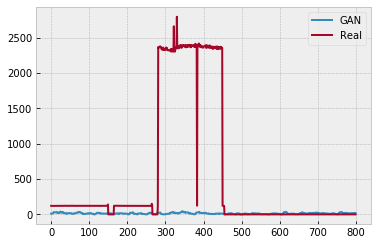

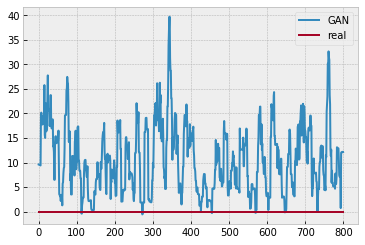

Batch_no: 500  Epoch: 7


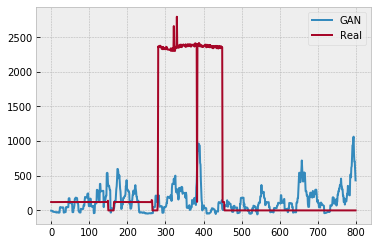

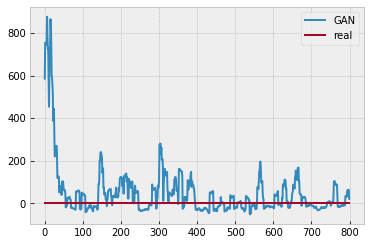

Batch_no: 1000  Epoch: 15


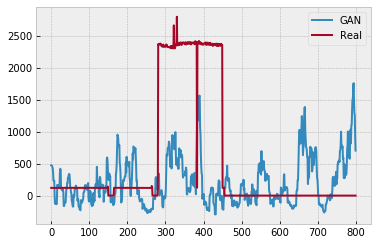

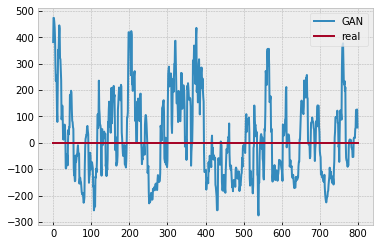

Batch_no: 1500  Epoch: 23


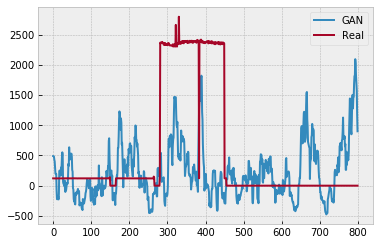

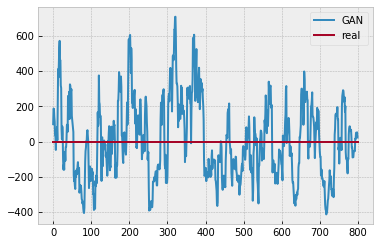

Batch_no: 2000  Epoch: 30


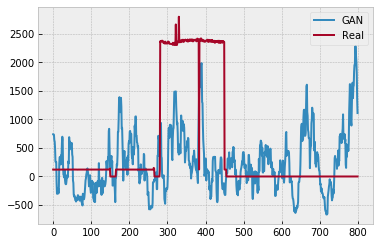

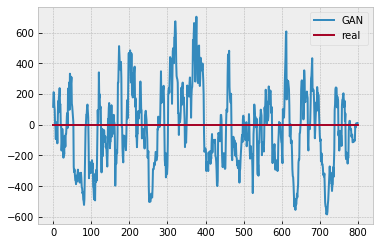

Batch_no: 2500  Epoch: 38


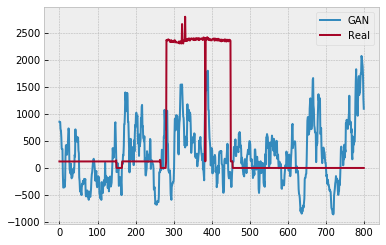

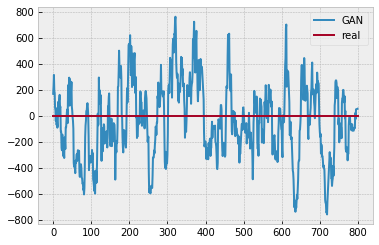

Batch_no: 3000  Epoch: 46


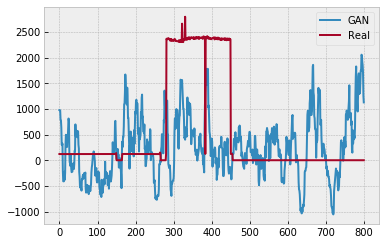

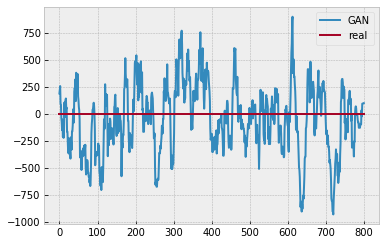

Batch_no: 3500  Epoch: 53


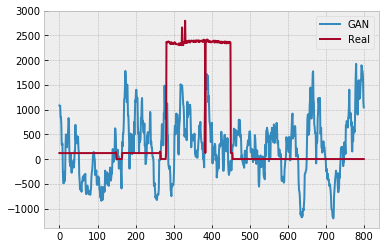

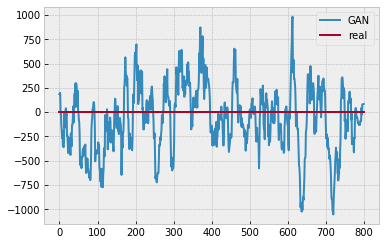

Batch_no: 4000  Epoch: 61


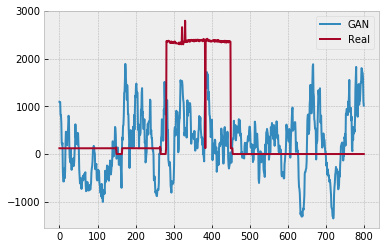

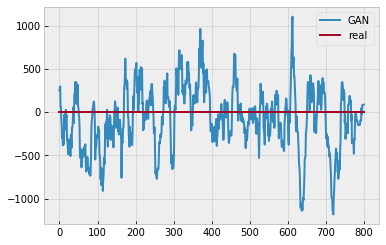

Batch_no: 4500  Epoch: 69


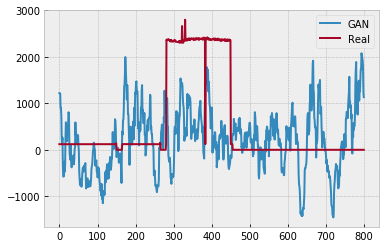

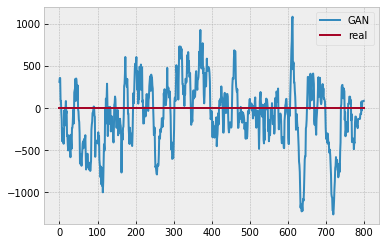

Batch_no: 5000  Epoch: 76


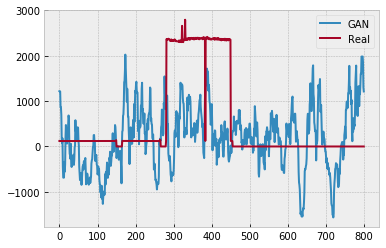

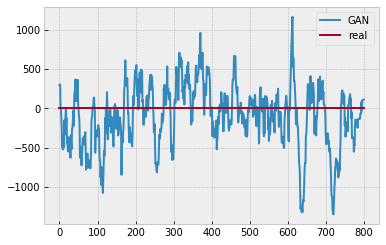

Batch_no: 5500  Epoch: 84


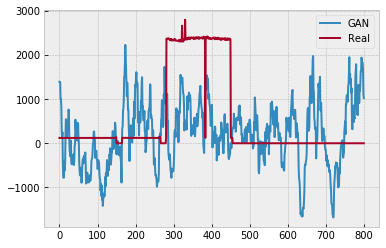

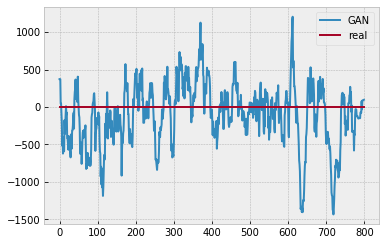

Batch_no: 6000  Epoch: 92


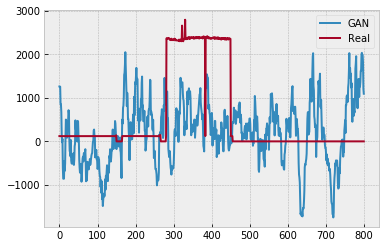

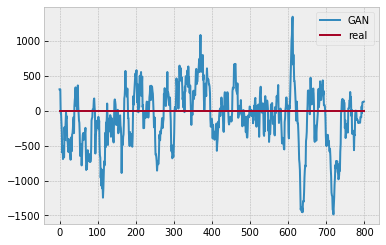

Batch_no: 6500  Epoch: 100


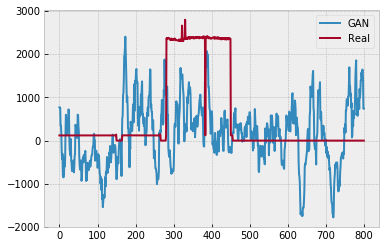

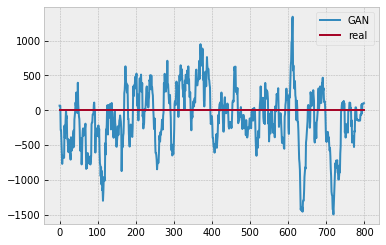

Batch_no: 7000  Epoch: 107


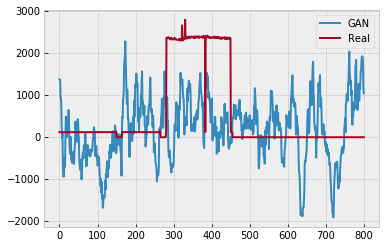

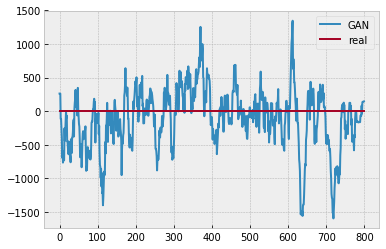

Batch_no: 7500  Epoch: 115


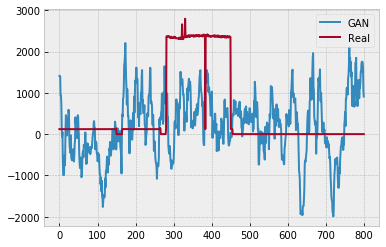

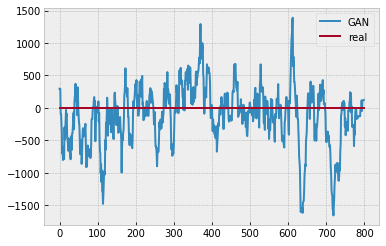

Batch_no: 8000  Epoch: 123


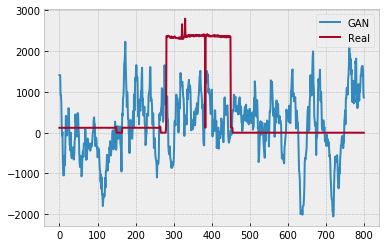

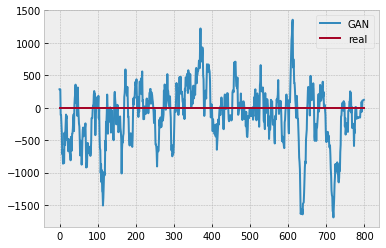

Batch_no: 8500  Epoch: 130


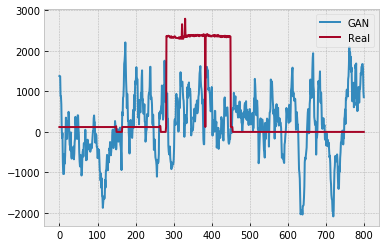

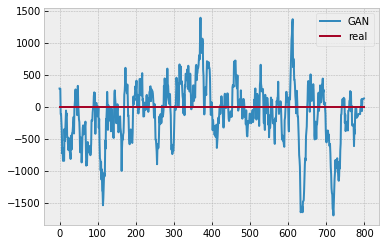

Batch_no: 9000  Epoch: 138


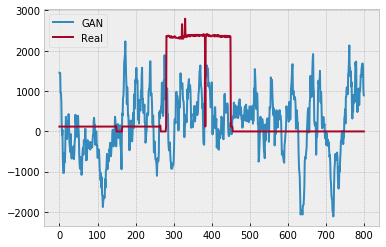

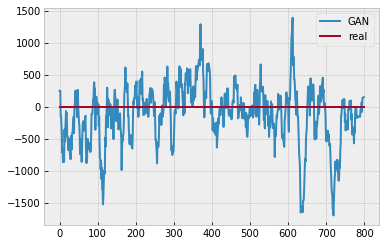

Batch_no: 9500  Epoch: 146


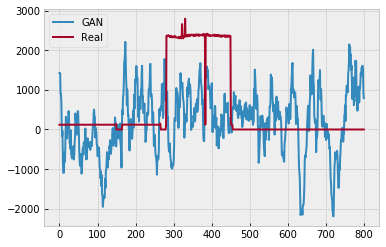

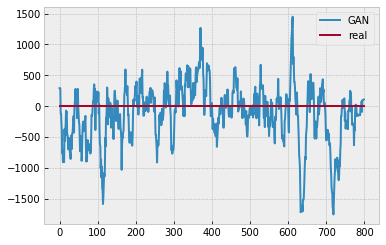

Batch_no: 10000  Epoch: 153


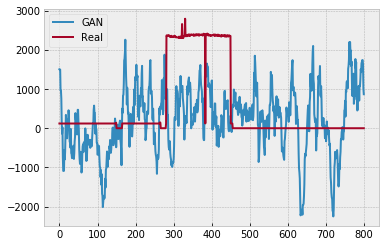

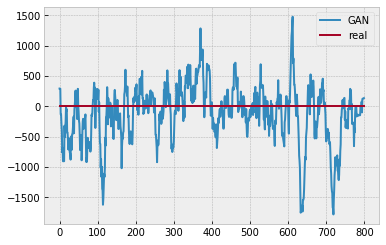

Batch_no: 10500  Epoch: 161


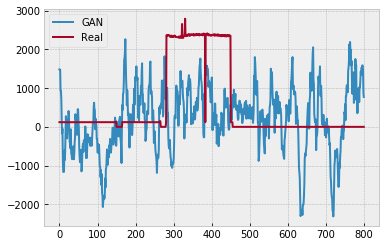

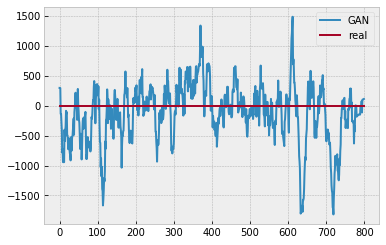

Batch_no: 11000  Epoch: 169


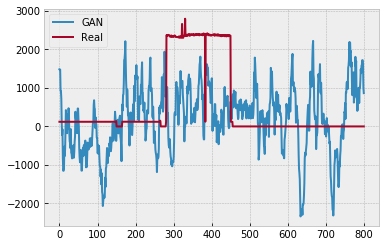

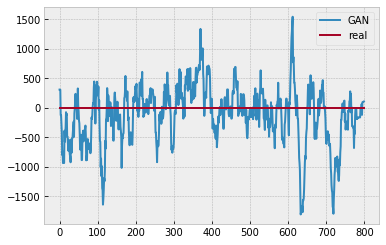

Batch_no: 11500  Epoch: 176


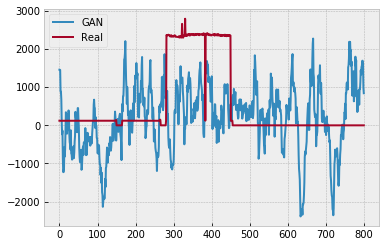

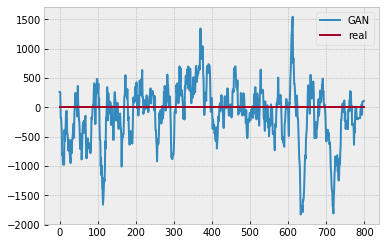

Batch_no: 12000  Epoch: 184


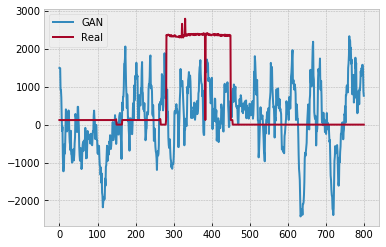

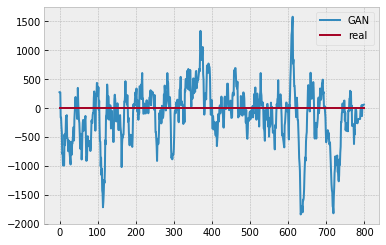

Batch_no: 12500  Epoch: 192


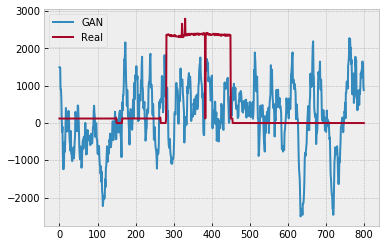

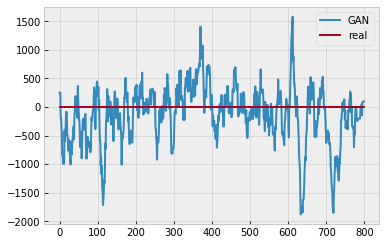

Batch_no: 13000  Epoch: 200


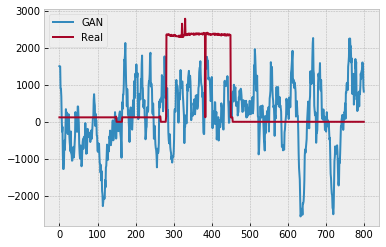

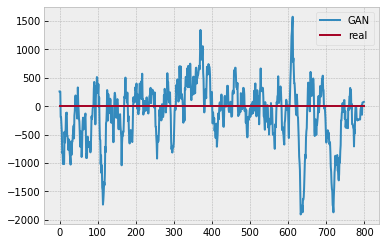

Batch_no: 13500  Epoch: 207


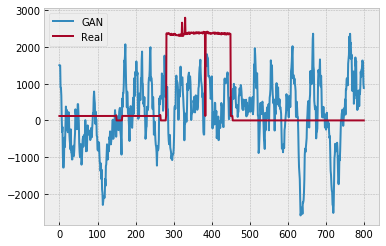

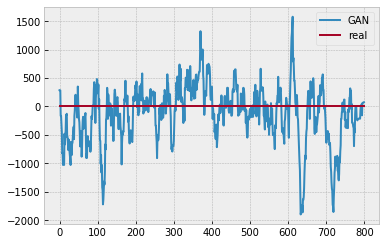

Batch_no: 14000  Epoch: 215


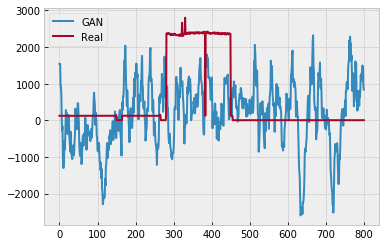

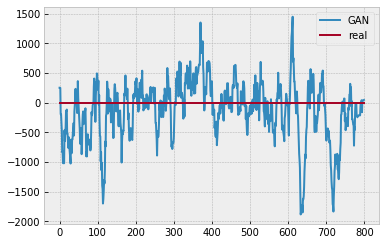

Batch_no: 14500  Epoch: 223


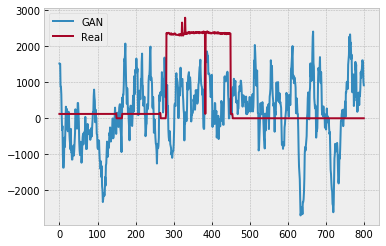

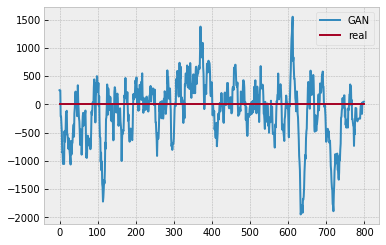

Batch_no: 15000  Epoch: 230


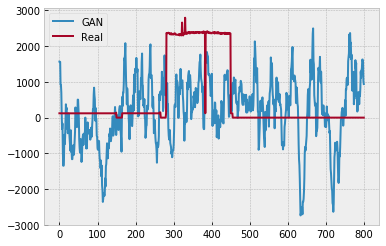

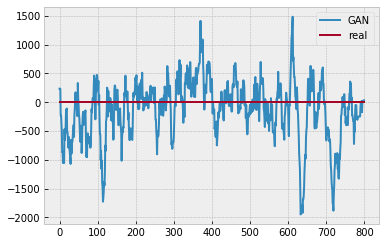

Batch_no: 15500  Epoch: 238


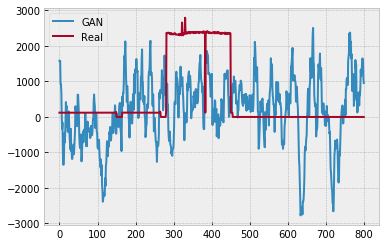

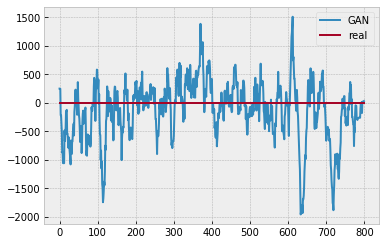

Batch_no: 16000  Epoch: 246


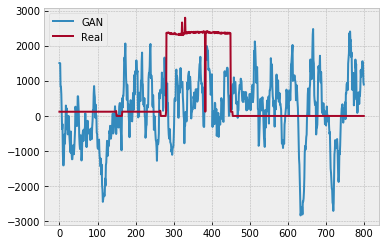

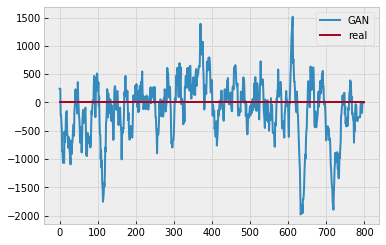

Batch_no: 16500  Epoch: 253


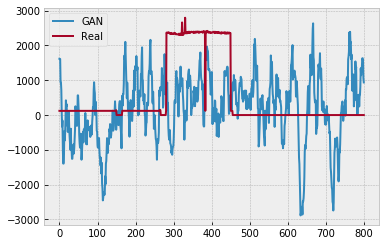

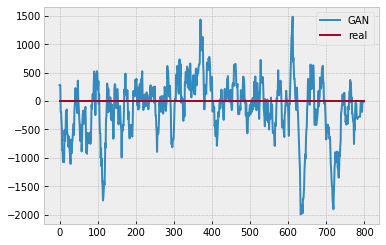

Batch_no: 17000  Epoch: 261


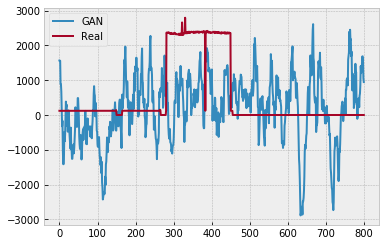

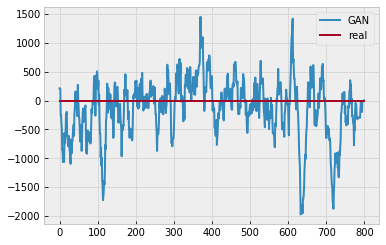

Batch_no: 17500  Epoch: 269


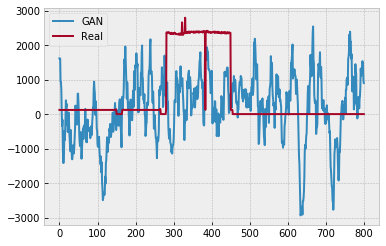

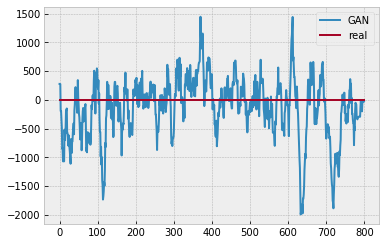

Batch_no: 18000  Epoch: 276


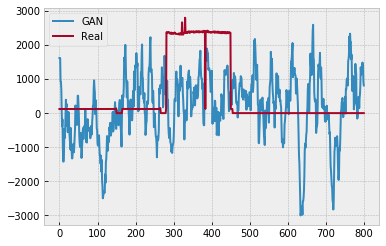

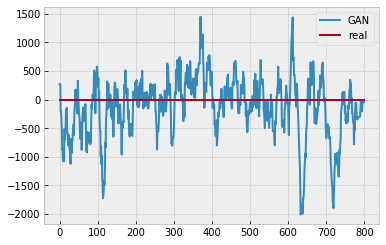

Batch_no: 18500  Epoch: 284


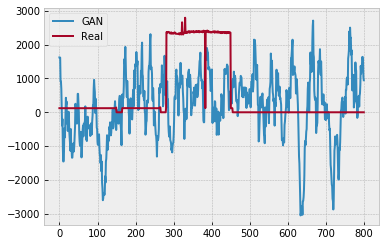

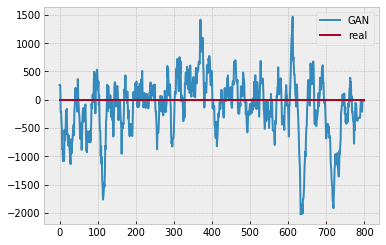

Batch_no: 19000  Epoch: 292


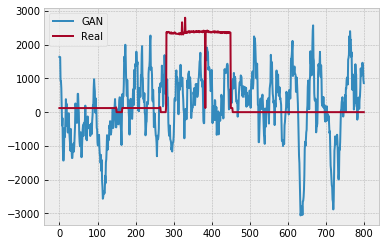

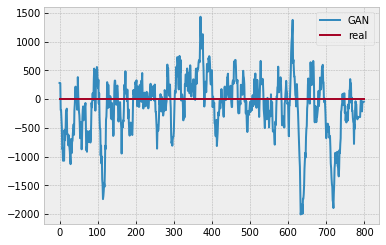

Batch_no: 19500  Epoch: 300


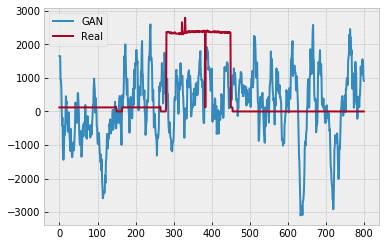

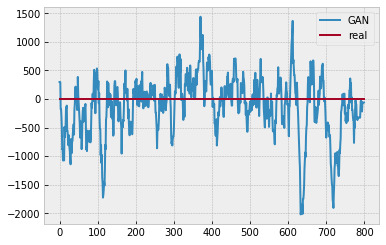

Batch_no: 20000  Epoch: 307


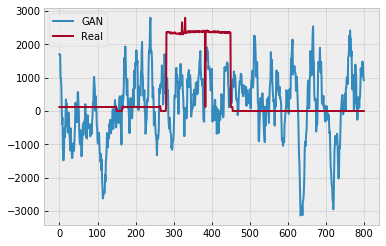

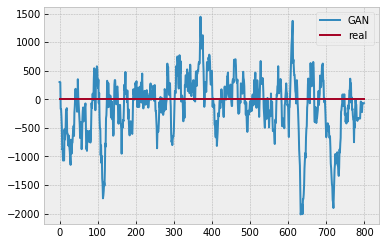

Batch_no: 20500  Epoch: 315


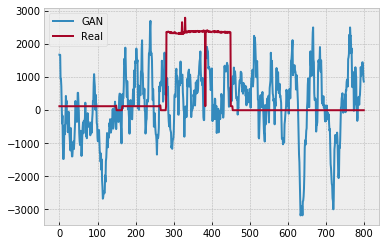

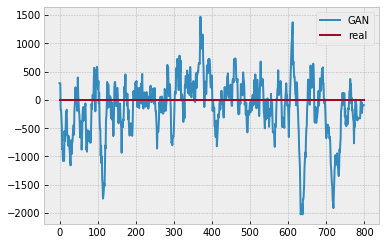

Batch_no: 21000  Epoch: 323


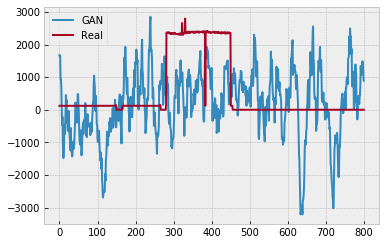

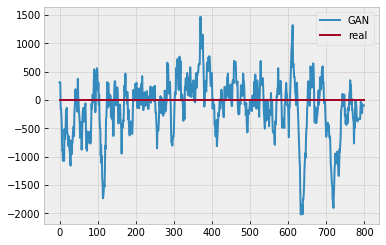

Batch_no: 21500  Epoch: 330


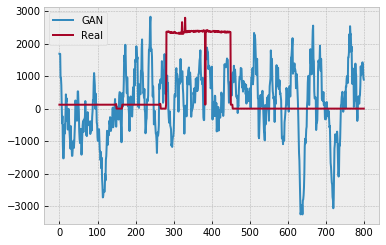

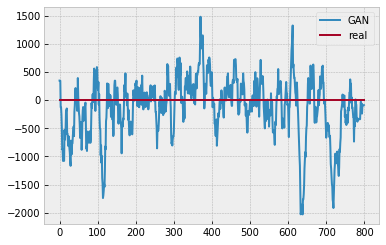

Batch_no: 22000  Epoch: 338


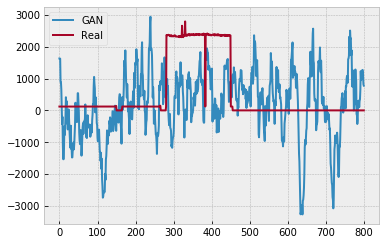

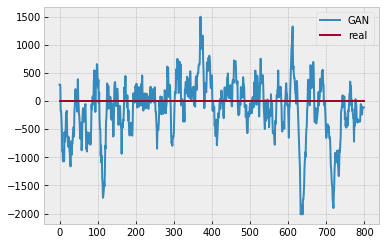

Batch_no: 22500  Epoch: 346


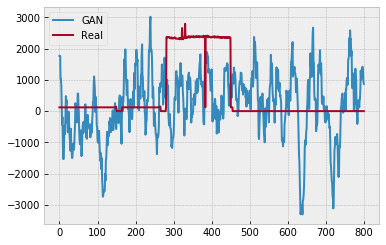

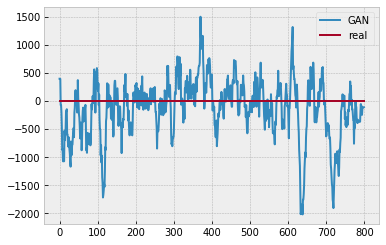

Batch_no: 23000  Epoch: 353


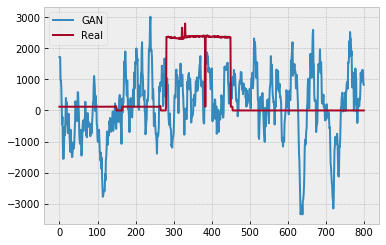

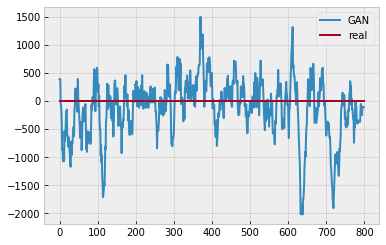

Batch_no: 23500  Epoch: 361


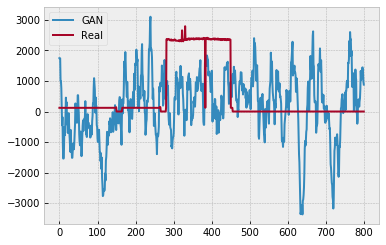

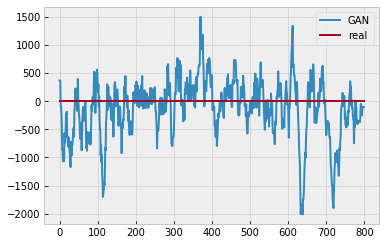

Batch_no: 24000  Epoch: 369


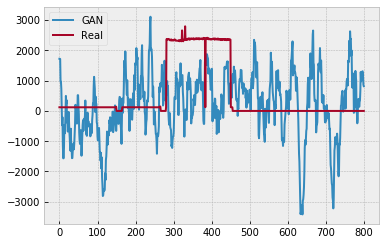

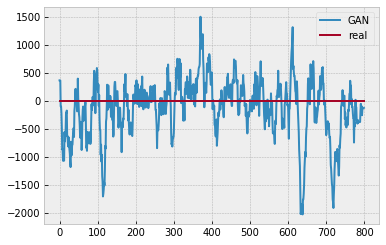

Batch_no: 24500  Epoch: 376


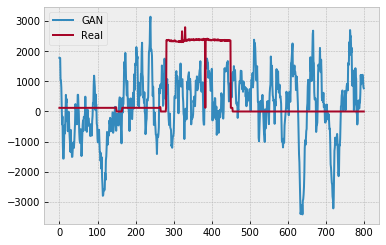

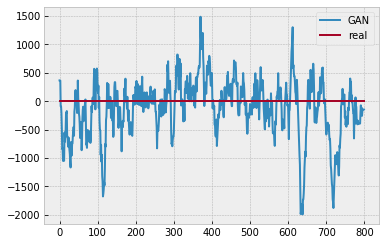

Batch_no: 25000  Epoch: 384


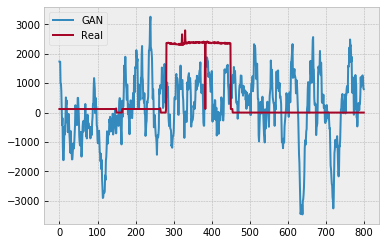

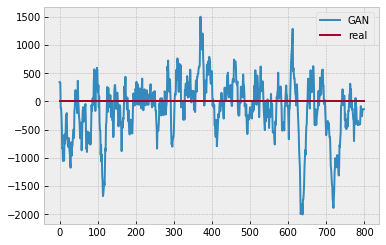

Batch_no: 25500  Epoch: 392


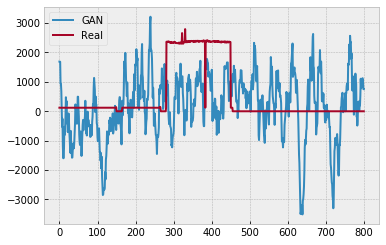

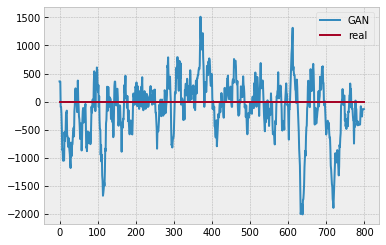

Batch_no: 26000  Epoch: 400


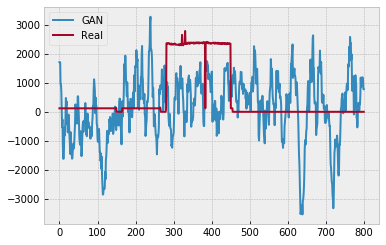

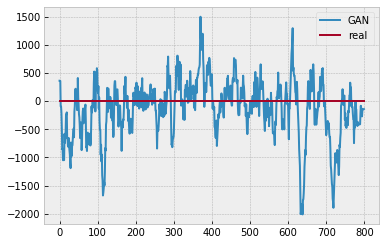

Batch_no: 26500  Epoch: 407


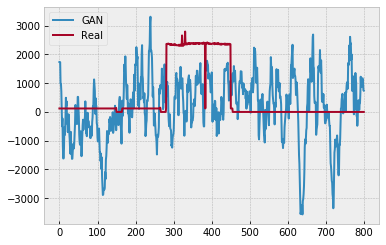

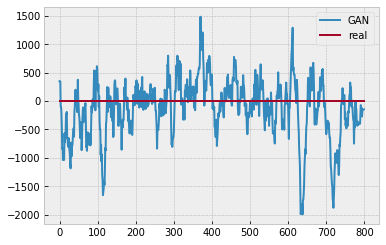

Batch_no: 27000  Epoch: 415


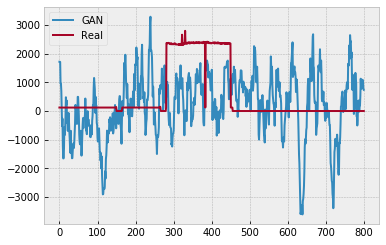

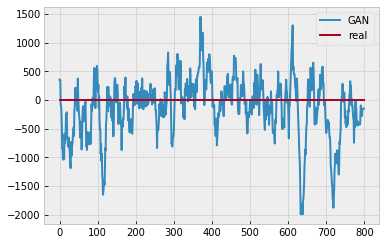

Batch_no: 27500  Epoch: 423


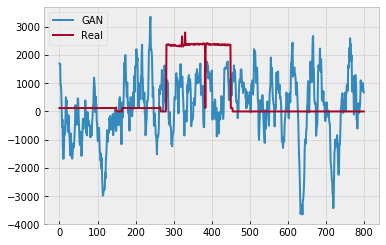

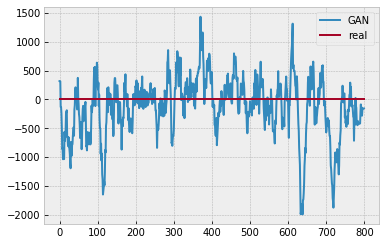

Batch_no: 28000  Epoch: 430


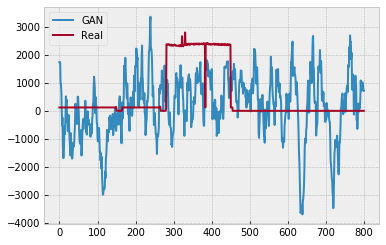

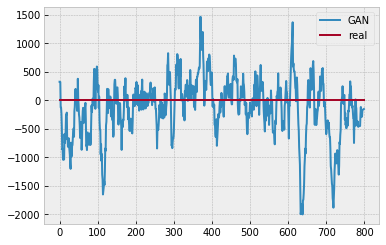

Batch_no: 28500  Epoch: 438


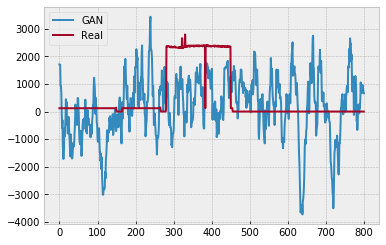

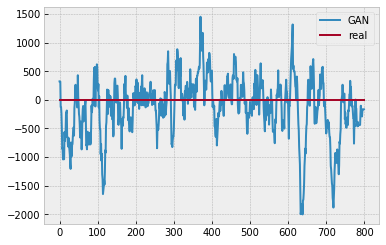

Batch_no: 29000  Epoch: 446


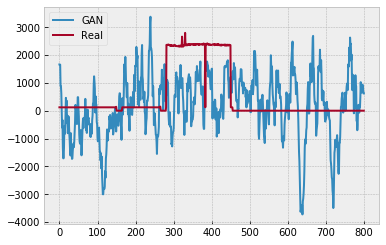

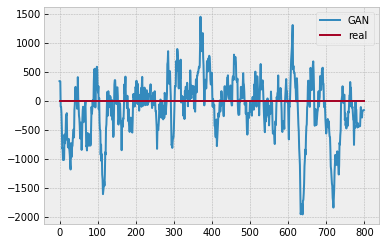

Batch_no: 29500  Epoch: 453


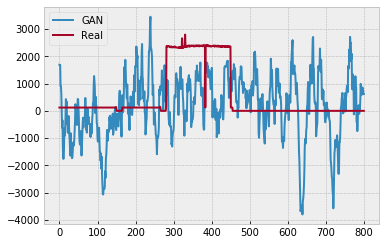

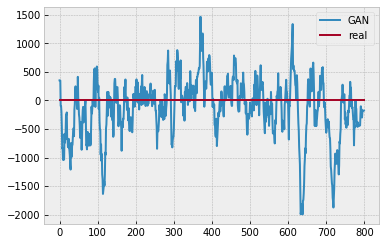

Batch_no: 30000  Epoch: 461


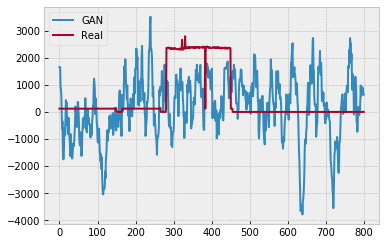

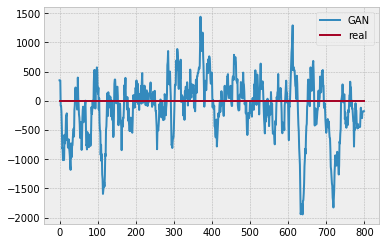

Batch_no: 30500  Epoch: 469


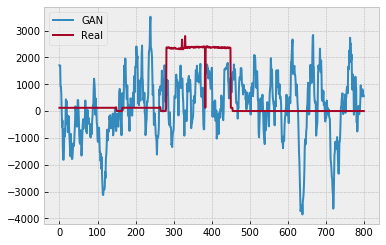

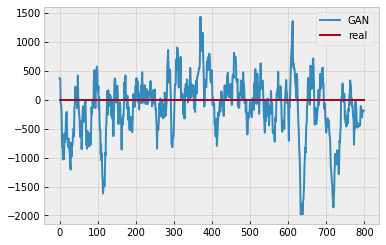

Batch_no: 31000  Epoch: 476


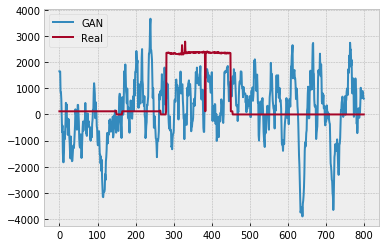

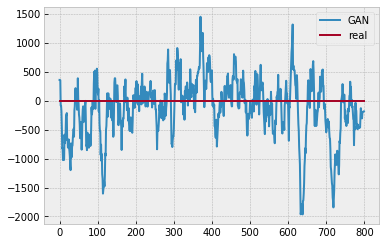

Batch_no: 31500  Epoch: 484


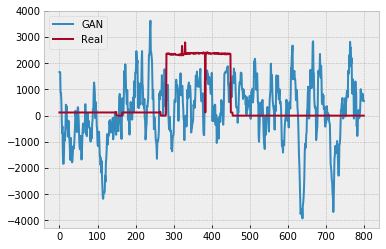

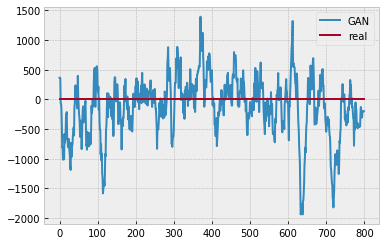

Batch_no: 32000  Epoch: 492


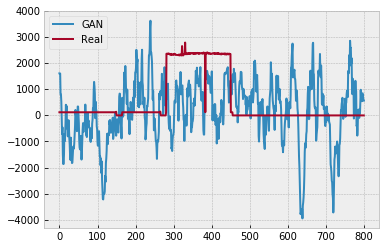

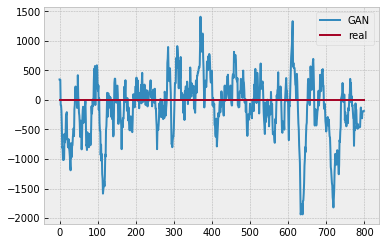

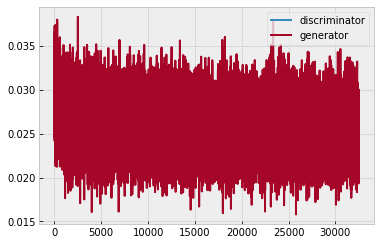

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['g3', 'g4', 'g5', 'g6', 'g7']
Smoothed..
recall= 0.954094, precision= 0.032063, F1= 0.062041, accuracy= 0.157902
RE=0.961861, MAE= 573.346793
g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are initialized
g5 weights are initialized
g6 weights are initialized
g7 weights are initialized
d1 weights are kept
d2 weights are kept
d3 weights are kept
d4 weights are kept
d5 weights are kept


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:69: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


Batch_no: 0  Epoch: 0


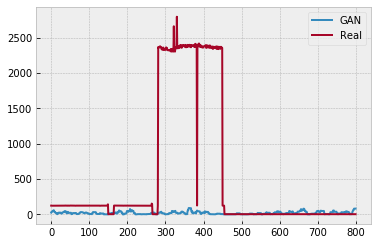

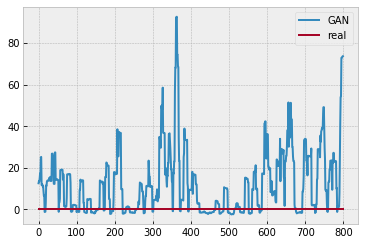

Batch_no: 500  Epoch: 7


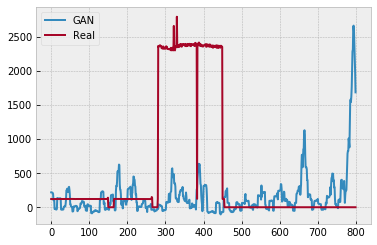

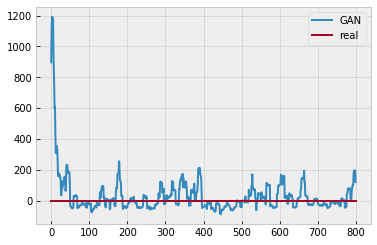

Batch_no: 1000  Epoch: 15


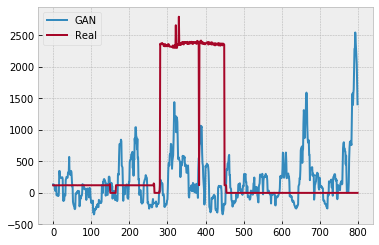

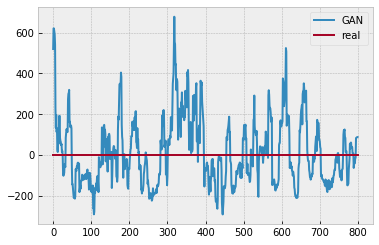

Batch_no: 1500  Epoch: 23


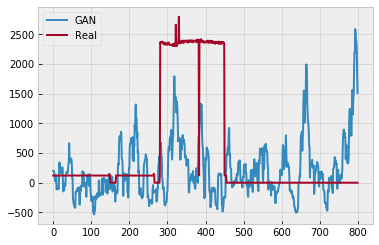

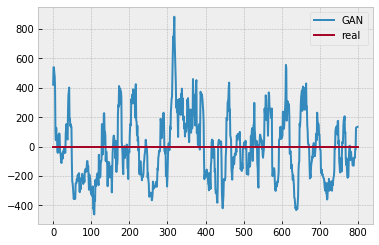

Batch_no: 2000  Epoch: 30


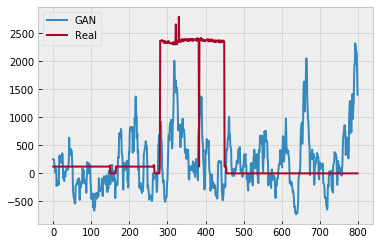

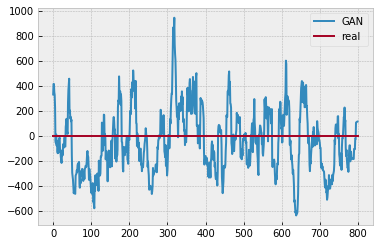

Batch_no: 2500  Epoch: 38


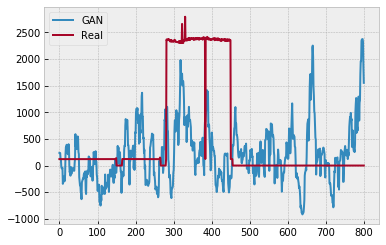

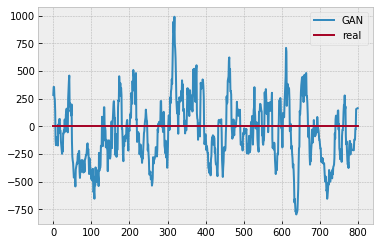

Batch_no: 3000  Epoch: 46


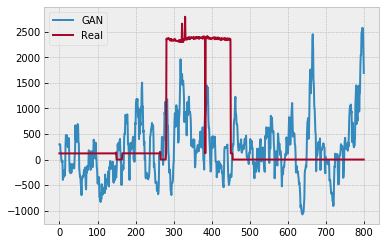

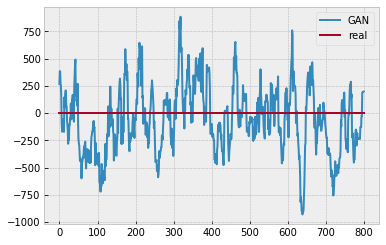

Batch_no: 3500  Epoch: 53


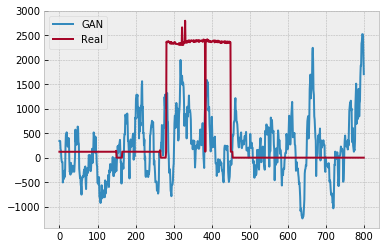

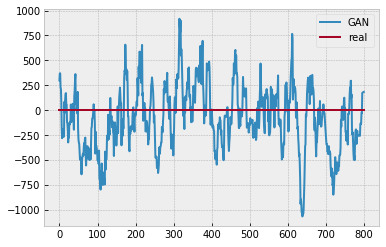

Batch_no: 4000  Epoch: 61


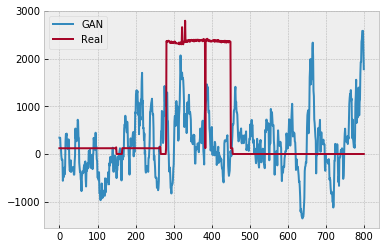

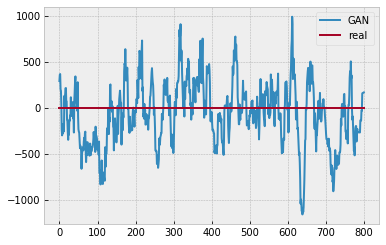

Batch_no: 4500  Epoch: 69


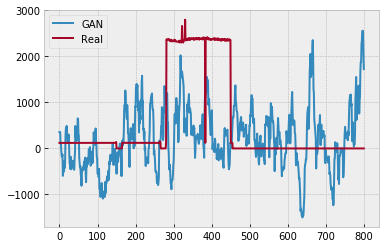

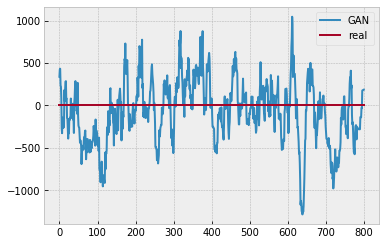

Batch_no: 5000  Epoch: 76


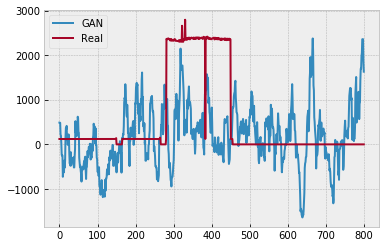

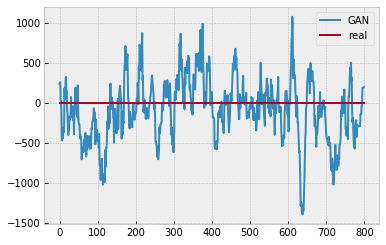

Batch_no: 5500  Epoch: 84


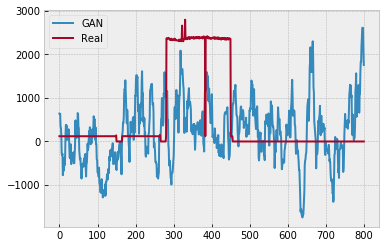

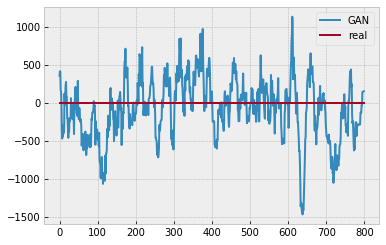

Batch_no: 6000  Epoch: 92


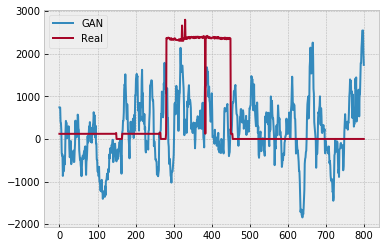

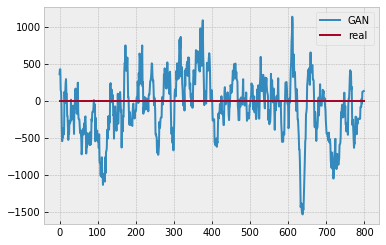

Batch_no: 6500  Epoch: 100


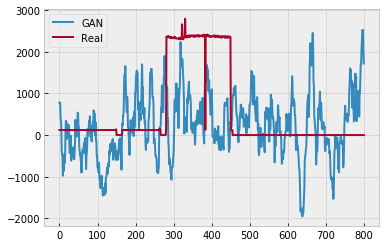

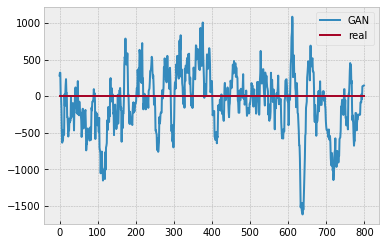

Batch_no: 7000  Epoch: 107


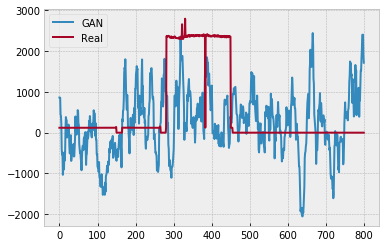

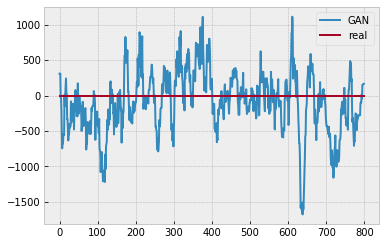

Batch_no: 7500  Epoch: 115


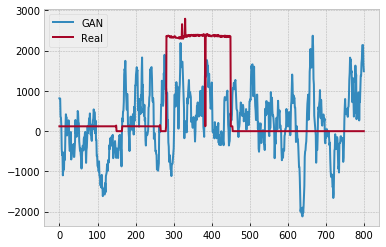

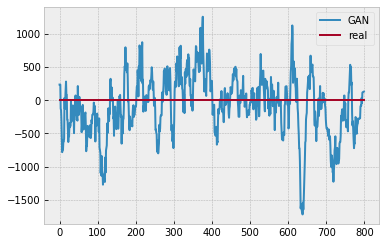

Batch_no: 8000  Epoch: 123


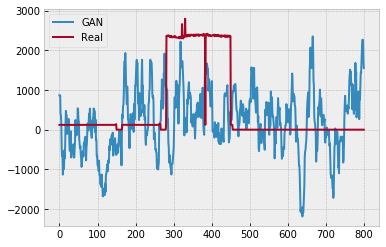

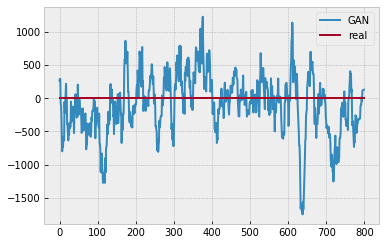

Batch_no: 8500  Epoch: 130


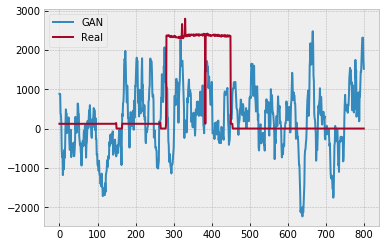

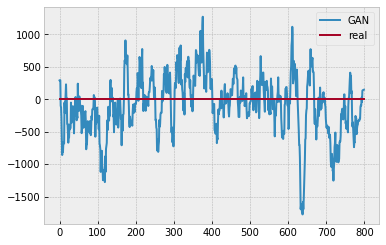

Batch_no: 9000  Epoch: 138


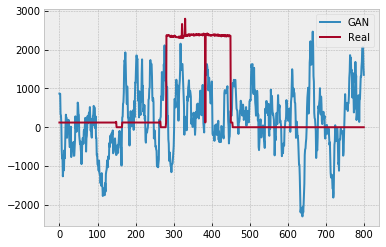

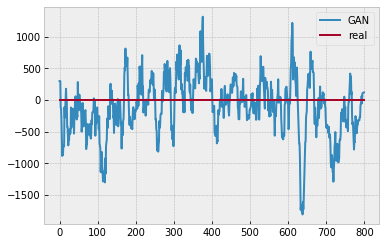

Batch_no: 9500  Epoch: 146


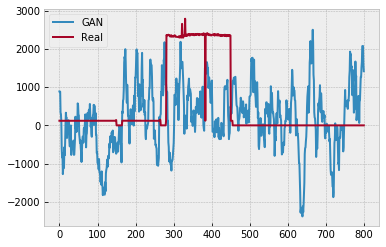

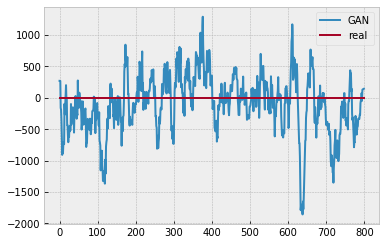

Batch_no: 10000  Epoch: 153


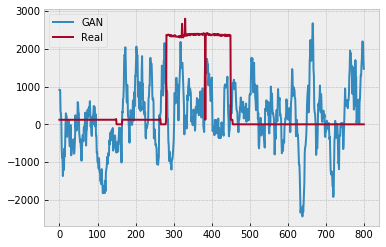

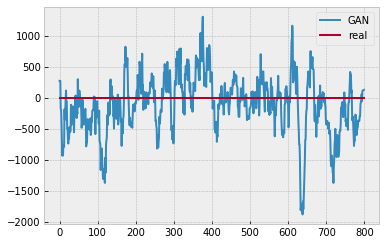

Batch_no: 10500  Epoch: 161


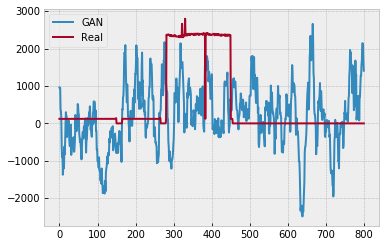

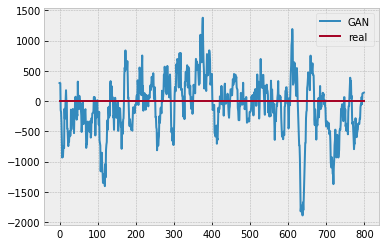

Batch_no: 11000  Epoch: 169


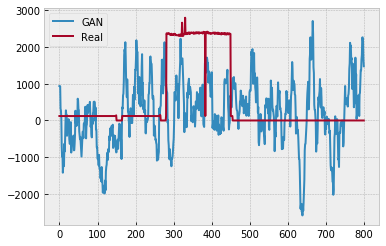

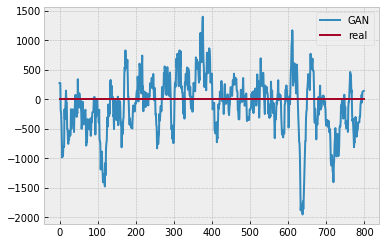

Batch_no: 11500  Epoch: 176


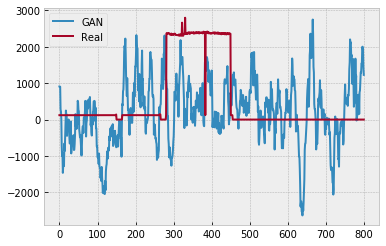

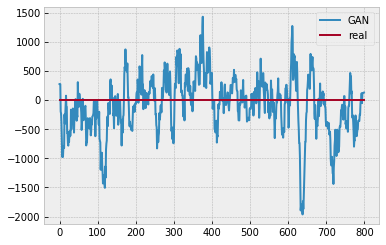

Batch_no: 12000  Epoch: 184


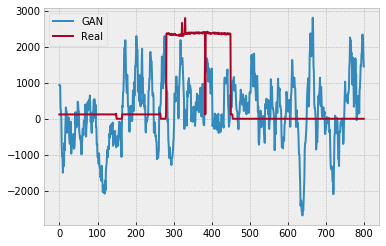

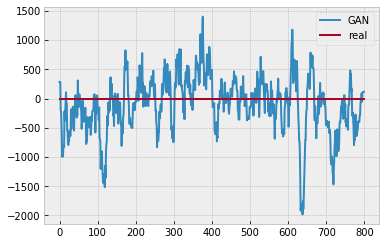

Batch_no: 12500  Epoch: 192


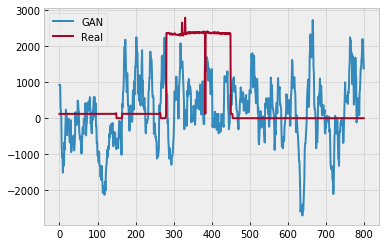

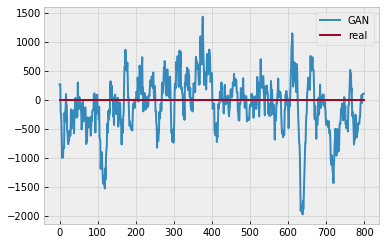

Batch_no: 13000  Epoch: 200


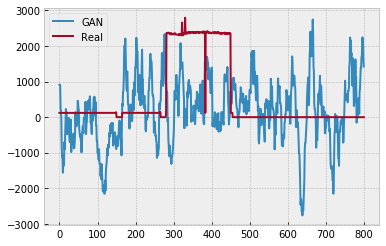

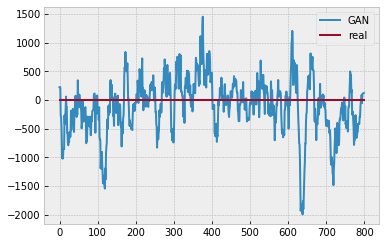

Batch_no: 13500  Epoch: 207


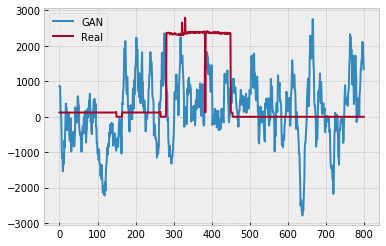

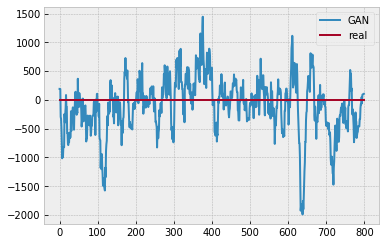

Batch_no: 14000  Epoch: 215


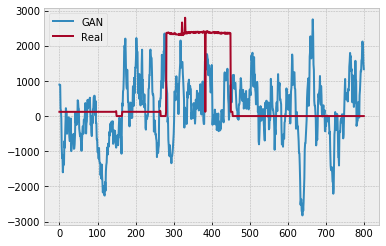

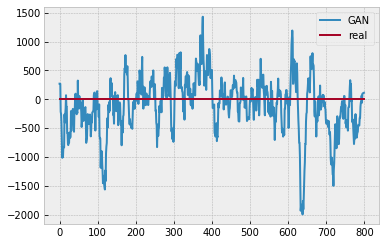

Batch_no: 14500  Epoch: 223


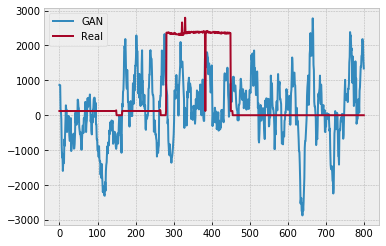

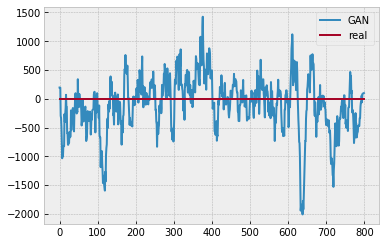

Batch_no: 15000  Epoch: 230


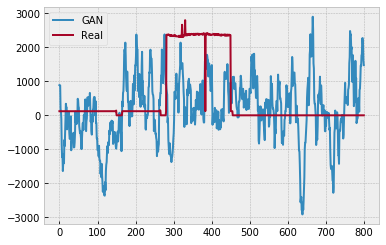

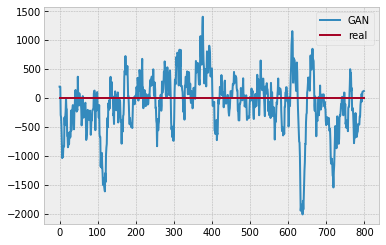

Batch_no: 15500  Epoch: 238


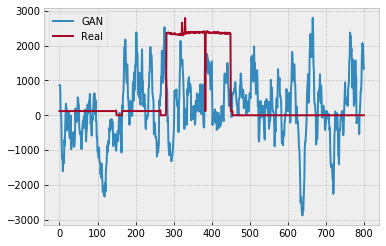

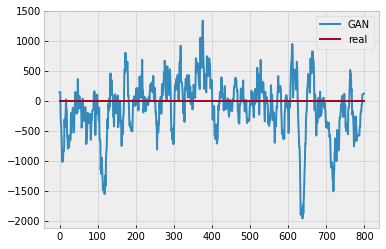

Batch_no: 16000  Epoch: 246


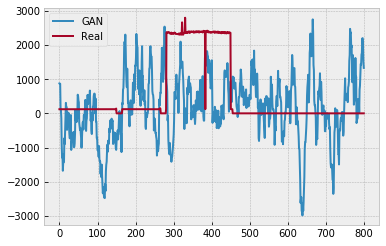

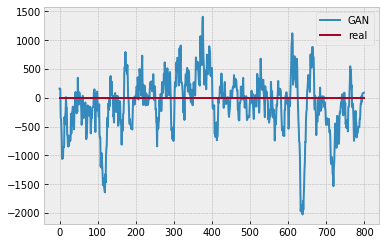

Batch_no: 16500  Epoch: 253


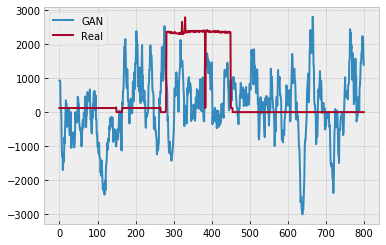

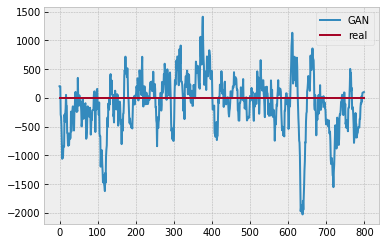

Batch_no: 17000  Epoch: 261


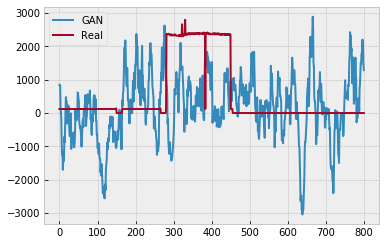

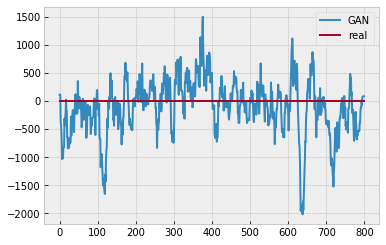

Batch_no: 17500  Epoch: 269


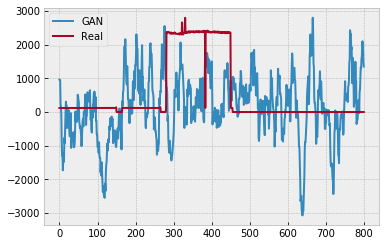

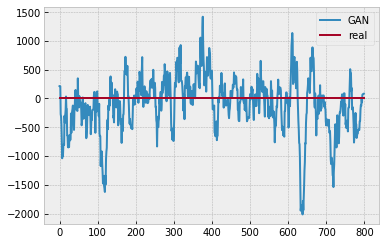

Batch_no: 18000  Epoch: 276


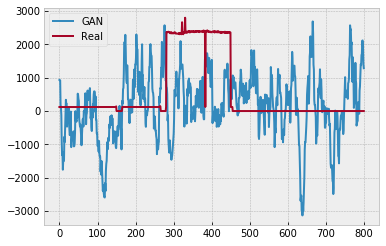

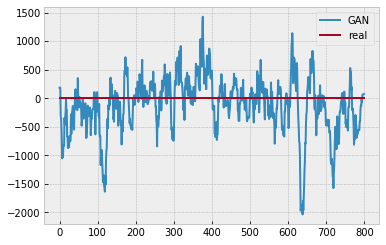

Batch_no: 18500  Epoch: 284


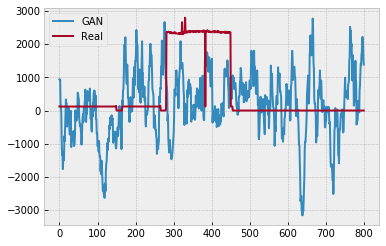

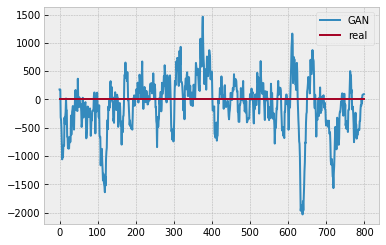

Batch_no: 19000  Epoch: 292


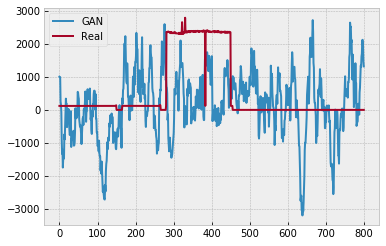

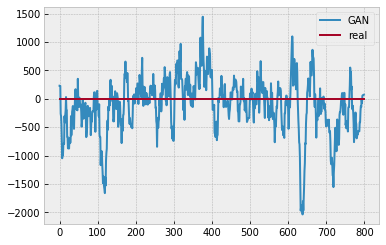

Batch_no: 19500  Epoch: 300


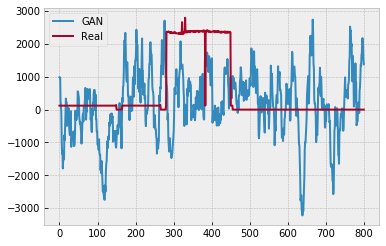

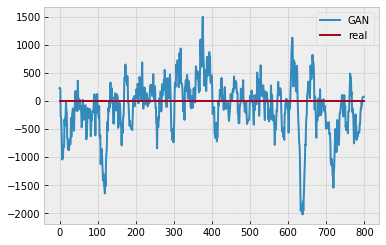

Batch_no: 20000  Epoch: 307


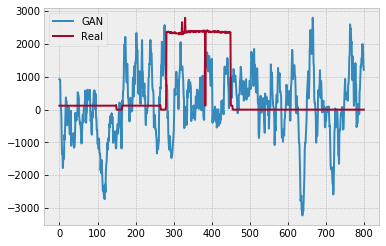

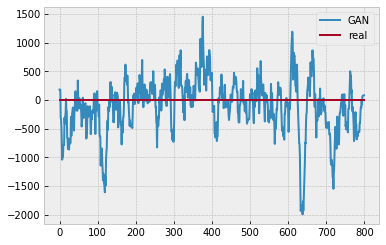

Batch_no: 20500  Epoch: 315


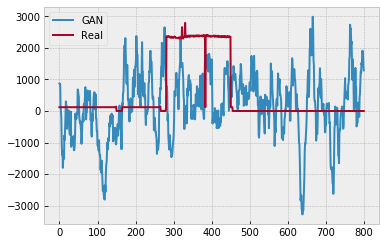

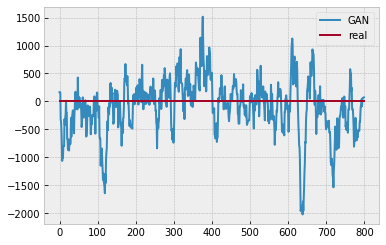

Batch_no: 21000  Epoch: 323


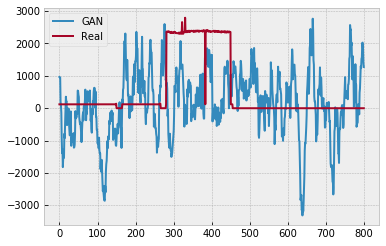

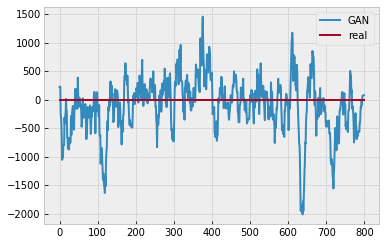

Batch_no: 21500  Epoch: 330


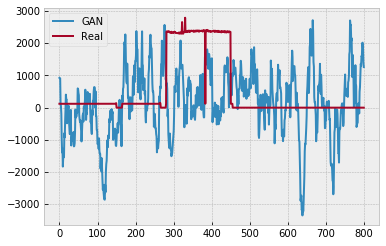

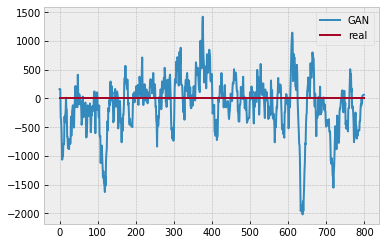

Batch_no: 22000  Epoch: 338


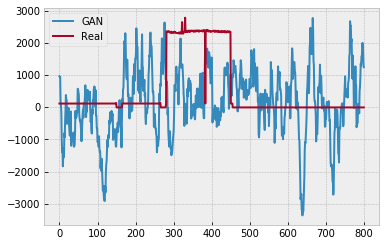

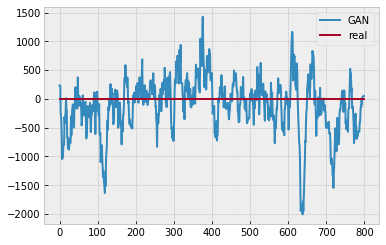

Batch_no: 22500  Epoch: 346


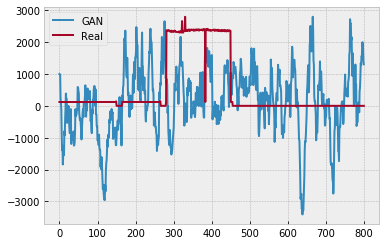

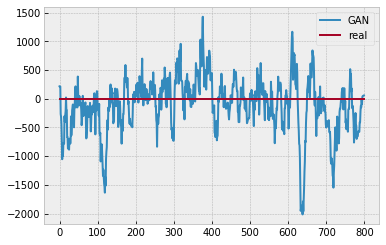

Batch_no: 23000  Epoch: 353


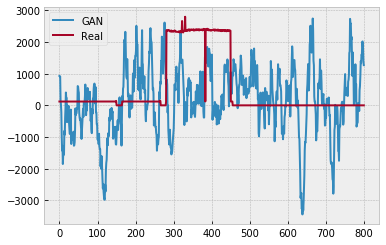

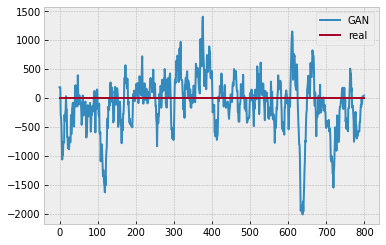

Batch_no: 23500  Epoch: 361


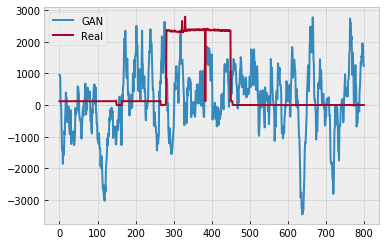

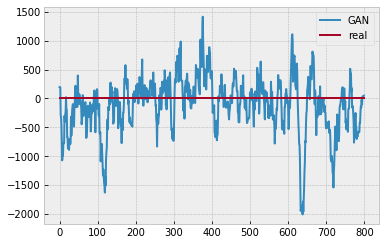

Batch_no: 24000  Epoch: 369


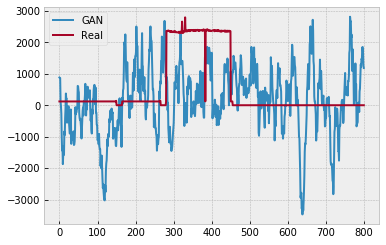

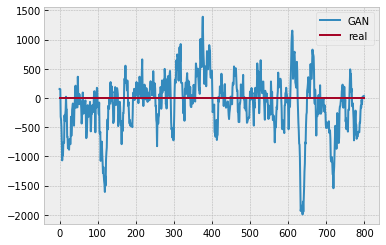

Batch_no: 24500  Epoch: 376


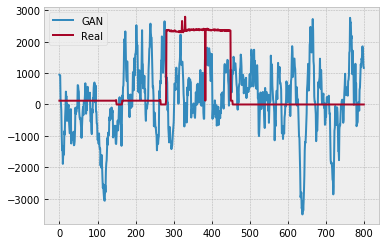

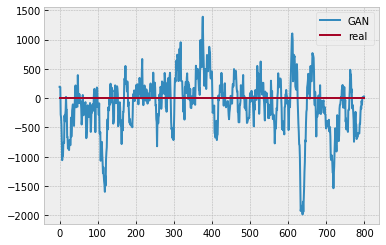

Batch_no: 25000  Epoch: 384


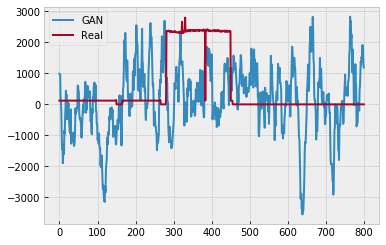

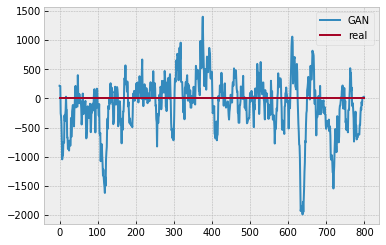

Batch_no: 25500  Epoch: 392


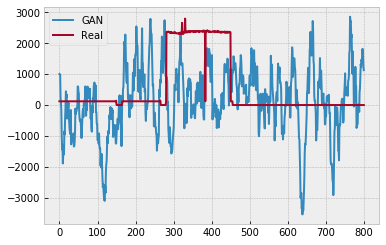

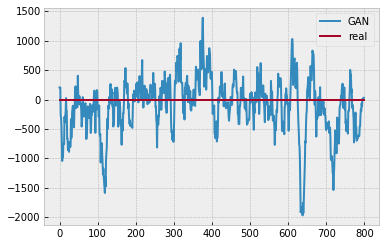

Batch_no: 26000  Epoch: 400


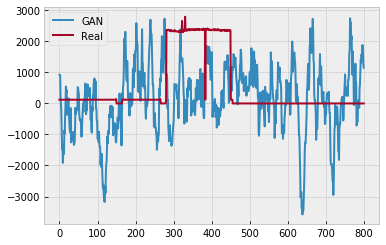

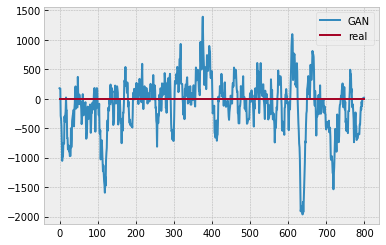

Batch_no: 26500  Epoch: 407


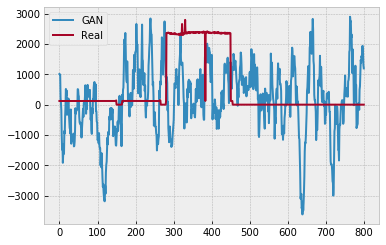

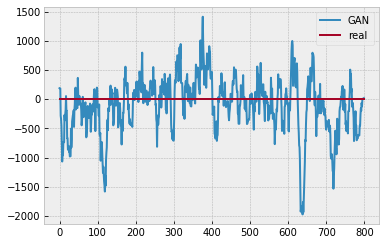

Batch_no: 27000  Epoch: 415


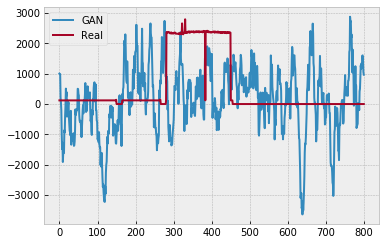

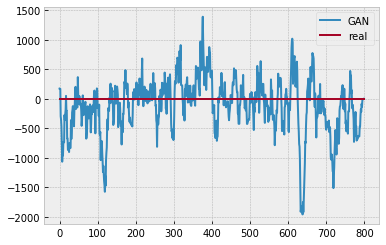

Batch_no: 27500  Epoch: 423


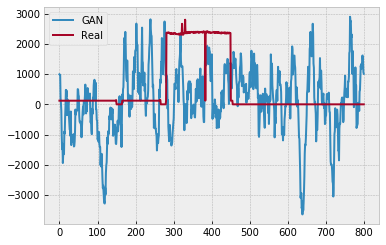

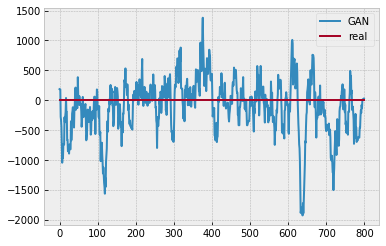

Batch_no: 28000  Epoch: 430


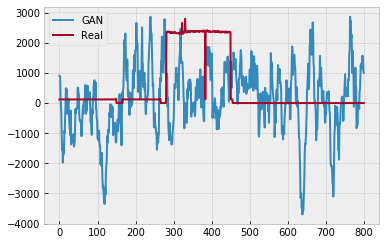

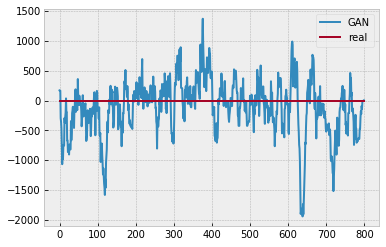

Batch_no: 28500  Epoch: 438


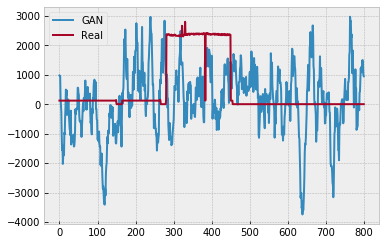

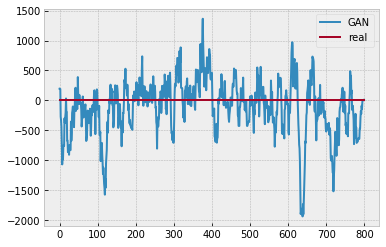

Batch_no: 29000  Epoch: 446


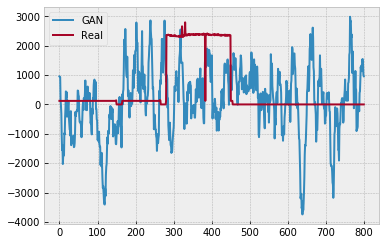

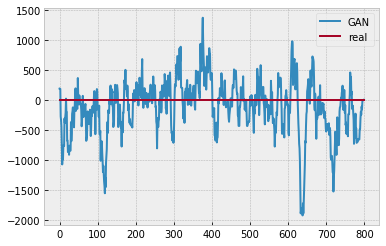

Batch_no: 29500  Epoch: 453


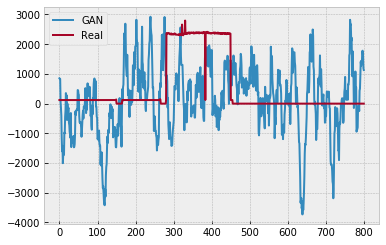

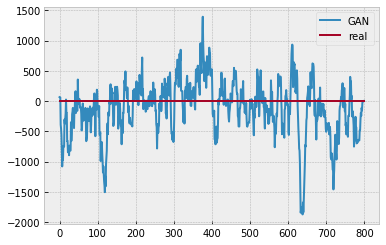

Batch_no: 30000  Epoch: 461


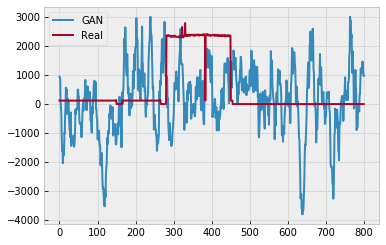

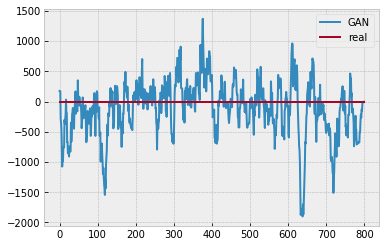

Batch_no: 30500  Epoch: 469


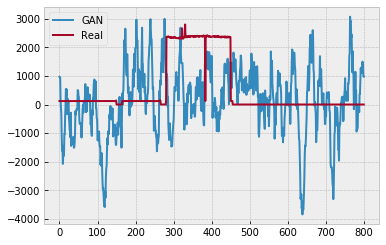

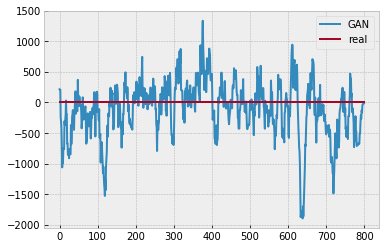

Batch_no: 31000  Epoch: 476


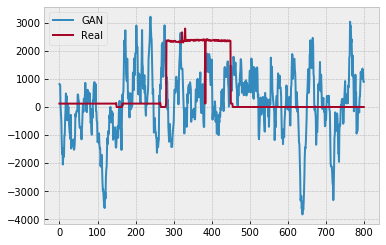

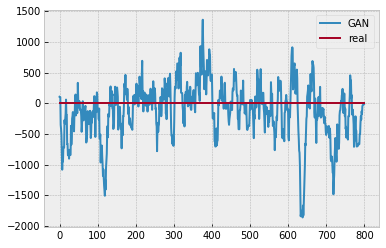

Batch_no: 31500  Epoch: 484


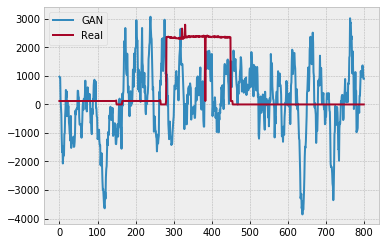

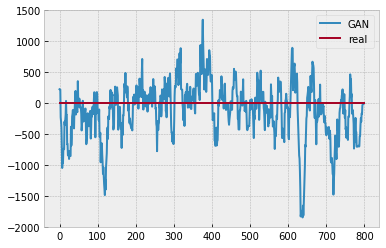

Batch_no: 32000  Epoch: 492


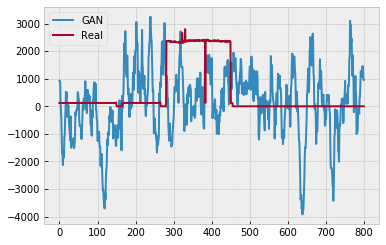

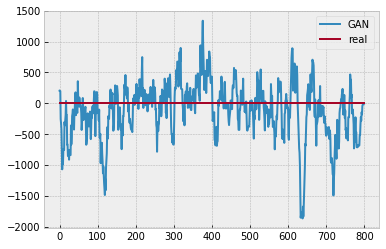

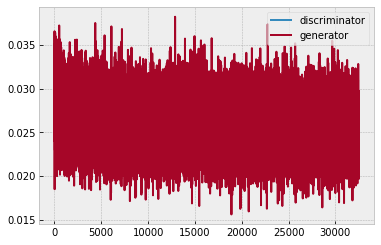

segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
['g4', 'g5', 'g6', 'g7']
Smoothed..
recall= 0.982186, precision= 0.032054, F1= 0.062081, accuracy= 0.133701
RE=0.964078, MAE= 607.131635
g1 weights are kept
g2 weights are kept
g3 weights are kept
g4 weights are kept
g5 weights are initialized
g6 weights are initialized
g7 weights are initialized
d1 weights are kept
d2 weights are kept
d3 weights are kept
d4 weights are kept
d5 weights are kept


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:69: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


Batch_no: 0  Epoch: 0


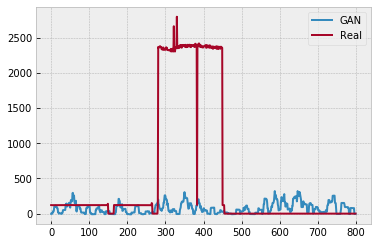

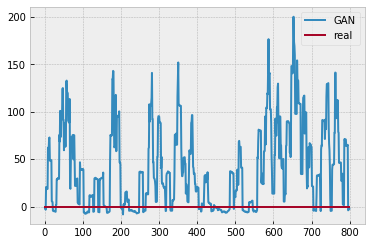

Batch_no: 500  Epoch: 7


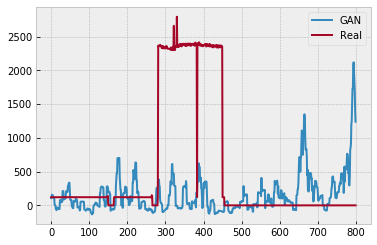

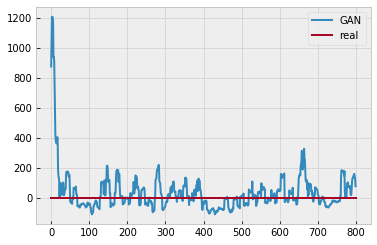

Batch_no: 1000  Epoch: 15


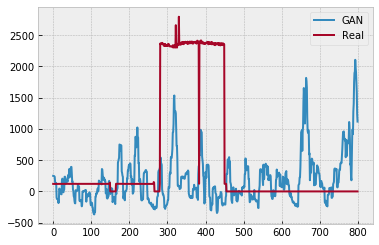

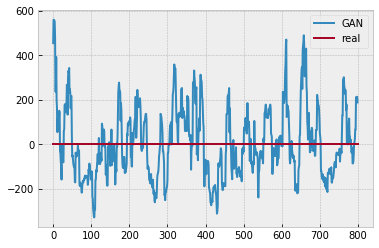

Batch_no: 1500  Epoch: 23


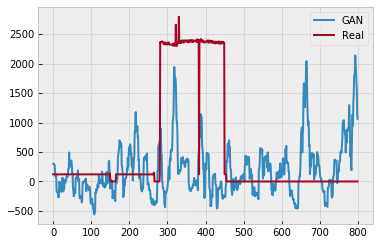

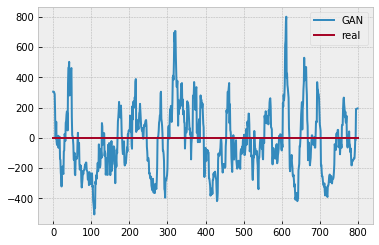

Batch_no: 2000  Epoch: 30


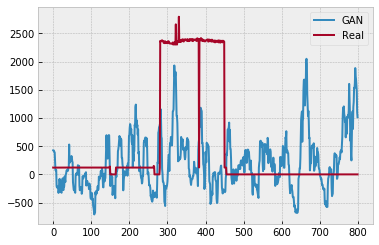

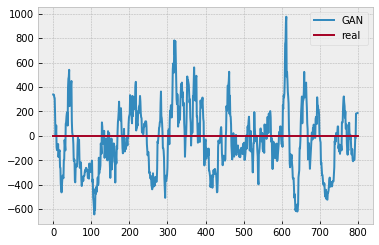

Batch_no: 2500  Epoch: 38


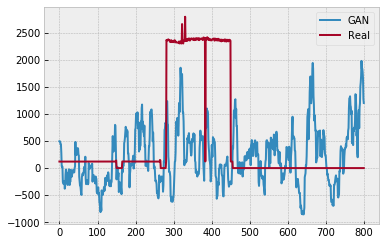

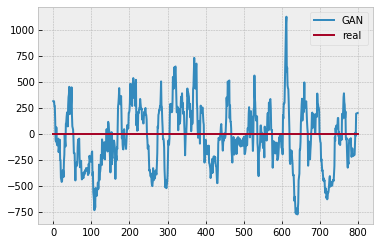

Batch_no: 3000  Epoch: 46


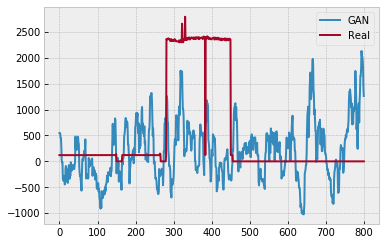

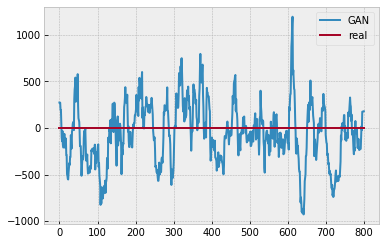

In [ ]:
performance3={}

X_to_disaggregate=np.load("data/UKDALE_house1_X_raw_test_DW.npy")
Y_true=np.load("data/UKDALE_house1_Y_raw_test_DW.npy")

d_train_group=[["dxx"]] #["d1","d2","d3","d4","d5"]




# d_train_group=[["d2","d3","d4","d5"],
#                ["d3","d4","d5"],
#                ["d4","d5"],
#                ["d5"]]
                



g_train_group=[#["g2","g3","g4","g5","g6","g7"],
               ["g3","g4","g5","g6","g7"],
               ["g4","g5","g6","g7"],
               ["g5","g6","g7"],
               ["g6","g7"],
               ["g7"]]


# d_train_group=[["d2","d3","d4","d5"]]






#generator configuring
for ii, d_retrain in enumerate(d_train_group):
    for i, g_retrain in enumerate(g_train_group):
        generator.load_state_dict(checkpoint['g_state_dict'],strict=True)
        discriminator.load_state_dict(checkpoint['d_state_dict'],strict=True)
        
#         for name, child in generator.named_children():
#             if name in g_retrain:
#                 print(name + ' is unfrozen in generator')
#                 for param in child.parameters():
#                     param.requires_grad = True
#             else:
#                 print(name + ' is frozen in generator')
#                 for param in child.parameters():
#                     param.requires_grad = False


#         #discriminator configuring
#         for name, child in discriminator.named_children():
#             if name in d_retrain:
#                 print(name + ' is unfrozen in discriminator ')
#                 for param in child.parameters():
#                     param.requires_grad = True
#             else:
#                 print(name + ' is frozen in discriminator')
#                 for param in child.parameters():
#                     param.requires_grad = False

                    
                    
                    

        for name, child in generator.named_children():
            if name in g_retrain:
                print(name + ' weights are initialized')
                torch.nn.init.xavier_uniform(child[0].weight.data)
            else:
                print(name + ' weights are kept')

        for name, child in discriminator.named_children():
            if name in d_retrain:
                print(name + ' weights are initialized')
                torch.nn.init.xavier_uniform(child[0].weight.data)
            else:
                print(name + ' weights are kept')

       
    
    # Optimizers
        optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
        optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1, b2))
        # optimizer_G.state_dict()["param_groups"][0]["params"]


        #loading optimizers states
        optimizer_G.load_state_dict(checkpoint["g_opt_dict"])
        optimizer_D.load_state_dict(checkpoint["d_opt_dict"])




        g_losses=[]
        d_losses=[]

        for epoch in range(n_epochs):
            g_running_loss=0.0
            d_running_loss=0.0
            for i, (aggregate, appliance) in enumerate(dataloader):

                #reshaping to fit the convolution layer
                aggregate_reshaped=aggregate.reshape(aggregate.shape[0],1,aggregate.shape[1])

                batch_size = appliance.shape[0]
                app=appliance[:,:]

                # Adversarial ground truths
                valid = Variable(FloatTensor(batch_size, 1).fill_(1.0), requires_grad=False)
                fake = Variable(FloatTensor(batch_size, 1).fill_(0.0), requires_grad=False)

                # Configure input
                real_aggregate_reshaped = Variable(aggregate_reshaped.type(FloatTensor))
                real_appliance = Variable(app.type(FloatTensor))
                real_aggregate= Variable(aggregate.type(FloatTensor))

                real_app_real_agg=torch.cat((real_appliance,real_aggregate),1)


                # -----------------
                #  Train Generator
                # -----------------
                optimizer_G.zero_grad()


                gen_appliance = generator(real_aggregate_reshaped)

        # #subtracting the first output
        #         if epoch==0 and i==0:
        #             first_gen1=gen_appliance[0,:].detach()


        #         first_gen=first_gen1.repeat(len(appliance),1)
        #         gen_appliance=gen_appliance-first_gen



                gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)

                validity,feat= discriminator(gen_app_real_agg)

                g_loss=feature_loss(feat, real_app_real_agg)
        #         g_loss = adversarial_loss(validity, valid)

                g_loss.backward()
                optimizer_G.step()
                g_loss_1=g_loss.item()


#                 g_losses.append(g_loss.item())

########################################################################################################################
        # # Generator second training round


                optimizer_G.zero_grad()

                gen_appliance = generator(real_aggregate_reshaped)



        #         gen_appliance=gen_appliance-first_gen #subtract




                gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)
                validity,feat = discriminator(gen_app_real_agg)
                g_loss = feature_loss(feat, real_app_real_agg)

        #         g_loss = adversarial_loss(validity, valid)


                g_loss.backward()
                g_loss_2=g_loss.item()

                optimizer_G.step()


                # g_running_loss+=g_loss.item()
                #g_epoch_loss=g_running_loss/len(dataloader)        
                #g_losses.append(g_epoch_loss)

        # Generator third training round

                optimizer_G.zero_grad()

                gen_appliance = generator(real_aggregate_reshaped)


        #         gen_appliance=gen_appliance-first_gen #subtract

                gen_app_real_agg=torch.cat((gen_appliance,real_aggregate),1)

                validity,feat = discriminator(gen_app_real_agg)


                g_loss = feature_loss(feat, real_app_real_agg)
        #         g_loss = adversarial_loss(validity, valid)

                g_loss.backward()
                optimizer_G.step()

                g_loss_3=g_loss.item()

                g_losses.append((g_loss_1+g_loss_2+g_loss_3)/3)


        # ----------
        #  Training
        # ----------


#                 # ---------------------
#                 #  Train Discriminator
#                 # ---------------------


#                 optimizer_D.zero_grad()


#                 real_app_real_agg=torch.cat((appliance,aggregate),1)

#                 real_app_real_agg=Variable(real_app_real_agg.type(FloatTensor))

#                 validity_real,_ = discriminator(real_app_real_agg)
#                 d_real_loss = adversarial_loss(validity_real, valid)

#                 validity_fake,_ = discriminator(gen_app_real_agg.detach()) #detach
#                 d_fake_loss = adversarial_loss(validity_fake, fake)

#                 d_loss = (d_real_loss + d_fake_loss) / 2


#                 d_loss.backward()
#                 optimizer_D.step()


#                 d_losses.append(d_loss.item())

                ## end trining discrimnator

                batches_done = epoch * len(dataloader) + i
                #print("Epoch:",epoch,"Batch:",i,"of:",len(dataloader),"batches done:",batches_done)
                if batches_done % sample_interval == 0:
                    print("Batch_no:",batches_done," Epoch:",epoch)
                    sample_data(n_row=1, batches_done=batches_done)
        plt.plot(d_losses,label="discriminator")
        plt.plot(g_losses,label="generator")
        plt.legend()
        plt.show()


        #disaggregate
        # house 1



        # end house 1

        # #house 5
        # X_to_disaggregate=np.load("X_raw_house_5.npy") 
        # Y_true=np.load("Y_raw_house_5.npy")
        # X_to_disaggregate=X_to_disaggregate[::s][0:140000]
        # Y_true=Y_true[::s][0:140000]
        # # print(X_s.shape[0])
        # plt.plot(Y_true)
        # #end house 5



        agg_len=X_to_disaggregate.shape[0]
        w=sig_len
        step=int(50) #64 #32

        agg_segments=np.zeros((1,w))
        app_segments=np.zeros((1,w))



        i=0
        while i<=agg_len-w:
            agg_segment=X_to_disaggregate[i:i+w].reshape(1,-1)
            app_segment=Y_true[i:i+w].reshape(1,-1)
            agg_segments=np.concatenate((agg_segments,agg_segment),axis=0)
            app_segments=np.concatenate((app_segments,app_segment),axis=0)
            i+=step

        agg_segments=agg_segments[1:,:]    
        app_segments=app_segments[1:,:]    



        agg_segments_scaled=scale_agg.transform(agg_segments)
        agg_segments_scaled_reshaped=agg_segments_scaled.reshape(agg_segments_scaled.shape[0],1,agg_segments_scaled.shape[1])
        app_segments_scaled=scale_app.transform(app_segments)


        samples_from=0
        samples_to=int(len(agg_segments_scaled_reshaped))

        sub_agg_segments=agg_segments_scaled_reshaped[samples_from:samples_to,:]
        sub_app_true=app_segments_scaled[samples_from:samples_to,:]

        #sub_app_true=app_segments[samples_from:samples_to,:]
        gen_out=disaggregate(sub_agg_segments)#tensor generated

        disaggregated_appliance=np.array(gen_out.cpu().detach()) #numpy appliance generated
        disaggregated_appliance_inv=scale_app.inverse_transform(disaggregated_appliance)

        # sub_app_true_inv=scale_app.inverse_transform(sub_app_true) #app segments

        threshold=0
        disaggregated_appliance_inv[disaggregated_appliance_inv<=threshold] = 0
        sub_agg_segments[sub_agg_segments<=threshold] = 0


        disaggregation_confidence=confidence(appliance=gen_out,aggregate=sub_agg_segments[:,0,:])
        disaggregation_confidence.shape


        indecis_matrix=np.zeros(sub_app_true.shape)
        indecis_matrix.shape

        d=np.array(disaggregation_confidence.cpu().detach())
        confidence_repeated=np.repeat(d,disaggregated_appliance.shape[1],axis=1)


        k=0
        for i in range(len(indecis_matrix)):
            indecis_matrix[i,:]=np.arange(k,k+w,dtype = 'int')
            k+=step
        indecis_matrix=indecis_matrix.reshape(1,-1).astype("int")
        disaggregated_appliance_flat=disaggregated_appliance_inv.reshape(1,-1)
        real_appliance_flat=app_segments.reshape(1,-1)
        confidence_repeated_flat=confidence_repeated.reshape(1,-1)


        print("segmenting predictions...")

        pred_dict={}
        confidence_dict={}
        real_dict={}

        for j in range(np.max(indecis_matrix)):
            if j % 5000 == 0:
                print(j," of ", np.max(indecis_matrix))
            a=np.where(indecis_matrix==j)[1]
            pred_dict[j]=disaggregated_appliance_flat[0,a]
            confidence_dict[j]=confidence_repeated_flat[0,a]
            real_dict[j]=real_appliance_flat[0,a]




        from scipy import stats
        threshold=0

        pred_clustered=[] 
        true_app_list=[]
        for key in pred_dict.keys():
            p=pred_dict[key]
            conf=confidence_dict[key]
        #     p[p<=threshold]=0  # thresholding
        #     pred_clustered.append(p.mean())

            pred_clustered.append(p[np.argmax(conf)])
        #     pred_clustered.append(np.percentile(pred_dict[key],80))
            tr=real_dict[key]
        #     tr[tr<=threshold]=0

            true_app_list.append(tr[0])



        shift=0    
        pred_clustered_shifted=np.zeros(len(pred_clustered))
        pred_clustered_shifted[shift:len(pred_clustered)]=pred_clustered[0:len(pred_clustered)-shift]
        # pred_clustered_shifted=pred_clustered_shifted-np.ones(pred_clustered_shifted.shape)*500
        # pred_clustered_shifted[pred_clustered_shifted <=0] = 0


        predictions=np.asarray(pred_clustered_shifted)[0:int(len(pred_clustered_shifted))]
        appliance_true=np.asarray(Y_true[0:int(len(pred_clustered_shifted))])


        predictions_smoothed=smooth(predictions,box_pts=10)
        appliance_true_smoothed=smooth(appliance_true,box_pts=10)

        print("+++++++++++++++++++")
        print(str(g_retrain))
        print("Smoothed..")
        recall2,precision2,F12,accuracy2=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
        print("recall= %f, precision= %f, F1= %f, accuracy= %f" %(recall2,precision2,F12,accuracy2))

        RE2,MAE2=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
        print("RE=%f, MAE= %f"%(RE2,MAE2))

        performance3[str(g_retrain)]=[F12,MAE2,RE2]

        print("=============================================================")


        with open('perf_On_REDD3.txt', 'a') as f:
            f.write(str(g_retrain))
            f.write(str(d_retrain))
            f.write("   F1:")
            f.write(str([F12]))
            f.write("\n\n")
        f.close()


## Fix Both Discriminator and Generator

In [11]:
performance4={}

X_to_disaggregate=np.load("data/UKDALE_house1_X_raw_test_DW.npy")
Y_true=np.load("data/UKDALE_house1_Y_raw_test_DW.npy")

generator.load_state_dict(checkpoint['g_state_dict'],strict=True)
discriminator.load_state_dict(checkpoint['d_state_dict'],strict=True)

agg_len=X_to_disaggregate.shape[0]
w=sig_len
step=int(50) #64 #32

agg_segments=np.zeros((1,w))
app_segments=np.zeros((1,w))



i=0
while i<=agg_len-w:
    agg_segment=X_to_disaggregate[i:i+w].reshape(1,-1)
    app_segment=Y_true[i:i+w].reshape(1,-1)
    agg_segments=np.concatenate((agg_segments,agg_segment),axis=0)
    app_segments=np.concatenate((app_segments,app_segment),axis=0)
    i+=step

agg_segments=agg_segments[1:,:]    
app_segments=app_segments[1:,:]    



agg_segments_scaled=scale_agg.transform(agg_segments)
agg_segments_scaled_reshaped=agg_segments_scaled.reshape(agg_segments_scaled.shape[0],1,agg_segments_scaled.shape[1])
app_segments_scaled=scale_app.transform(app_segments)


samples_from=0
samples_to=int(len(agg_segments_scaled_reshaped))

sub_agg_segments=agg_segments_scaled_reshaped[samples_from:samples_to,:]
sub_app_true=app_segments_scaled[samples_from:samples_to,:]

#sub_app_true=app_segments[samples_from:samples_to,:]
gen_out=disaggregate(sub_agg_segments)#tensor generated

disaggregated_appliance=np.array(gen_out.cpu().detach()) #numpy appliance generated
disaggregated_appliance_inv=scale_app.inverse_transform(disaggregated_appliance)

# sub_app_true_inv=scale_app.inverse_transform(sub_app_true) #app segments

threshold=0
disaggregated_appliance_inv[disaggregated_appliance_inv<=threshold] = 0
sub_agg_segments[sub_agg_segments<=threshold] = 0


disaggregation_confidence=confidence(appliance=gen_out,aggregate=sub_agg_segments[:,0,:])
disaggregation_confidence.shape


indecis_matrix=np.zeros(sub_app_true.shape)
indecis_matrix.shape

d=np.array(disaggregation_confidence.cpu().detach())
confidence_repeated=np.repeat(d,disaggregated_appliance.shape[1],axis=1)


k=0
for i in range(len(indecis_matrix)):
    indecis_matrix[i,:]=np.arange(k,k+w,dtype = 'int')
    k+=step
indecis_matrix=indecis_matrix.reshape(1,-1).astype("int")
disaggregated_appliance_flat=disaggregated_appliance_inv.reshape(1,-1)
real_appliance_flat=app_segments.reshape(1,-1)
confidence_repeated_flat=confidence_repeated.reshape(1,-1)


print("segmenting predictions...")

pred_dict={}
confidence_dict={}
real_dict={}

for j in range(np.max(indecis_matrix)):
    if j % 5000 == 0:
        print(j," of ", np.max(indecis_matrix))
    a=np.where(indecis_matrix==j)[1]
    pred_dict[j]=disaggregated_appliance_flat[0,a]
    confidence_dict[j]=confidence_repeated_flat[0,a]
    real_dict[j]=real_appliance_flat[0,a]




from scipy import stats
threshold=0

pred_clustered=[] 
true_app_list=[]
for key in pred_dict.keys():
    p=pred_dict[key]
    conf=confidence_dict[key]
#     p[p<=threshold]=0  # thresholding
#     pred_clustered.append(p.mean())

    pred_clustered.append(p[np.argmax(conf)])
#     pred_clustered.append(np.percentile(pred_dict[key],80))
    tr=real_dict[key]
#     tr[tr<=threshold]=0

    true_app_list.append(tr[0])



shift=0    
pred_clustered_shifted=np.zeros(len(pred_clustered))
pred_clustered_shifted[shift:len(pred_clustered)]=pred_clustered[0:len(pred_clustered)-shift]
# pred_clustered_shifted=pred_clustered_shifted-np.ones(pred_clustered_shifted.shape)*500
# pred_clustered_shifted[pred_clustered_shifted <=0] = 0


predictions=np.asarray(pred_clustered_shifted)[0:int(len(pred_clustered_shifted))]
appliance_true=np.asarray(Y_true[0:int(len(pred_clustered_shifted))])


predictions_smoothed=smooth(predictions,box_pts=10)
appliance_true_smoothed=smooth(appliance_true,box_pts=10)

print("+++++++++++++++++++")
# print(str(g_retrain))
print("Smoothed..")
recall2,precision2,F12,accuracy2=classification_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
print("recall= %f, precision= %f, F1= %f, accuracy= %f" %(recall2,precision2,F12,accuracy2))

RE2,MAE2=energy_metrics(predictions_smoothed,appliance_true_smoothed,thresh=50)
print("RE=%f, MAE= %f"%(RE2,MAE2))

#performance4[str(g_retrain)]=[F12,MAE2,RE2]

print("=============================================================")




segmenting predictions...
0  of  99999
5000  of  99999
10000  of  99999
15000  of  99999
20000  of  99999
25000  of  99999
30000  of  99999
35000  of  99999
40000  of  99999
45000  of  99999
50000  of  99999
55000  of  99999
60000  of  99999
65000  of  99999
70000  of  99999
75000  of  99999
80000  of  99999
85000  of  99999
90000  of  99999
95000  of  99999
+++++++++++++++++++
Smoothed..
recall= 0.380952, precision= 0.100334, F1= 0.158834, accuracy= 0.882219
RE=0.818274, MAE= 127.909543


In [ ]:
plt.plot(Y_true[13000:14000])
plt.plot(X_to_disaggregate[13000:14000])

In [ ]:
plt.plot(predictions[13000:14000])
plt.plot(appliance_true[13000:14000])